In [1]:
import dask
import os
import datetime
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import importlib

from letkf_forecasting import analyse_results, letkf_io

In [2]:
importlib.reload(analyse_results)
importlib.reload(letkf_io)

base_folder = '/a2/uaren/travis'

year = 2014

month = 4
day = 15

# month = 4
# day = 29

# month = 4
# day = 26

dates = [datetime.date(2014, month, day)]
# runs = ['persistence', 'opt_flow_with_div', 'opt_flow',
#         'wrf', 'wrf_no_div', 'owp_opt', 'radiosonde', 'wrf_mean']
# runs = ['persistence', 'opt_flow_with_div', 'opt_flow',
#         'wrf', 'wrf_no_div', 'owp_opt', 'radiosonde']
runs = ['persistence', 'opt_flow', 'wrf_no_div', 'owp_opt',
        ['ensemble', 'owp_opt']]
runs = [['ensemble', 'owp_opt']]

In [9]:
mean_win_size

In [34]:
importlib.reload(analyse_results)
horizons = [15, 30, 45, 60]
only_cloudy = False
mean_win_size = None
only_of_times = True
error_stats_full = analyse_results.error_stats_many_days(
    dates, runs, horizons, base_folder,
    only_cloudy=only_cloudy, only_of_times=only_of_times,
    mean_win_size=mean_win_size
)

['ensemble', 'owp_opt']


/home/travis/miniconda3/envs/letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg 

In [35]:
for error_stat in error_stats_full:
    if error_stat['name'][0] is 'ensemble':
        ensemble_flag = True
        run_name = error_stat['name'][1]
    else:
        run_name = error_stat['name']
    results_folder_path = os.path.join(                                          
        base_folder,                                                               
        'results',                                                               
        f'{year:04}',                                                            
        f'{month:02}',                                                           
        f'{day:02}',                                                             
        run_name)
    results_folder_path = letkf_io.find_latest_run(results_folder_path)
    results_folder_path = os.path.join(results_folder_path, 'single_day')
    if not os.path.exists(results_folder_path):
        os.mkdir(results_folder_path)
    print(results_folder_path)
    for stat_name, stat in error_stat.items():
        if stat_name == 'name':
            continue
        if ensemble_flag:
            stat_name = stat_name + '_ens'
        file_path = os.path.join(results_folder_path,
                                 f'{stat_name}.h5')
        stat.to_hdf(file_path, stat_name)
        print(stat_name)

/a2/uaren/travis/results/2014/04/15/owp_opt_000/single_day
rmse_ens
forecast_sd_ens
truth_sd_ens
bias_ens
correlation_ens
stat_times_ens


In [2]:
import datetime

In [3]:
import letkf_forecasting.letkf_io as letkf_io

In [4]:
import letkf_forecasting.random_functions as rf

In [5]:
# %matplotlib notebook

In [6]:
%matplotlib inline

In [9]:
importlib.reload(ar)
importlib.reload(letkf_io)
year = 2014
month = 4
day = 15
runs = ['persistence', 'wrf', 'wrf_no_div', 'opt_flow_with_div', 'opt_flow',
        'owp_opt', 'radiosonde', 'wrf_mean']
runs = ['persistence', 'wrf', 'wrf_no_div', 'opt_flow', 'owp_opt']
# optimize_folder = False
base_folder = '/a2/uaren/travis/'
returned = ar.find_error_stats(
    year, month, day, runs, base_folder)

/a2/uaren/travis/results/2014/04/15/persistence_000
/a2/uaren/travis/results/2014/04/15/wrf_000
/a2/uaren/travis/results/2014/04/15/wrf_no_div_000
/a2/uaren/travis/results/2014/04/15/opt_flow_000
/a2/uaren/travis/results/2014/04/15/owp_opt_000


In [10]:
returned

[{'bias':                            15        30        45        60
  time                                                       
  2014-04-15 16:45:00 -0.004083       NaN       NaN       NaN
  2014-04-15 17:00:00  0.001707 -0.002376       NaN       NaN
  2014-04-15 17:15:00  0.001027  0.002733 -0.001349       NaN
  2014-04-15 17:30:00  0.006290  0.007316  0.009023  0.004940
  2014-04-15 17:45:00  0.010546  0.016836  0.017862  0.019569
  2014-04-15 18:00:00 -0.001380  0.009166  0.015456  0.016482
  2014-04-15 18:30:00       NaN -0.008241 -0.009621  0.000925
  2014-04-15 18:45:00  0.015294       NaN  0.007053  0.005673
  2014-04-15 19:00:00  0.002665  0.017959       NaN  0.009718
  2014-04-15 19:15:00  0.002353  0.005018  0.020312       NaN
  2014-04-15 19:30:00  0.015843  0.018196  0.020861  0.036155
  2014-04-15 19:45:00  0.020410  0.036253  0.038605  0.041271
  2014-04-15 20:00:00  0.011680  0.032089  0.047932  0.050285
  2014-04-15 20:15:00  0.004908  0.016588  0.036997  0.052840


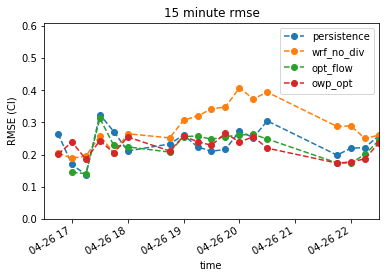

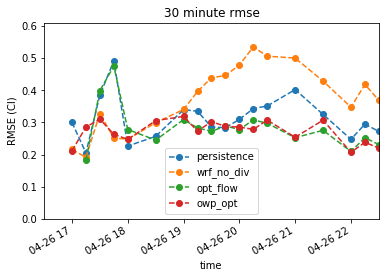

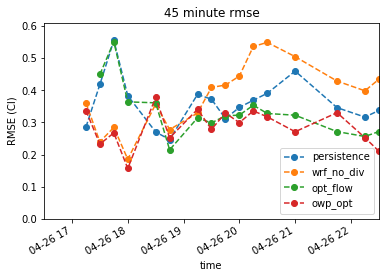

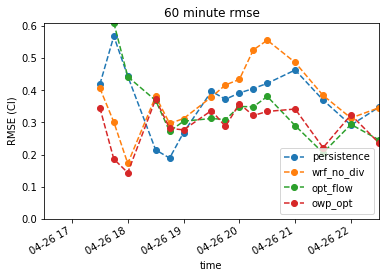

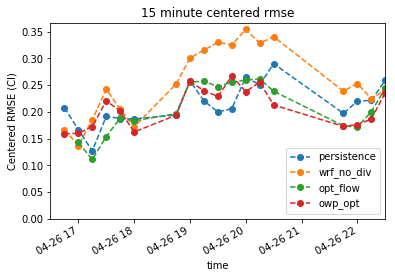

...

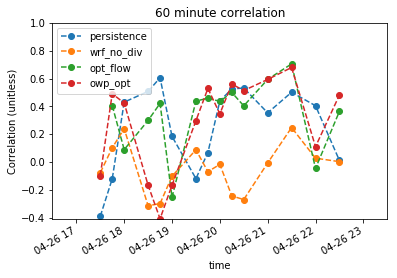

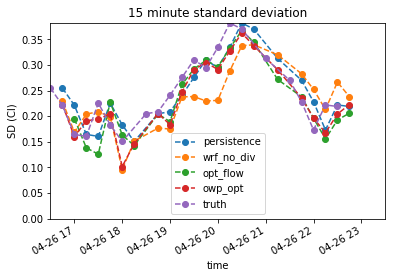

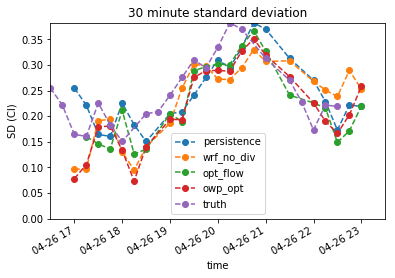

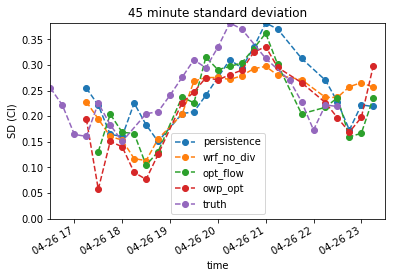

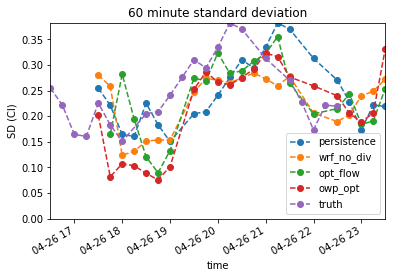

In [14]:
tmh_plot.generate_all_plots(returned)

In [96]:
# tmh_plot.generate_spread_plots(returned)

In [113]:
name_list = [
    arun['name']
    for arun in returned]
persistence = returned[
    name_list.index('persistence')]
stat_list = ['rmse']

In [114]:
# improvements for rmse
stat='rmse'
print(f'{month}/{day}: rmse')
for these_errors in returned:
    if these_errors['name'] == 'persistence':
        continue
    print(these_errors['name'] + '\n')
    decrease = (persistence[stat]
                - these_errors[stat])
    percent_decrease = decrease/persistence[stat]
    print('Percent decrease')
    print(percent_decrease.mean().loc[15:], '\n')
    skill_score = 1 - these_errors[stat]/persistence[stat]
    print('Skill Score')
    print(skill_score.mean().loc[15:], '\n')

5/29: rmse
wrf

Percent decrease
15    0.081032
30    0.021504
45   -0.040131
60   -0.041986
dtype: float64 

Skill Score
15    0.081032
30    0.021504
45   -0.040131
60   -0.041986
dtype: float64 

opt_flow

Percent decrease
15    0.053510
30   -0.100267
45   -0.257476
60   -0.230780
dtype: float64 

Skill Score
15    0.053510
30   -0.100267
45   -0.257476
60   -0.230780
dtype: float64 

ow_15

Percent decrease
15    0.138115
30    0.095585
45    0.143072
60    0.151318
dtype: float64 

Skill Score
15    0.138115
30    0.095585
45    0.143072
60    0.151318
dtype: float64 

ow_15_wp3

Percent decrease
15    0.141104
30    0.101734
45    0.167969
60    0.241050
dtype: float64 

Skill Score
15    0.141104
30    0.101734
45    0.167969
60    0.241050
dtype: float64 

owp_opt

Percent decrease
15    0.147070
30    0.133176
45    0.218520
60    0.275485
dtype: float64 

Skill Score
15    0.147070
30    0.133176
45    0.218520
60    0.275485
dtype: float64 



In [119]:
# improvements for correlation
stat = 'correlation' 
print(f'{month}/{day}: {stat}')
for these_errors in returned:
    if these_errors['name'] == 'persistence':
        continue
    print(these_errors['name'] + '\n')
    increase = (these_errors[stat]
                - persistence[stat])
    percent_increase = increase/np.abs(persistence[stat])
    print('Percent increase')
    print(percent_increase.mean().loc[15:], '\n')

5/29: correlation
wrf

Percent increase
15    2.757637
30    3.358814
45    0.168113
60    0.519948
dtype: float64 

opt_flow

Percent increase
15    2.825074
30    5.343416
45    0.148195
60    0.686799
dtype: float64 

ow_15

Percent increase
15    2.896414
30    5.122322
45    0.380834
60    0.845669
dtype: float64 

ow_15_wp3

Percent increase
15    2.913564
30    5.210164
45    0.362671
60    0.848792
dtype: float64 

owp_opt

Percent increase
15    2.904022
30    4.970512
45    0.430987
60    0.844600
dtype: float64 



# Taylor Diagram

In [168]:
# import ocw.plotter as oplt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import seaborn as sns
cpal = sns.color_palette()
sns.set_style('whitegrid')
sns.set_context('paper', font_scale=1.0, rc={'lines.linewidth':1.0, 'lines.markersize':7})

In [169]:
import numpy as NP
import matplotlib.pyplot as PLT

class TaylorDiagram(object):
    """Taylor diagram: plot model standard deviation and correlation
    to reference (data) sample in a single-quadrant polar plot, with
    r=stddev and theta=arccos(correlation).
    """

    def __init__(self, refstd, norm=False, fig=None, rect=111, label='_'):
        """Set up Taylor diagram axes, i.e. single quadrant polar
        plot, using mpl_toolkits.axisartist.floating_axes. refstd is
        the reference standard deviation to be compared to.
        """

        from matplotlib.projections import PolarAxes
        import mpl_toolkits.axisartist.floating_axes as FA
        import mpl_toolkits.axisartist.grid_finder as GF

        self.refstd = refstd            # Reference standard deviation
        self.std = refstd
        if norm:
            self.refstd = 1.0
            self.std = refstd
        self.norm = norm
        tr = PolarAxes.PolarTransform()

        # Correlation labels
        rlocs = NP.concatenate((NP.arange(5)/5.,[0.95,0.99]))
        tlocs = NP.arccos(rlocs)        # Conversion to polar angles
        gl1 = GF.FixedLocator(tlocs)    # Positions
        tf1 = GF.DictFormatter(dict(zip(tlocs, map(str,rlocs))))

        # Standard deviation axis extent
        self.smin = 0
        self.smax = 2*self.refstd
        gl2 = GF.MaxNLocator(5)


        ghelper = FA.GridHelperCurveLinear(tr,
                                           extremes=(0,NP.pi/2, # 1st quadrant
                                                     self.smin,self.smax),
                                           grid_locator1=gl1,
                                           grid_locator2=gl2,
                                           tick_formatter1=tf1,
                                           tick_formatter2=None
                                           )

        if fig is None:
            fig = PLT.figure()

        ax = FA.FloatingSubplot(fig, rect, grid_helper=ghelper)
        fig.add_subplot(ax)

        # Adjust axes
        ax.axis["top"].set_axis_direction("bottom")  # "Angle axis"
        ax.axis["top"].toggle(ticklabels=True, label=True, ticks=True)
        ax.axis["top"].major_ticklabels.set_axis_direction("top")
        ax.axis["top"].label.set_axis_direction("top")
        ax.axis["top"].label.set_text("Correlation")

        ax.axis["left"].set_axis_direction("bottom") # "X axis"
        #ax.axis["left"].major_ticklabels.set_rotation(25)
        ax.axis["left"].label.set_text("Standard Deviation")
        #ax.axis["left"].label.update_bbox_position_size((1.3,1.0))


        ax.axis["right"].set_axis_direction("top")   # "Y axis"
        ax.axis["right"].toggle(ticklabels=True, label=True)
        ax.axis["right"].major_ticklabels.set_axis_direction("left")
        ax.axis["right"].label.set_text("Standard Deviation")

        ax.axis["bottom"].set_visible(False)         # Useless
        
        # Contours along standard deviations
        ax.grid(True)
        #ax.get_aux_axes(tr).grid(True)
        self._ax = ax                   # Graphical axes
        self.ax = ax.get_aux_axes(tr)   # Polar coordinates
        
        #self.ax.patch = ax.patch # for aux_ax to have a clip path as in ax
        ax.patch.zorder = 0.9

        # Add reference point and stddev contour
        print("Reference std:", self.refstd)
        l, = self.ax.plot([0], self.refstd, 'k*',
                          ls='', ms=10, label=label, zorder=3)
        t = NP.linspace(0, NP.pi/2)
        r = NP.zeros_like(t) + self.refstd
        self.ax.plot(t,r, 'k--', label='_', zorder=3, alpha=0.6)

        # Collect sample points for latter use (e.g. legend)
        self.samplePoints = [l]

    def add_sample(self, stddev, corrcoef, *args, **kwargs):
        """Add sample (stddev,corrcoeff) to the Taylor diagram. args
        and kwargs are directly propagated to the Figure.plot
        command."""
        
        if self.norm:
            stddev = stddev*1.0/self.std
        l, = self.ax.plot(NP.arccos(corrcoef), stddev, zorder=5,
                          *args, **kwargs) # (theta,radius)
        self.samplePoints.append(l)

        return l

    def add_contours(self, levels=5, **kwargs):
        """Add constant centered RMS difference contours."""

        rs,ts = NP.meshgrid(NP.linspace(self.smin,self.smax),
                            NP.linspace(0,NP.pi/2))
        # Compute centered RMS difference
        rms = NP.sqrt(self.refstd**2 + rs**2 - 2*self.refstd*rs*NP.cos(ts))
        
        contours = self.ax.contour(ts, rs, rms, levels, zorder=4, **kwargs)
        self.ax.clabel(contours, inline=1, **kwargs)
        return contours
    
    def add_skill_contour(self, rms_val, **kwargs):
        rs,ts = NP.meshgrid(NP.linspace(self.smin,self.smax),
                            NP.linspace(0,NP.pi/2))
        # Compute centered RMS difference
        rms = NP.sqrt(self.refstd**2 + rs**2 - 2*self.refstd*rs*NP.cos(ts))
        
        contours = self.ax.contour(ts, rs, rms, rms_vals, **kwargs)

        return contours
    
    def add_corr_line(self, cor, **kwargs):
        acos = np.arccos(cor)
        line = self.ax.plot([0,acos], [0, self.smax], **kwargs)
        return line

In [170]:
%matplotlib notebook

In [171]:
def generate_taylor(returned, runs, normalized=True):
    fig = plt.figure(dpi=300)
    if normalized:
        sd_t = 1
        sd_t_array = returned[1]['truth_sd'].values.ravel()
    else:
        sd_t = returned[1]['truth_sd'].mean().item()
        sd_t_array = np.ones_like(returned[1]['truth_sd'].values.ravel())

    dia = TaylorDiagram(sd_t, norm=False, fig=fig, label='Observations')
    count = 0
    for run in runs:
        color = cpal[count]
        dia.add_sample(returned[count]['forecast_sd'].values.ravel()/sd_t_array,
                       returned[count]['correlation'].values.ravel(),
                       color=color, label=run + '_line')
        count += 1
#         dia.add_sample(sd_wrf.values.ravel(), corr_wrf.values.ravel(),
#                        color=cpal[2], label='wrf_line')

    horizons = [15, 30, 45, 60]
    marks = ['o', '^', 'd', 's']
    hor_count = 0
    for hor in horizons:
        count = 0
        for run in runs:
            color = cpal[count]
            mark = marks[hor_count]
            dia.add_sample(returned[count]['forecast_sd'].loc[hor]/sd_t_array[hor_count],
                           returned[count]['correlation'].loc[hor],
                           color=color, label=run, marker=mark)
            count += 1
        hor_count += 1
    
    if not normalized:
        mcount = 0
        for hor in horizons:
            color = 'k'
            mark = marks[mcount]
            dia.add_sample(returned[1]['truth_sd'].loc[hor],
                           [1],
                           color=color, label=run, marker=mark)
            mcount += 1
#     hor = 15
#     mark = 'o'
#     dia.add_sample(sd_ow.loc[hor], corr_ow.loc[hor], label='ow', marker=mark, color=cpal[4])
#     dia.add_sample(sd_wrf.loc[hor], corr_wrf.loc[hor], label='wrf', marker=mark, color=cpal[2])

#     hor = 30
#     mark = '^'
#     dia.add_sample(sd_ow.loc[hor], corr_ow.loc[hor], label='ow', marker=mark, color=cpal[4])
#     dia.add_sample(sd_wrf.loc[hor], corr_wrf.loc[hor], label='wrf', marker=mark, color=cpal[2])

#     hor = 45
#     mark = 'd'
#     dia.add_sample(sd_ow.loc[hor], corr_ow.loc[hor], label='ow', marker=mark, color=cpal[4])
#     dia.add_sample(sd_wrf.loc[hor], corr_wrf.loc[hor], label='wrf', marker=mark, color=cpal[2])

#     hor = 60
#     mark = 's'
#     dia.add_sample(sd_ow.loc[hor], corr_ow.loc[hor], label='ow', marker=mark, color=cpal[4])
#     dia.add_sample(sd_wrf.loc[hor], corr_wrf.loc[hor], label='wrf', marker=mark, color=cpal[2])

    dia.add_contours(5, colors='k', alpha=0.25, fontsize=8)
    samplePoints = dia.samplePoints[0:len(runs) + 1]
    fig.legend(samplePoints, ['obs'] + runs)


In [172]:
%matplotlib inline

In [181]:
plt.close('all')

In [142]:
#delete

In [182]:
runs = ['persistence', 'wrf_no_div', 'opt_flow', 'ow_15', 'owp_opt']

In [183]:
directory_name = 'first_set'
error_stats = []
for run in runs:
    load_directory = ('/a2/uaren/travis/'
                      + 'results/multi_day_error/'
                      + f'{directory_name}/{run}')
    adict = {'name': run}
    for stat_file in os.listdir(load_directory):
        stat_name = stat_file.split('.')[0]
        stat_file = os.path.join(load_directory,
                                 stat_file)
        adict[stat_name] = pd.read_hdf(stat_file)
    error_stats.append(adict)

In [184]:
#delete

In [185]:
%matplotlib notebook

2014 5 29


<IPython.core.display.Javascript object>


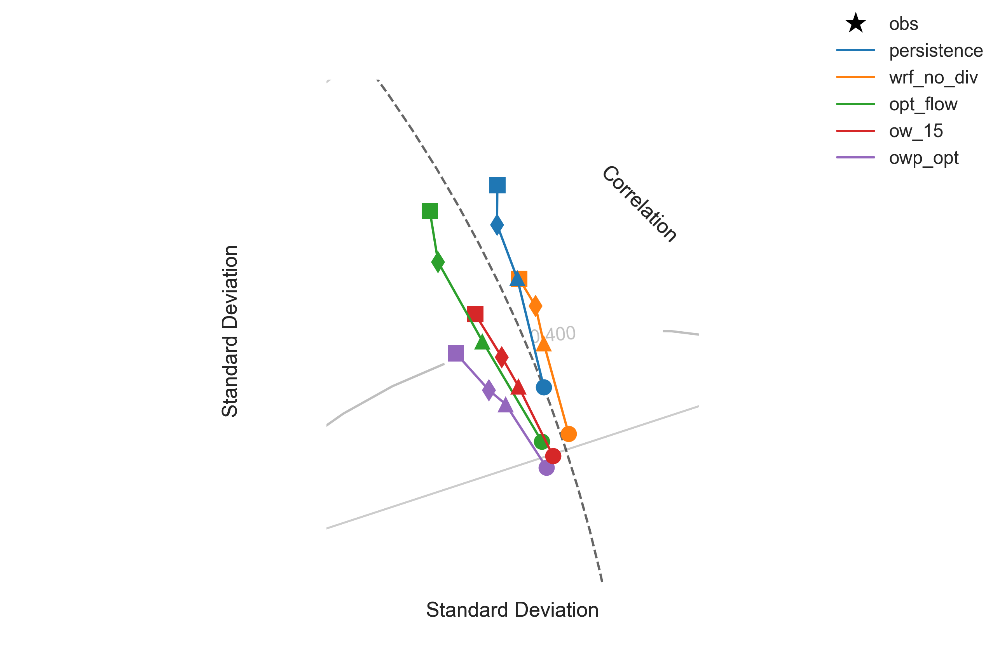

Reference std: 1


/home/travis/miniconda3/envs/letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


In [186]:
print(year, month, day)
generate_taylor(error_stats, runs)

In [183]:
importlib.reload(ar)
importlib.reload(letkf_io)
base_folder = '/a2/uaren/travis'
year = 2014
month = 4
day = 18
runs = ['persistence', 'wrf_no_div', 'radiosonde', 'ow_15']
error_stats = ar.error_stats_one_day(year, month, day, runs, base_folder)

persistence
wrf_no_div
radiosonde
ow_15


In [185]:
plt.close('all')

2014 4 18
Reference std: 1


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


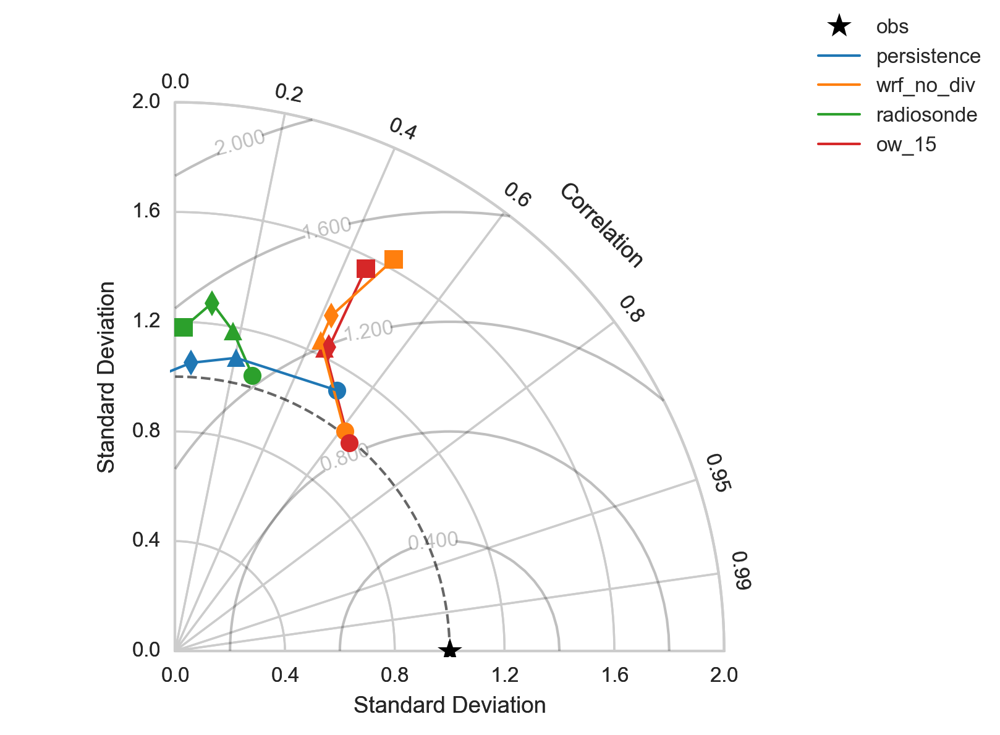

In [186]:
print(year, month, day)
generate_taylor(error_stats, runs)

In [187]:
importlib.reload(ar)
importlib.reload(letkf_io)
base_folder = '/a2/uaren/travis'
year = 2014
month = 5
day = 6
runs = ['persistence', 'wrf_no_div', 'radiosonde', 'ow_15']
error_stats = ar.error_stats_one_day(year, month, day, runs, base_folder)

persistence
wrf_no_div
radiosonde
ow_15


In [188]:
print(year, month, day, '\n')
count = 0
for run in runs:
    print(run, '\n')
    print(error_stats[count]['bias'], '\n')
    print(error_stats[count]['rmse'], '\n')
    count += 1

2014 5 6 

persistence 

    bias
15   0.0
30   0.0
45   0.0
60   0.0 

        rmse
15  0.102345
30  0.141421
45  0.155965
60  0.138865 

wrf_no_div 

        bias
15 -0.015636
30 -0.033034
45 -0.032085
60 -0.031753 

        rmse
15  0.071454
30  0.099781
45  0.099500
60  0.098759 

radiosonde 

        bias
15 -0.022018
30 -0.045542
45 -0.054579
60 -0.048756 

        rmse
15  0.099032
30  0.138300
45  0.154766
60  0.140638 

ow_15 

        bias
15 -0.007077
30 -0.023949
45 -0.021846
60 -0.018887 

        rmse
15  0.071386
30  0.098924
45  0.102895
60  0.102322 



In [189]:
plt.close('all')

2014 5 6
Reference std: 

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


1


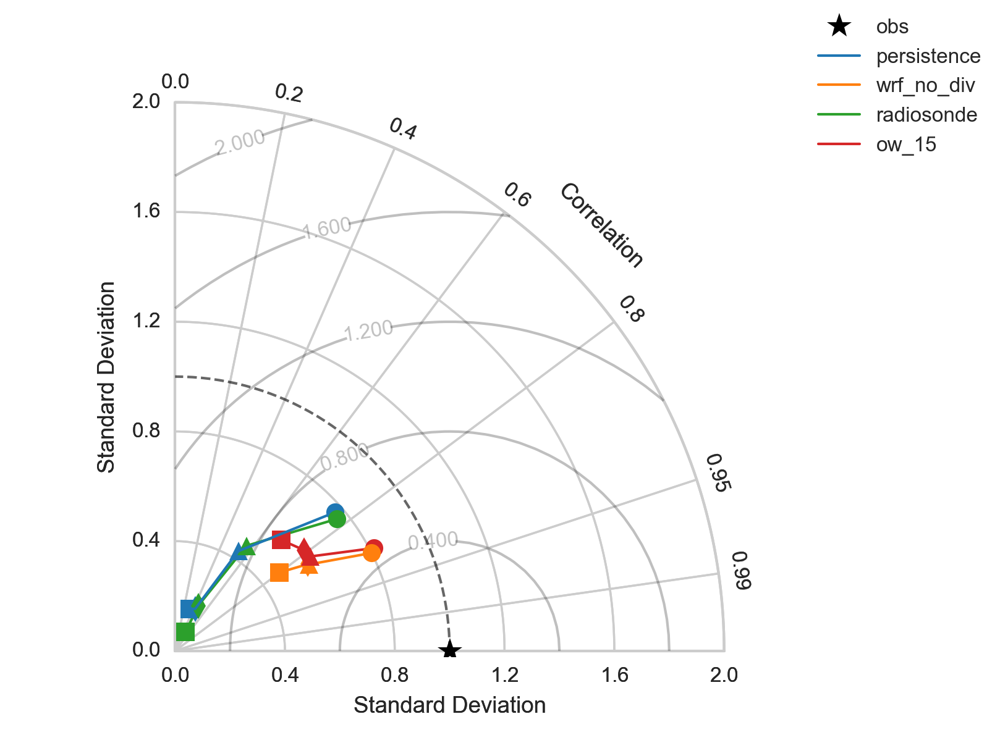

In [190]:
print(year, month, day)
generate_taylor(error_stats, runs)

In [191]:
importlib.reload(ar)
importlib.reload(letkf_io)
base_folder = '/a2/uaren/travis'
year = 2014
month = 5
day = 29
runs = ['persistence', 'wrf_no_div', 'radiosonde', 'ow_15']
error_stats = ar.error_stats_one_day(year, month, day, runs, base_folder)

persistence
wrf_no_div
radiosonde
ow_15


In [192]:
print(year, month, day, '\n')
count = 0
for run in runs:
    print(run, '\n')
    print(error_stats[count]['bias'], '\n')
    print(error_stats[count]['rmse'], '\n')
    count += 1

2014 5 29 

persistence 

    bias
15   0.0
30   0.0
45   0.0
60   0.0 

        rmse
15  0.170066
30  0.218365
45  0.235559
60  0.264560 

wrf_no_div 

        bias
15  0.012173
30  0.021296
45  0.021316
60  0.024050 

        rmse
15  0.155044
30  0.192246
45  0.201304
60  0.210369 

radiosonde 

        bias
15  0.037279
30  0.076696
45  0.077231
60  0.076589 

        rmse
15  0.184071
30  0.252919
45  0.278748
60  0.291895 

ow_15 

        bias
15 -0.001455
30 -0.008458
45 -0.022997
60 -0.037468 

        rmse
15  0.144814
30  0.178623
45  0.177883
60  0.202137 



In [193]:
plt.close('all')

2014 5 29
Reference std: 1


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


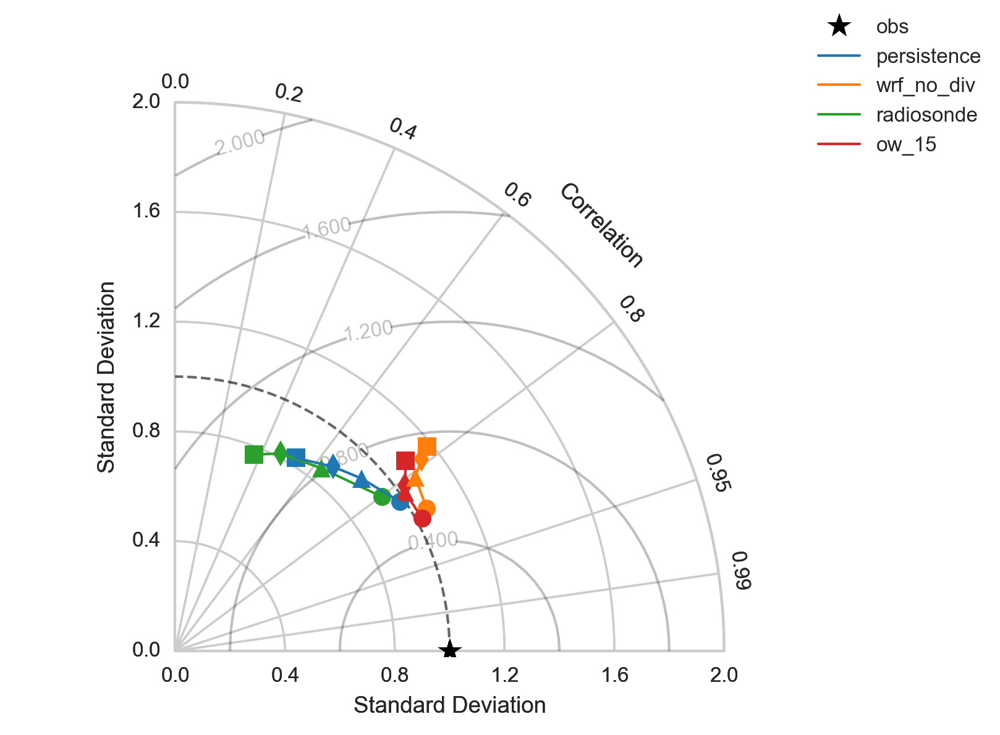

In [194]:
print(year, month, day)
generate_taylor(error_stats, runs)

In [235]:
importlib.reload(ar)
importlib.reload(letkf_io)
# months = [4,  4,  4, 5, 5,  5,  6,  6]
# days =   [9, 15, 18, 6, 9, 29, 11, 12]
month_day = [[4, 9], [4, 15], [4, 18], [5, 6], [5, 9], [5, 29], [6, 11], [6, 12]]
dates = []
for ii in range(len(month_day)):
    dates.append(datetime.date(2014, month_day[ii][0], month_day[ii][1]))
base_folder = '/a2/uaren/travis'
runs = ['persistence', 'radiosonde', 'opt_flow', 'wrf_no_div', 'ow_15', 'ow_15_wp3']
error_stats_full = ar.error_stats_many_days(dates, runs, base_folder)

persistence


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

radiosonde


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

opt_flow


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

wrf_no_div


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

ow_15


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

ow_15_wp3


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

In [236]:
print(dates, '\n')
count = 0
for run in runs:
    print(run, '\n')
    print(error_stats_full[count]['bias'], '\n')
    print(error_stats_full[count]['rmse'], '\n')
    count += 1

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12)] 

persistence 

        bias
15 -0.004245
30 -0.003314
45 -0.003771
60 -0.001790 

        rmse
15  0.123024
30  0.149218
45  0.163237
60  0.170769 

radiosonde 

        bias
15  0.000982
30 -0.005879
45 -0.018184
60 -0.020309 

        rmse
15  0.126459
30  0.154167
45  0.165736
60  0.166821 

opt_flow 

        bias
15 -0.005310
30 -0.012548
45 -0.020185
60 -0.029655 

        rmse
15  0.126081
30  0.151601
45  0.170449
60  0.180448 

wrf_no_div 

        bias
15  0.000204
30 -0.003863
45 -0.006535
60 -0.011708 

        rmse
15  0.110529
30  0.132363
45  0.142019
60  0.147891 

ow_15 

        bias
15  0.001459
30 -0.004150
45 -0.005704
60 -0.010337 

        rmse
15  0.105825
30  0.123270
45  0.131457
60  0.141965 

ow_15_wp3 

        bias
15  0.004670
30  0.004

In [242]:
plt.close('all')

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12)]
Reference std: 1


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


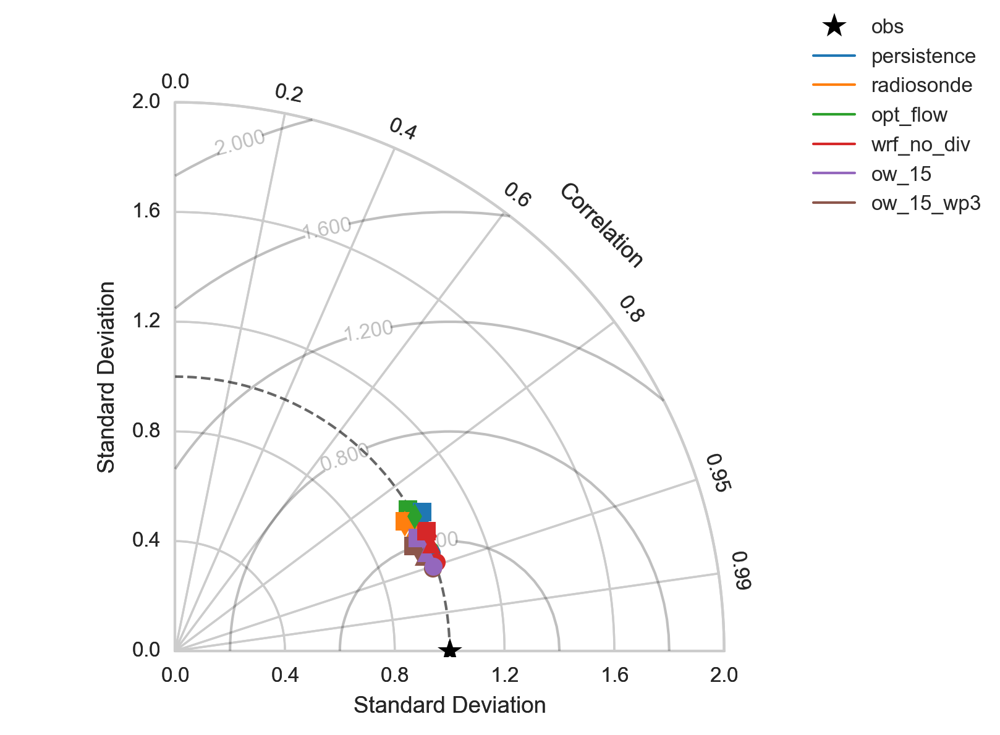

In [238]:
print(dates)
generate_taylor(error_stats_full, runs)

In [240]:
%matplotlib notebook

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12)]


<IPython.core.display.Javascript object>


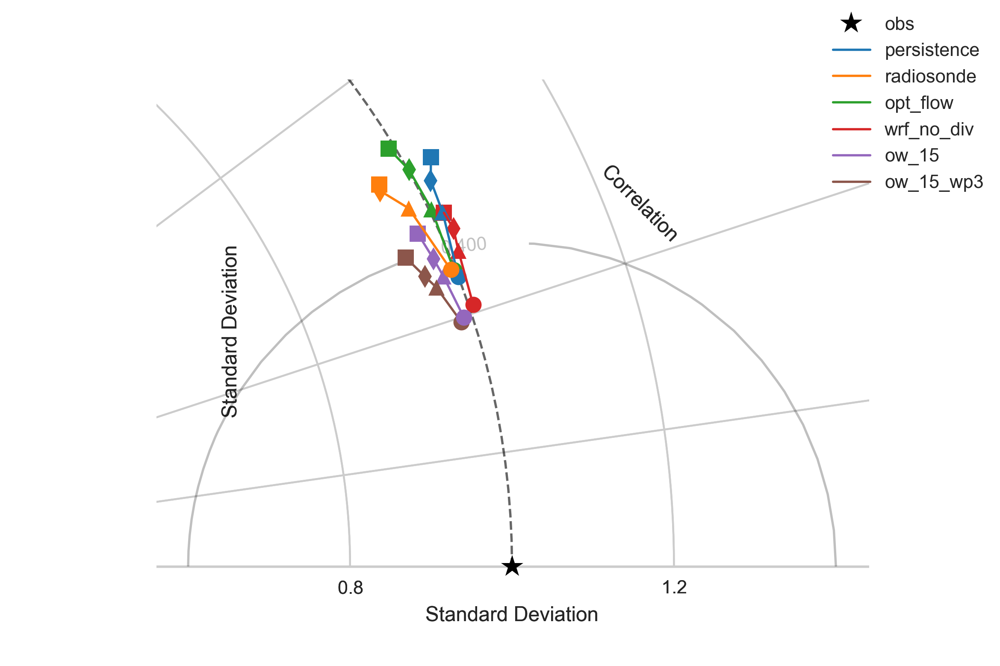

Reference std: 1


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


In [241]:
print(dates)
generate_taylor(error_stats_full, runs)

In [226]:
importlib.reload(ar)
importlib.reload(letkf_io)
# months = [4,  4,  4, 5, 5,  5,  6,  6]
# days =   [9, 15, 18, 6, 9, 29, 11, 12]
month_day = [[4, 9], [4, 15], [4, 18], [5, 6], [5, 9], [5, 29], [6, 11], [6, 12]]
dates = []
for ii in range(len(month_day)):
    dates.append(datetime.date(2014, month_day[ii][0], month_day[ii][1]))
base_folder = '/a2/uaren/travis'
runs = ['persistence', 'wrf_no_div', 'radiosonde', 'opt_flow', 'ow_15']
error_stats_full = ar.error_stats_many_days(dates, runs, base_folder)

persistence


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

wrf_no_div


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

radiosonde


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

opt_flow


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

ow_15


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

In [227]:
print(dates, '\n')
count = 0
for run in runs:
    print(run, '\n')
    print(error_stats_full[count]['bias'], '\n')
    print(error_stats_full[count]['rmse'], '\n')
    count += 1

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12)] 

persistence 

        bias
15 -0.004245
30 -0.003314
45 -0.003771
60 -0.001790 

        rmse
15  0.123024
30  0.149218
45  0.163237
60  0.170769 

wrf_no_div 

        bias
15  0.000204
30 -0.003863
45 -0.006535
60 -0.011708 

        rmse
15  0.110529
30  0.132363
45  0.142019
60  0.147891 

radiosonde 

        bias
15  0.000982
30 -0.005879
45 -0.018184
60 -0.020309 

        rmse
15  0.126459
30  0.154167
45  0.165736
60  0.166821 

opt_flow 

        bias
15 -0.005310
30 -0.012548
45 -0.020185
60 -0.029655 

        rmse
15  0.126081
30  0.151601
45  0.170449
60  0.180448 

ow_15 

        bias
15  0.001459
30 -0.004150
45 -0.005704
60 -0.010337 

        rmse
15  0.105825
30  0.123270
45  0.131457
60  0.141965 



In [232]:
plt.close('all')

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12)]


<IPython.core.display.Javascript object>


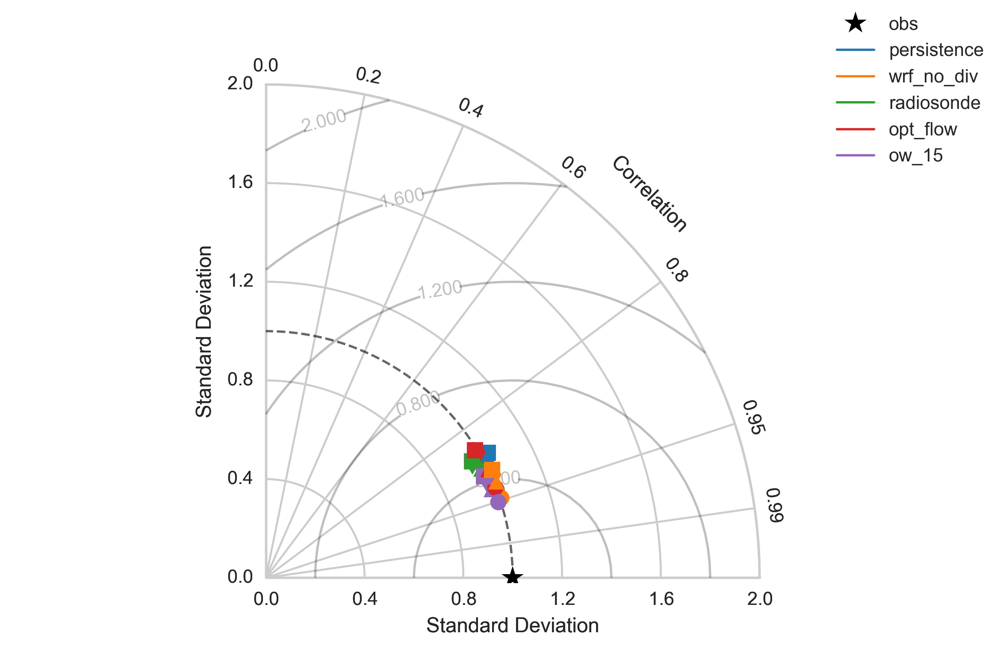

Reference std: 1


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


In [229]:
print(dates)
generate_taylor(error_stats_full, runs)

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12)]


<IPython.core.display.Javascript object>


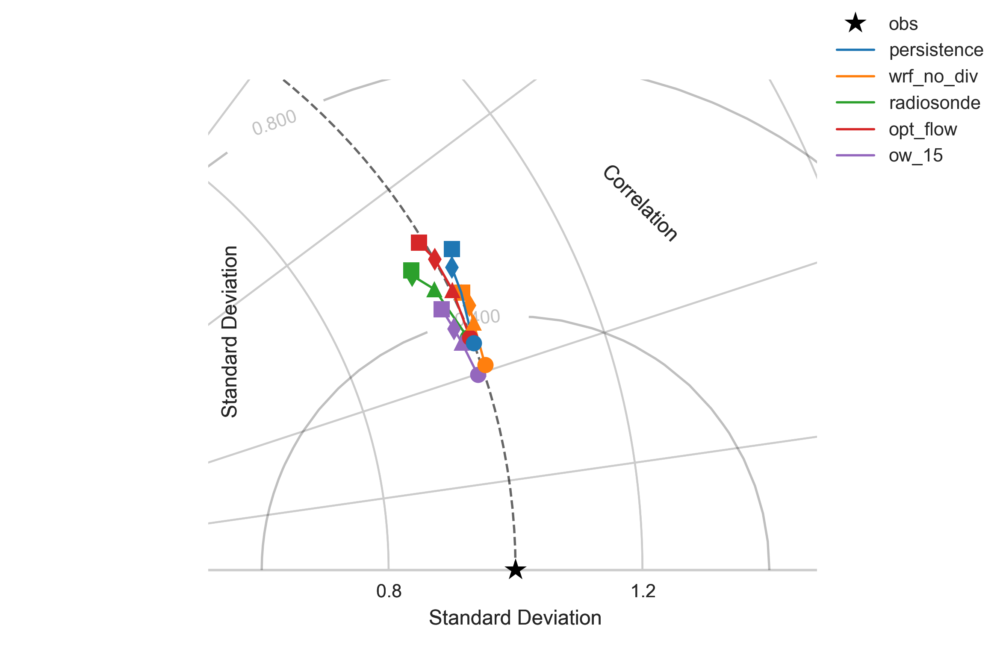

Reference std: 1


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


In [231]:
print(dates)
generate_taylor(error_stats_full, runs)

In [234]:
%matplotlib inline

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12)]


<IPython.core.display.Javascript object>


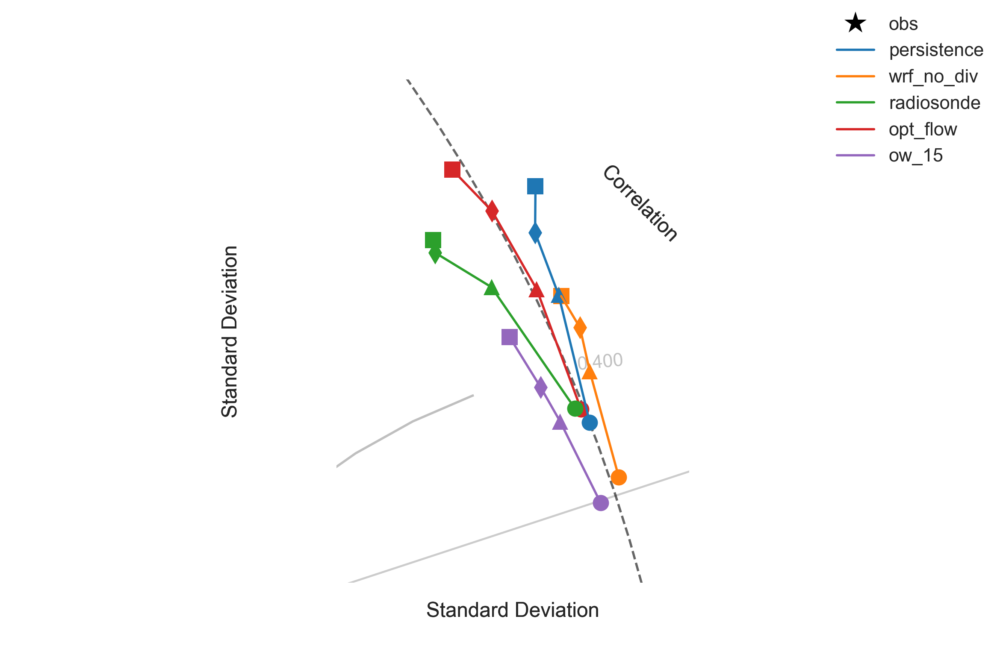

Reference std: 1


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


In [233]:
print(dates)
generate_taylor(error_stats_full, runs)

In [218]:
importlib.reload(ar)
importlib.reload(letkf_io)
# months = [4,  4,  4, 5, 5,  5,  6,  6]
# days =   [9, 15, 18, 6, 9, 29, 11, 12]
month_day = [[4, 9], [4, 15], [4, 18], [5, 6], [5, 9], [5, 29], [6, 11], [6, 12],
             [4, 2], [4, 5],  [4, 19], [5, 7], [5, 8], [6, 3],  [6, 10], [6, 14], [6, 15]]
dates = []
for ii in range(len(month_day)):
    dates.append(datetime.date(2014, month_day[ii][0], month_day[ii][1]))
base_folder = '/a2/uaren/travis'
runs = ['persistence', 'wrf_no_div', 'radiosonde', 'ow_15']
error_stats_full = ar.error_stats_many_days(dates, runs, base_folder)

persistence
wrf_no_div


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

radiosonde


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

ow_15


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is ty

In [219]:
print(dates, '\n')
count = 0
for run in runs:
    print(run, '\n')
    print(error_stats_full[count]['bias'], '\n')
    print(error_stats_full[count]['rmse'], '\n')
    count += 1

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12), datetime.date(2014, 4, 2), datetime.date(2014, 4, 5), datetime.date(2014, 4, 19), datetime.date(2014, 5, 7), datetime.date(2014, 5, 8), datetime.date(2014, 6, 3), datetime.date(2014, 6, 10), datetime.date(2014, 6, 14), datetime.date(2014, 6, 15)] 

persistence 

    bias
15   0.0
30   0.0
45   0.0
60   0.0 

        rmse
15  0.119485
30  0.140323
45  0.149992
60  0.155284 

wrf_no_div 

        bias
15 -0.001002
30 -0.005318
45 -0.008518
60 -0.013867 

        rmse
15  0.103726
30  0.126753
45  0.135685
60  0.141039 

radiosonde 

        bias
15 -0.001258
30 -0.009472
45 -0.018856
60 -0.019541 

        rmse
15  0.129779
30  0.150796
45  0.159694
60  0.168756 

ow_15 

        bias
15  0.002734
30 -0.001232
45 -0.003635
60 -0.008056 

        rmse
15  0.105323
30  0.

In [220]:
plt.close('all')

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12), datetime.date(2014, 4, 2), datetime.date(2014, 4, 5), datetime.date(2014, 4, 19), datetime.date(2014, 5, 7), datetime.date(2014, 5, 8), datetime.date(2014, 6, 3), datetime.date(2014, 6, 10), datetime.date(2014, 6, 14), datetime.date(2014, 6, 15)]
Reference std: 1


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


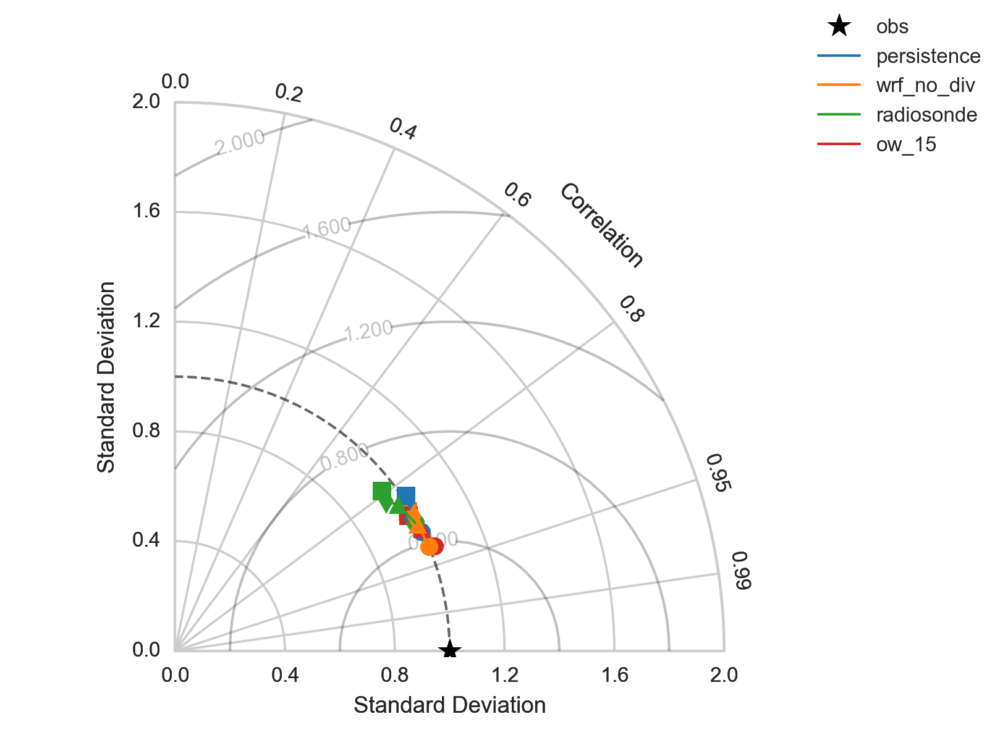

In [222]:
print(dates)
generate_taylor(error_stats_full, runs)

In [223]:
%matplotlib notebook

[datetime.date(2014, 4, 9), datetime.date(2014, 4, 15), datetime.date(2014, 4, 18), datetime.date(2014, 5, 6), datetime.date(2014, 5, 9), datetime.date(2014, 5, 29), datetime.date(2014, 6, 11), datetime.date(2014, 6, 12), datetime.date(2014, 4, 2), datetime.date(2014, 4, 5), datetime.date(2014, 4, 19), datetime.date(2014, 5, 7), datetime.date(2014, 5, 8), datetime.date(2014, 6, 3), datetime.date(2014, 6, 10), datetime.date(2014, 6, 14), datetime.date(2014, 6, 15)]


<IPython.core.display.Javascript object>


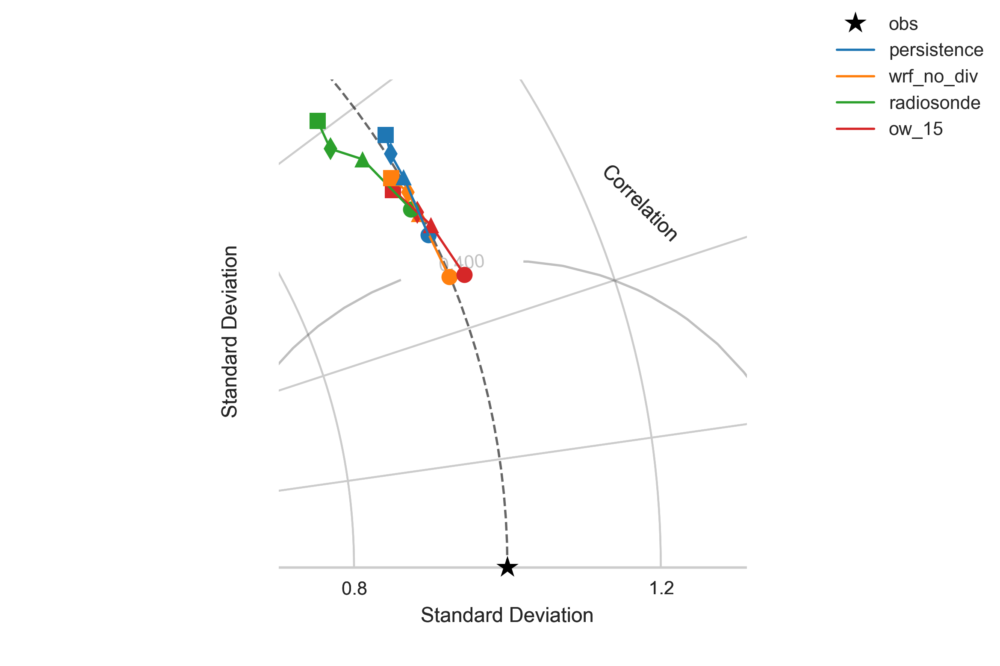

Reference std: 1


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


In [224]:
print(dates)
generate_taylor(error_stats_full, runs)

In [225]:
plt.close('all')

In [13]:
year = 2014
month = 5
day = 29
runs = ['ow_15', 'ow_15_wp1', 'ow_15_wp2', 'ow_15_wp3', 'ow_15_wp4']
returned = ar.error_stats_one_day(year, month, day, runs)

ow_15
ow_15_wp1
ow_15_wp2
ow_15_wp3
ow_15_wp4


<IPython.core.display.Javascript object>


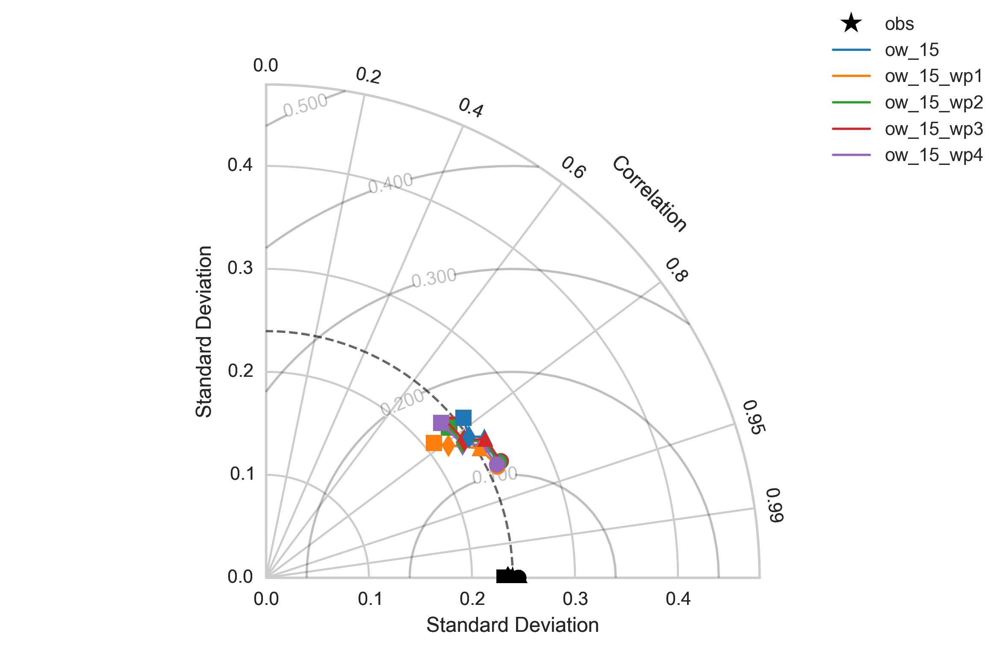

Reference std: 0.23958459815693628


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/contour.py:967: UserWarning: The following kwargs were not used by contour: 'fontsize'
  s)


In [21]:
generate_taylor()

In [266]:
year = 2014
month = 4
day = 15
runs = ['wrf', 'ow_15']
wrf, ow_15 = ar.error_stats_one_day(year, month, day, runs)

wrf
ow_15


In [267]:
print(wrf['bias'])
print(ow_15['bias'])

        bias
15 -0.002238
30 -0.003436
45 -0.003472
60 -0.002262
        bias
15 -0.000430
30 -0.000306
45  0.000559
60  0.002344


<IPython.core.display.Javascript object>


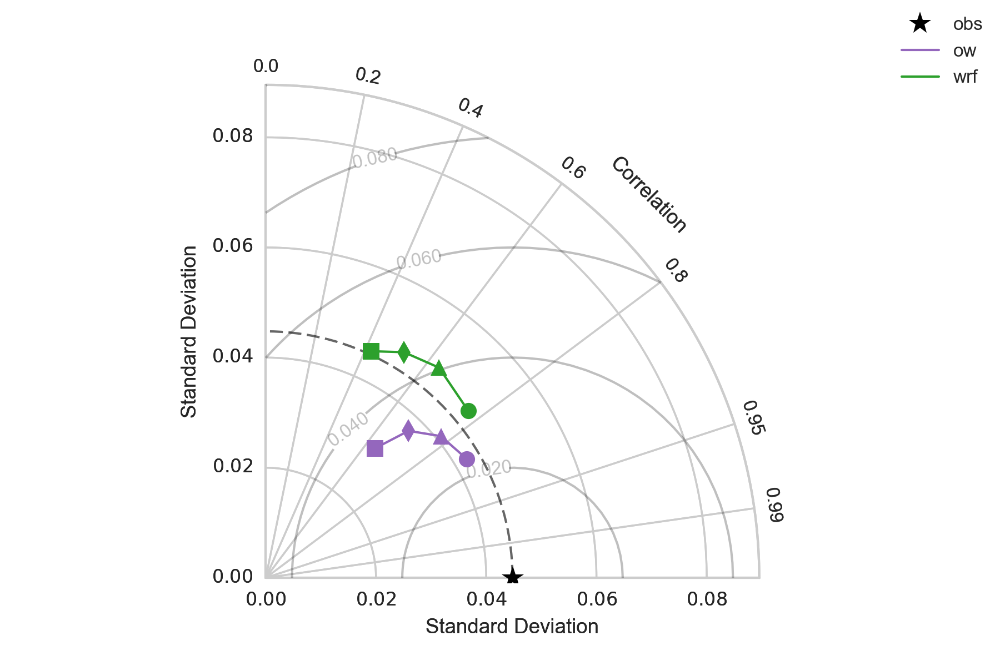

Reference std: 0.044767180365537694


In [284]:
generate_taylor()

In [401]:
year = 2014
month = 5
day = 29
runs = ['persistence', 'wrf', 'ow_15', 'ow_15_wp1']
returned = ar.error_stats_one_day(year, month, day, runs)

persistence
wrf
ow_15
ow_15_wp1


In [402]:
count = 0
for run in runs:
    print(run, '\n')
    print(returned[count]['bias'], '\n')
    print(returned[count]['rmse'], '\n')
    count += 1

persistence 

    bias
15   0.0
30   0.0
45   0.0
60   0.0 

        rmse
15  0.130889
30  0.169718
45  0.184258
60  0.207552 

wrf 

        bias
15 -0.019175
30 -0.034393
45 -0.055288
60 -0.080921 

        rmse
15  0.142735
30  0.186329
45  0.218330
60  0.242050 

ow_15 

        bias
15  0.005361
30  0.011918
45  0.024990
60  0.039034 

        rmse
15  0.114197
30  0.141988
45  0.144196
60  0.165181 

ow_15_wp1 

        bias
15  0.001717
30 -0.003209
45 -0.012586
60 -0.000212 

        rmse
15  0.109954
30  0.131876
45  0.141399
60  0.147852 



Reference std: 0.23958459815693628


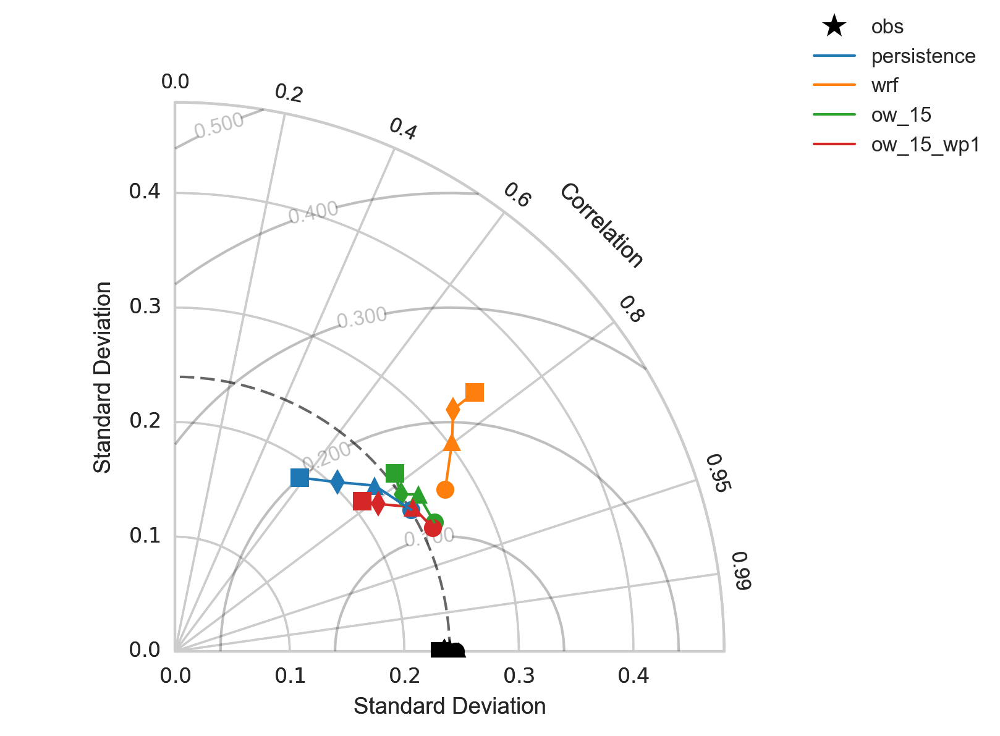

In [414]:
generate_taylor()

In [426]:
year = 2014
month = 5
day = 29
runs = ['persistence', 'wrf', 'wrf_no_div',
        'opt_flow', 'radiosonde', 'ow_15', 'ow_15_wp1']
returned = ar.error_stats_one_day(year, month, day, runs)

persistence
wrf
wrf_no_div
opt_flow
radiosonde
ow_15
ow_15_wp1


In [427]:
count = 0
for run in runs:
    print(run, '\n')
    print(returned[count]['bias'], '\n')
    print(returned[count]['rmse'], '\n')
    count += 1

persistence 

    bias
15   0.0
30   0.0
45   0.0
60   0.0 

        rmse
15  0.130889
30  0.169718
45  0.184258
60  0.207552 

wrf 

        bias
15 -0.019175
30 -0.034393
45 -0.055288
60 -0.080921 

        rmse
15  0.142735
30  0.186329
45  0.218330
60  0.242050 

wrf_no_div 

        bias
15 -0.024822
30 -0.044605
45 -0.067518
60 -0.087102 

        rmse
15  0.140787
30  0.184241
45  0.207742
60  0.239345 

opt_flow 

        bias
15  0.032443
30  0.058118
45  0.080354
60  0.103465 

        rmse
15  0.164024
30  0.200071
45  0.226427
60  0.244138 

radiosonde 

        bias
15 -0.030358
30 -0.063969
45 -0.069036
60 -0.074740 

        rmse
15  0.142998
30  0.198401
45  0.218726
60  0.230506 

ow_15 

        bias
15  0.005361
30  0.011918
45  0.024990
60  0.039034 

        rmse
15  0.114197
30  0.141988
45  0.144196
60  0.165181 

ow_15_wp1 

        bias
15  0.001717
30 -0.003209
45 -0.012586
60 -0.000212 

        rmse
15  0.109954
30  0.131876
45  0.141399
60  0.147852 



Reference std: 0.23958459815693628


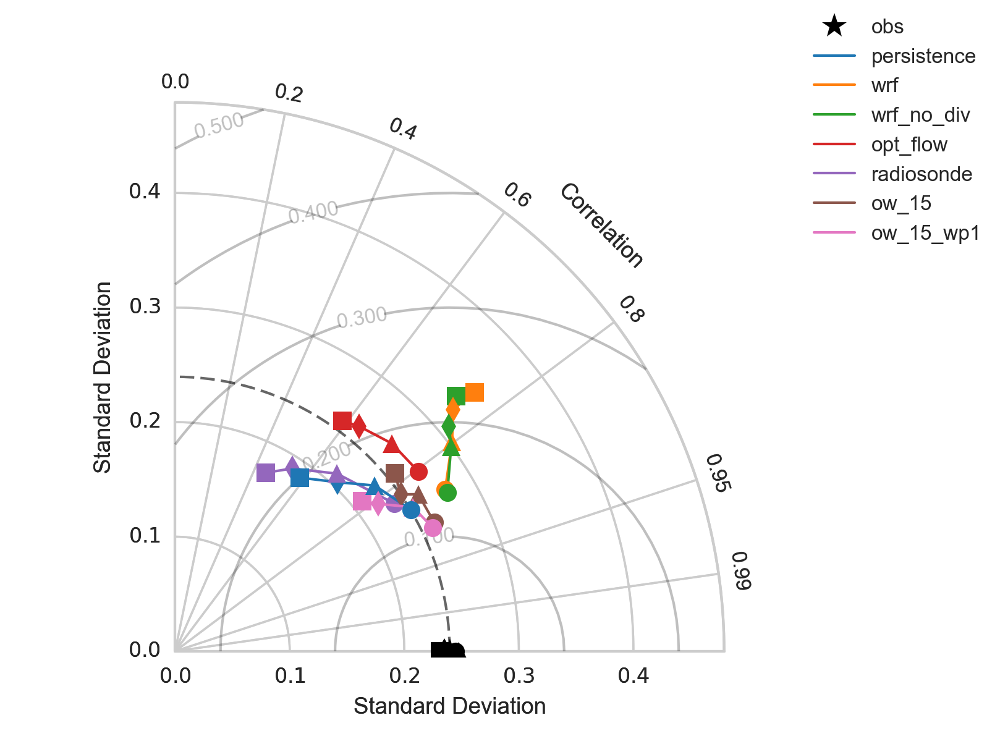

In [428]:
generate_taylor()

In [319]:
year = 2014
month = 4
day = 18
runs = ['wrf', 'ow_15']
wrf, ow_15 = ar.error_stats_one_day(year, month, day, runs)

wrf
ow_15


In [320]:
print(wrf['bias'])
print(ow_15['bias'])

        bias
15  0.015167
30  0.075166
45  0.155060
60  0.195135
        bias
15  0.017375
30  0.038225
45  0.063213
60  0.089686


Reference std: 0.07601640647292353


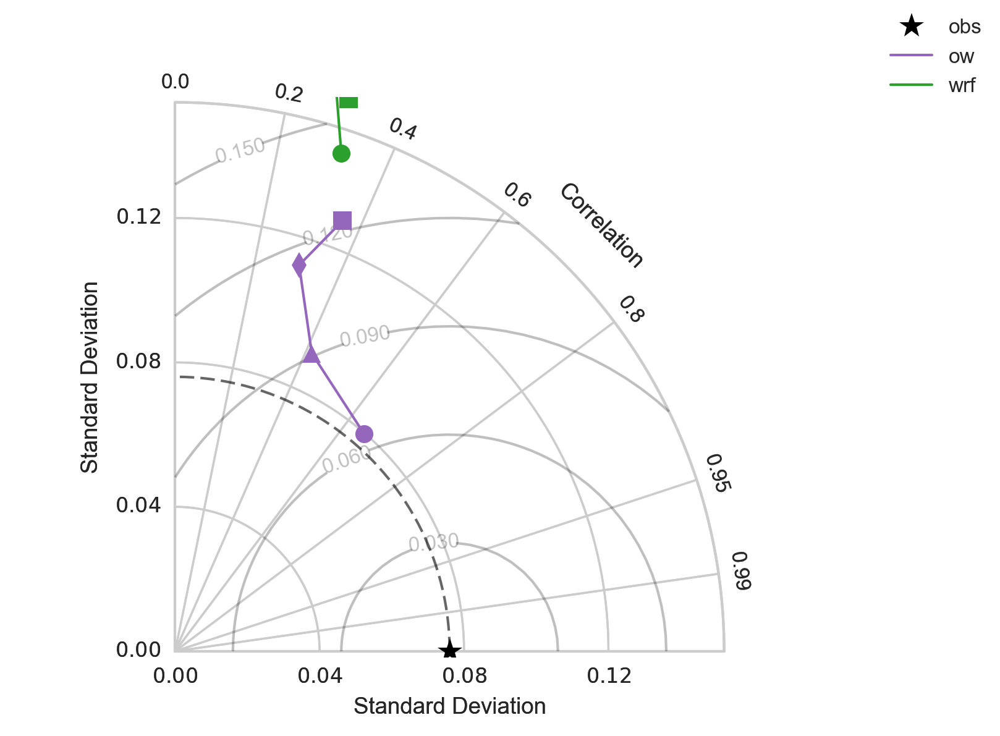

In [321]:
generate_taylor()

In [367]:
len(cpal)

10

In [282]:
sd_t = ow_15['truth_sd']
sd_ow = ow_15['forecast_sd']
corr_ow = ow_15['correlation']
sd_wrf = wrf['forecast_sd']
corr_wrf = wrf['correlation']

dia = TaylorDiagram(sd_t, norm=False, fig=fig, label='Observations')

dia.add_sample(sd_ow.values.ravel(), corr_ow.values.ravel(),
               color=cpal[4], label='ow_line')
dia.add_sample(sd_wrf.values.ravel(), corr_wrf.values.ravel(),
               color=cpal[2], label='wrf_line')

hor = 15
mark = 'o'
dia.add_sample(sd_ow.loc[hor], corr_ow.loc[hor], label='ow', marker=mark, color=cpal[4])
dia.add_sample(sd_wrf.loc[hor], corr_wrf.loc[hor], label='wrf', marker=mark, color=cpal[2])

hor = 30
mark = '^'
dia.add_sample(sd_ow.loc[hor], corr_ow.loc[hor], label='ow', marker=mark, color=cpal[4])
dia.add_sample(sd_wrf.loc[hor], corr_wrf.loc[hor], label='wrf', marker=mark, color=cpal[2])

hor = 45
mark = 'd'
dia.add_sample(sd_ow.loc[hor], corr_ow.loc[hor], label='ow', marker=mark, color=cpal[4])
dia.add_sample(sd_wrf.loc[hor], corr_wrf.loc[hor], label='wrf', marker=mark, color=cpal[2])

hor = 60
mark = 's'
dia.add_sample(sd_ow.loc[hor], corr_ow.loc[hor], label='ow', marker=mark, color=cpal[4])
dia.add_sample(sd_wrf.loc[hor], corr_wrf.loc[hor], label='wrf', marker=mark, color=cpal[2])

dia.add_contours(5, colors='k', alpha=0.25, fontsize=8)

fig.legend([dia.samplePoints[0],
            dia.samplePoints[1],
            dia.samplePoints[2]], ['obs', 'ow', 'wrf'])

Reference std: 0.044767180365537694


In [69]:
print([p.get_label() for p in dia.samplePoints])

['Observations', 'ow_line', 'wrf_line', 'ow', 'wrf', 'ow', 'wrf', 'ow', 'wrf', 'ow', 'wrf']


In [ ]:
dia.add_sample(std_cor['areap'][0][fh], std_cor['areap'][1][fh], label='Spatial Avg. Pers.', marker=mark, color=cpal[4], ls='',)
dia.add_sample(std_cor['pers'][0][fh], std_cor['pers'][1][fh], label='Clear-Sky Index Pers.', marker=mark, color=cpal[2], ls='')
dia.add_sample(std_cor['pers_30'][0][fh], std_cor['pers_30'][1][fh], label='5 min. Avg. Pers.', marker=mark, color=cpal[1], ls='')
dia.add_sample(std_cor['network'][0][fh], std_cor['network'][1][fh], label='Network', marker=mark, color=cpal[5], ls='')
#dia.add_corr_line(std_cor['network'][1][fh],linestyle='--', color='k', alpha=0.3)

#dia.add_sample(std_cor['pers_30'][0].values, std_cor['pers_30'][1].values, color=cpal[1],label='5 min. avg')
#dia.add_sample(std_cor['pers_60'][0].values, std_cor['pers_60'][1].values, color=cpal[0], label='10 min. avg')

dia.ax.text(NP.arccos(std_cor['pers'][1][fh]), std_cor['pers'][0][fh]+ 0.01, '{} min.'.format(fh/60), color='k', zorder=10, fontsize=8)


fh = 3*60
mark = '^'
dia.add_sample(std_cor['areap'][0][fh], std_cor['areap'][1][fh], label='Spatial Avg. Pers.', marker=mark, color=cpal[4], ls='')
dia.add_sample(std_cor['pers'][0][fh], std_cor['pers'][1][fh], label='Clear-Sky Index Pers.', marker=mark, color=cpal[2], ls='')
dia.add_sample(std_cor['pers_30'][0][fh], std_cor['pers_30'][1][fh], label='5 min. Avg. Pers.', marker=mark, color=cpal[1], ls='')
dia.add_sample(std_cor['network'][0][fh], std_cor['network'][1][fh], label='Network', marker=mark, color=cpal[5], ls='')
#dia.add_corr_line(std_cor['network'][1][fh],linestyle='--', color='k', alpha=0.3)

dia.ax.text(NP.arccos(std_cor['pers'][1][fh]), std_cor['pers'][0][fh]+ 0.01, '{} min.'.format(fh/60), color='k', zorder=10, fontsize=8)

fh = 7*60
mark = 'd'
dia.add_sample(std_cor['areap'][0][fh], std_cor['areap'][1][fh], label='Spatial Avg. Pers.', marker=mark, color=cpal[4], ls='')
dia.add_sample(std_cor['pers'][0][fh], std_cor['pers'][1][fh], label='Clear-Sky Index Pers.', marker=mark, color=cpal[2], ls='')
dia.add_sample(std_cor['pers_30'][0][fh], std_cor['pers_30'][1][fh], label='30 min. Avg. Pers.', marker=mark, color=cpal[1], ls='')
dia.add_sample(std_cor['network'][0][fh], std_cor['network'][1][fh], label='Network', marker=mark, color=cpal[5], ls='')
#dia.add_corr_line(std_cor['network'][1][fh],linestyle='--', color='k', alpha=0.3)

dia.ax.text(NP.arccos(std_cor['pers'][1][fh]), std_cor['pers'][0][fh]+ 0.01, '{} min.'.format(fh/60), color='k', zorder=10, fontsize=8)

fh = 30*60
mark = 's'
dia.add_sample(std_cor['areap'][0][fh], std_cor['areap'][1][fh], label='Spatial Avg. Pers.', marker=mark, color=cpal[4], ls='')
dia.add_sample(std_cor['pers'][0][fh], std_cor['pers'][1][fh], label='Clear-Sky Index Pers.', marker=mark, color=cpal[2], ls='')
dia.add_sample(std_cor['pers_30'][0][fh], std_cor['pers_30'][1][fh], label='30 min. Avg. Pers.', marker=mark, color=cpal[1], ls='')
dia.add_sample(std_cor['network'][0][fh], std_cor['network'][1][fh], label='Network', marker=mark, color=cpal[5], ls='', )
#dia.add_corr_line(std_cor['network'][1][fh],linestyle='--', color='k', alpha=0.3)

dia.ax.text(NP.arccos(std_cor['pers'][1][fh]), std_cor['pers'][0][fh]+ 0.01, '{} min.'.format(fh/60), color='k', zorder=10, fontsize=8)

fh = 120*60
mark = 'p'
dia.add_sample(std_cor['areap'][0][fh], std_cor['areap'][1][fh], label='Spatial Avg. Pers.', marker=mark, color=cpal[4], ls='')
dia.add_sample(std_cor['pers'][0][fh], std_cor['pers'][1][fh], label='Clear-Sky Index Pers.', marker=mark, color=cpal[2], ls='')
dia.add_sample(std_cor['pers_30'][0][fh], std_cor['pers_30'][1][fh], label='30 min. Avg. Pers.', marker=mark, color=cpal[1], ls='')
dia.add_sample(std_cor['network'][0][fh], std_cor['network'][1][fh], label='Network', marker=mark, color=cpal[5], ls='')
#dia.add_corr_line(std_cor['network'][1][fh],linestyle='--', color='k', alpha=0.3)

dia.ax.text(NP.arccos(std_cor['pers'][1][fh]-0.13), std_cor['pers'][0][fh]+ 0.015, '{} min.'.format(fh/60), color='k', zorder=10, fontsize=8)

dia.add_sample(std_cor['areap'][0].values, std_cor['areap'][1].values, color=cpal[4],)
dia.add_sample(std_cor['pers'][0].values, std_cor['pers'][1].values, color=cpal[2],)

dia.add_sample(std_cor['pers_30'][0].values, std_cor['pers_30'][1].values, color=cpal[1],)
#dia.add_sample(std_cor['pers_60'][0].values, std_cor['pers_60'][1].values, color='g',)


dia.add_sample(std_cor['network'][0].values, std_cor['network'][1].values, color=cpal[5],)

dia.add_contours(5, colors='k', alpha=0.25, fontsize=8)
dia.add_sample(0, 0, color='white', label=' ', ls='')

dia.samplePoints.insert(2, dia.samplePoints[-1])
print [p.get_label() for p in dia.samplePoints]
fig.legend(dia.samplePoints[:6],
            [ p.get_label() for p in dia.samplePoints[:6] ],
            numpoints=1, ncol=2,  bbox_to_anchor=(.9,1), prop={'size':8})#loc='center right', )#prop={'size':'small'})
#fig.suptitle('Taylor Plot', y=1.1)
fig.tight_layout(h_pad=0.5, w_pad=0.5, rect=(0,0,1, .95))

fig.show()

['Observations', 'ow', '_line11', 'wrf', 'ow', 'wrf', 'ow', 'wrf', 'ow', 'wrf', '_line10', '_line11', '_line12', '_line13']


# End Taylor

In [61]:
ow_15['truth_sd']

<xarray.DataArray 'ci' (time: 21)>
array([ 0.052863,  0.052448,  0.067372,  0.09242 ,  0.108215,  0.154726,
        0.134556,  0.089467,  0.083047,  0.097653,  0.099793,  0.090056,
        0.114255,  0.107177,  0.169458,  0.268223,  0.303177,  0.28542 ,
        0.274221,  0.27431 ,  0.247617])
Coordinates:
  * time     (time) datetime64[ns] 2014-05-29T16:30:00 2014-05-29T16:45:00 ...

In [62]:
reconstructed_ow_15 = (
    ow_15['bias'][15]**2
    + ow_15['forecast_sd'][15]**2
    + ow_15['truth_sd'].to_pandas()**2
    - 2
    * ow_15['forecast_sd'][15]
    * ow_15['truth_sd'].to_pandas()
    * ow_15['correlation'][15])

In [49]:
runs = runs[0:1]

In [45]:
returned[0]['truth_sd']

<xarray.DataArray 'ci' (time: 21)>
array([ 0.052863,  0.052448,  0.067372,  0.09242 ,  0.108215,  0.154726,
        0.134556,  0.089467,  0.083047,  0.097653,  0.099793,  0.090056,
        0.114255,  0.107177,  0.169458,  0.268223,  0.303177,  0.28542 ,
        0.274221,  0.27431 ,  0.247617])
Coordinates:
  * time     (time) datetime64[ns] 2014-05-29T16:30:00 2014-05-29T16:45:00 ...

In [ ]:
# y_max = np.max(list(map(lambda x: x.max().max(), error)))
y_max = None
for hor in [15, 30, 45, 60]:
    plt.figure()
    for aresult in returned:
        aresult['rmse'][hor].dropna().plot(linestyle='--', marker='o')
    (aresult['rmse'][hor]*np.nan).plot(color='b')
    
#     bare[hor].dropna().plot(linestyle='--')
#     wrf[hor].dropna().plot()
#     ow_4[hor].dropna().plot()
#     ow_8[hor].dropna().plot()
# #     opt_wrf[hor].dropna().plot()
#     #wrf_no_div[60].dropna().plot()
    plt.legend(runs)
    plt.ylim([0, y_max])
    plt.ylabel('RMSE (CI)')
    plt.title(f'{hor} minute rmse: {month}/{day}')

In [ ]:
y_max = None
for hor in [15, 30, 45, 60]:
    plt.figure()
    for aresult in returned:
        aresult['rmse'][hor].dropna().plot(linestyle='--', marker='o')
    (aresult[hor]*np.nan).plot(color='b')
    
#     bare[hor].dropna().plot(linestyle='--')
#     wrf[hor].dropna().plot()
#     ow_4[hor].dropna().plot()
#     ow_8[hor].dropna().plot()
# #     opt_wrf[hor].dropna().plot()
#     #wrf_no_div[60].dropna().plot()
    plt.legend(runs)
    plt.ylim([0, y_max])
    plt.ylabel('RMSE (CI)')
    plt.title(f'{hor} minute rmse: {month}/{day}')

<IPython.core.display.Javascript object>


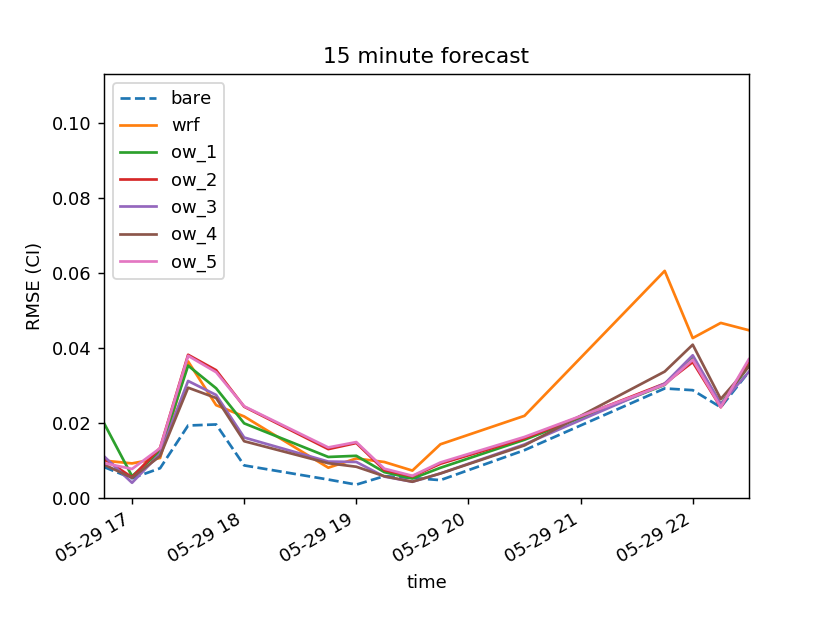

<IPython.core.display.Javascript object>


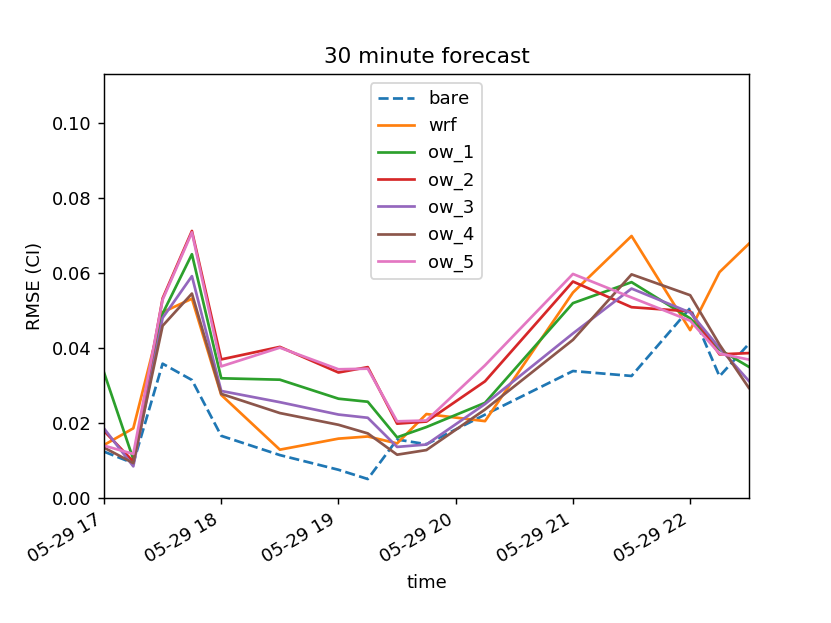

<IPython.core.display.Javascript object>


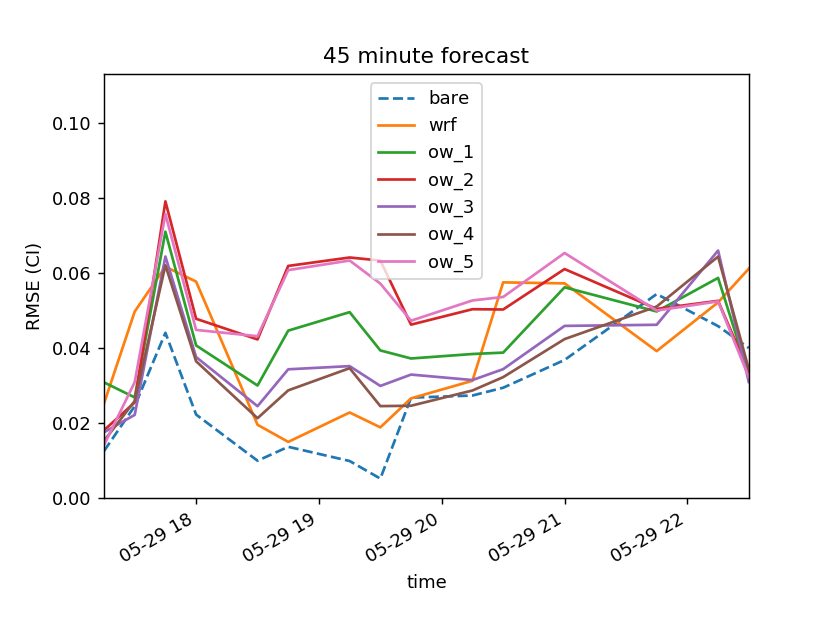

<IPython.core.display.Javascript object>


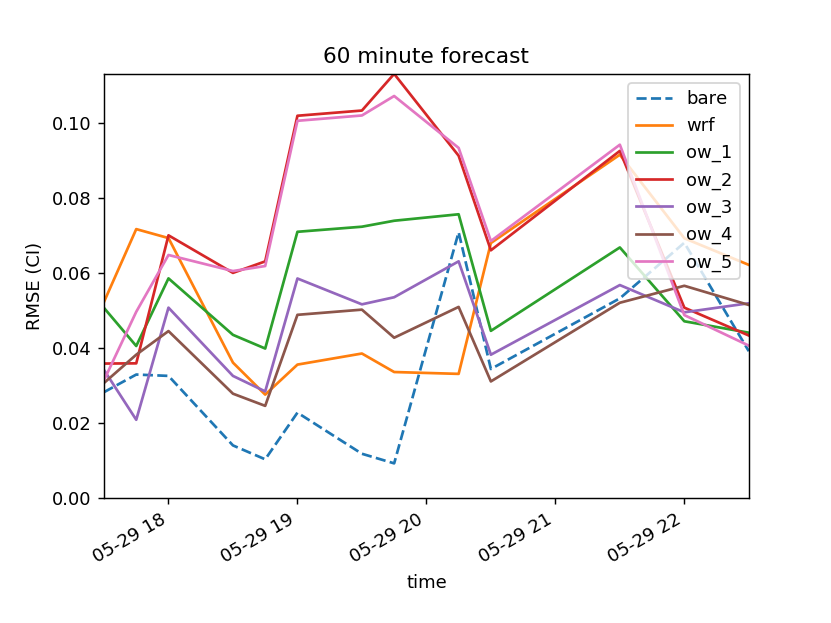

In [86]:
y_max = np.max([bare.max(),
                wrf.max(),
                ow_1.max(),
                ow_2.max(),
                ow_3.max(),
                ow_4.max(),
                ow_5.max()])
for hor in [15, 30, 45, 60]:
    plt.figure()
    bare[hor].dropna().plot(linestyle='--')
    wrf[hor].dropna().plot()
    ow_1[hor].dropna().plot()
    ow_2[hor].dropna().plot()
    ow_3[hor].dropna().plot()
    ow_4[hor].dropna().plot()
    ow_5[hor].dropna().plot()
#     opt_wrf[hor].dropna().plot()
    #wrf_no_div[60].dropna().plot()
    plt.legend(runs)
    plt.ylim([0, y_max])
    plt.ylabel('RMSE (CI)')
    plt.title(f'{hor} minute forecast')

In [90]:
for ii in range(len(returned)):
    print(runs[ii] + '\n')
    arun = returned[ii]
    decrease = wrf - arun
    percent_decrease = decrease/wrf
    print(percent_decrease.mean(), '\n')

bare

15    0.405439
30    0.304330
45    0.321095
60    0.361671
dtype: float64 

wrf

15    0.0
30    0.0
45    0.0
60    0.0
dtype: float64 

ow_1

15    0.081801
30   -0.199011
45   -0.306767
60   -0.242991
dtype: float64 

ow_2

15    0.058368
30   -0.299209
45   -0.594990
60   -0.632160
dtype: float64 

ow_3

15    0.220058
30   -0.012556
45   -0.073363
60    0.013403
dtype: float64 

ow_4

15    0.236471
30    0.067785
45    0.011411
60    0.108971
dtype: float64 

ow_5

15    0.040229
30   -0.300693
45   -0.572688
60   -0.616654
dtype: float64 



In [11]:
runs = ['bare', 'wrf', 'ow_4', 'ow_6', 'ow_7', 'ow_8', 'ow_9']

In [12]:
returned = ar.error_compare(year, month, day, runs)
bare, wrf, ow_4, ow_6, ow_7, ow_8, ow_9 = returned

<IPython.core.display.Javascript object>


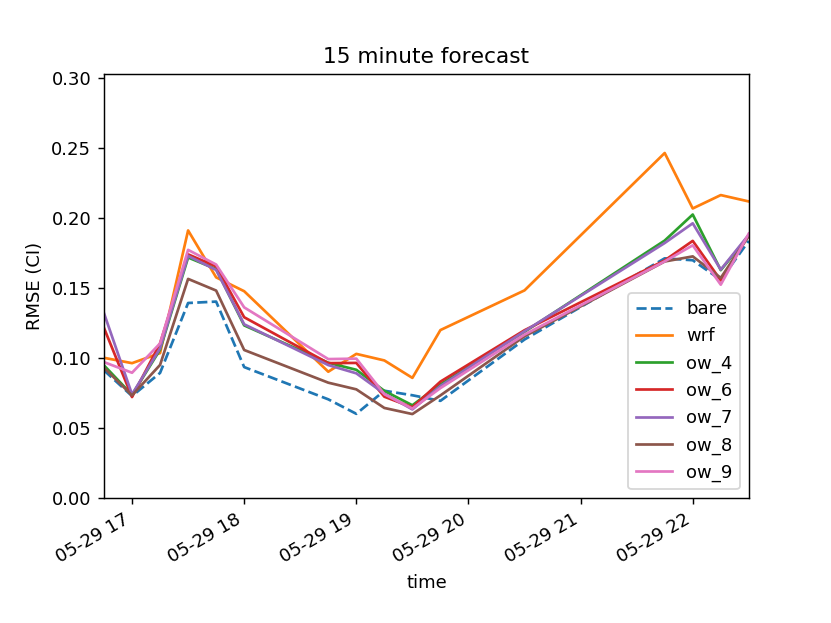

<IPython.core.display.Javascript object>


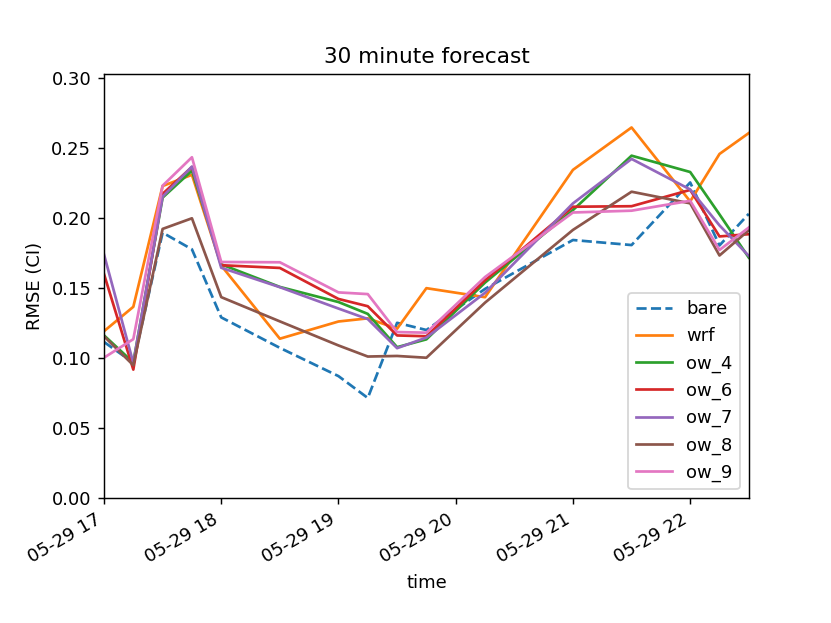

<IPython.core.display.Javascript object>


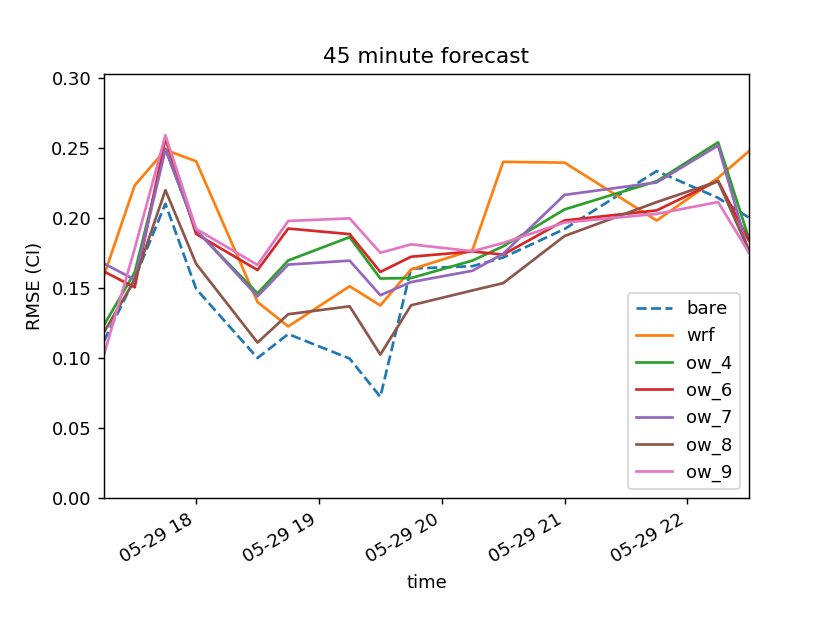

<IPython.core.display.Javascript object>


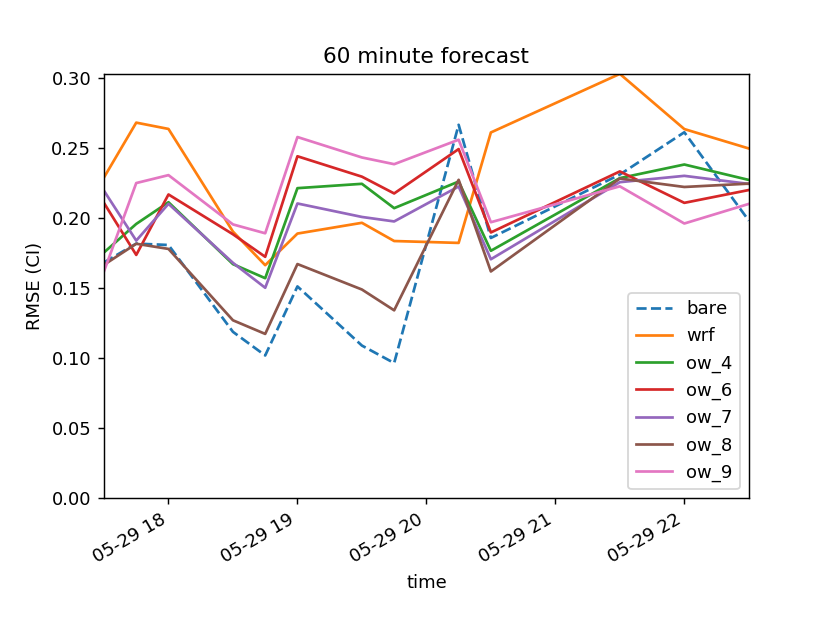

In [17]:
y_max = np.max([bare.max(),
                wrf.max(),
                ow_4.max(),
                ow_6.max(),
                ow_7.max(),
                ow_8.max(),
                ow_9.max()])
for hor in [15, 30, 45, 60]:
    plt.figure()
    bare[hor].dropna().plot(linestyle='--')
    wrf[hor].dropna().plot()
    ow_4[hor].dropna().plot()
    ow_6[hor].dropna().plot()
    ow_7[hor].dropna().plot()
    ow_8[hor].dropna().plot()
    ow_9[hor].dropna().plot()
#     opt_wrf[hor].dropna().plot()
    #wrf_no_div[60].dropna().plot()
    plt.legend(runs)
    plt.ylim([0, y_max])
    plt.ylabel('RMSE (CI)')
    plt.title(f'{hor} minute forecast')

In [18]:
for ii in range(len(returned)):
    print(runs[ii] + '\n')
    arun = returned[ii]
    decrease = wrf - arun
    percent_decrease = decrease/wrf
    print(percent_decrease.mean(), '\n')

bare

15    0.235504
30    0.177846
45    0.192675
60    0.235610
dtype: float64 

wrf

15    0.0
30    0.0
45    0.0
60    0.0
dtype: float64 

ow_4

15    0.133819
30    0.048250
45    0.024784
60    0.073361
dtype: float64 

ow_6

15    0.122197
30    0.020880
45   -0.002258
60    0.030254
dtype: float64 

ow_7

15    0.117905
30    0.029892
45    0.029982
60    0.090039
dtype: float64 

ow_8

15    0.210706
30    0.151581
45    0.172723
60    0.216235
dtype: float64 

ow_9

15    0.122719
30    0.031226
45   -0.001487
60    0.002654
dtype: float64 



<IPython.core.display.Javascript object>


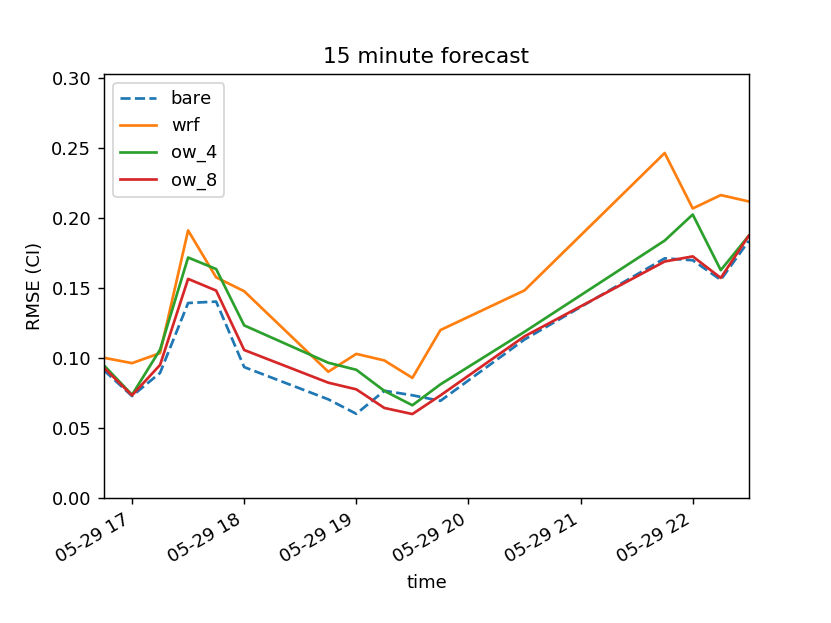

<IPython.core.display.Javascript object>


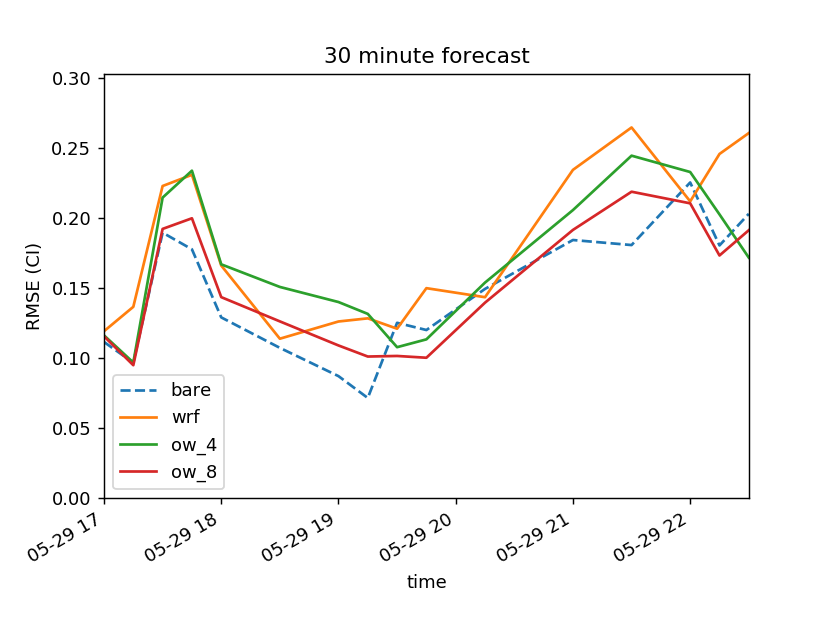

<IPython.core.display.Javascript object>


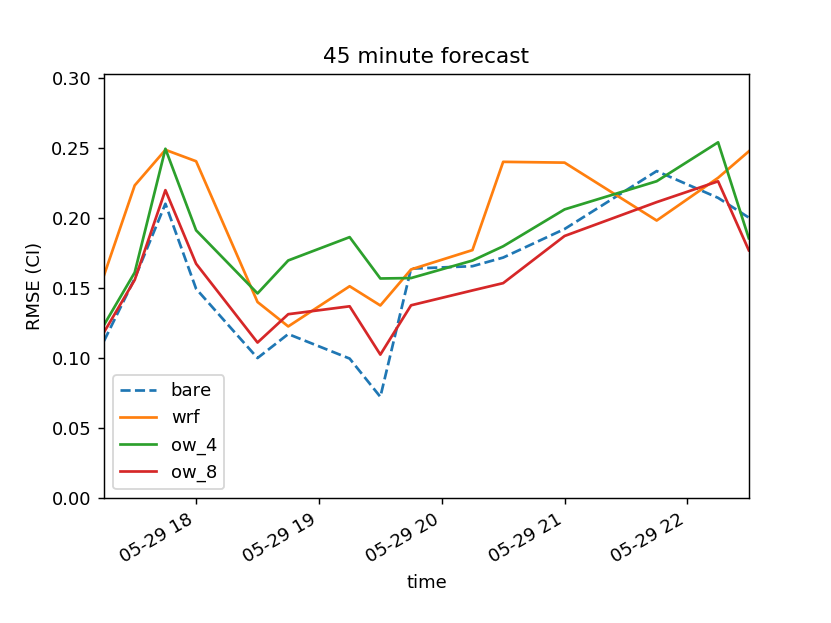

<IPython.core.display.Javascript object>


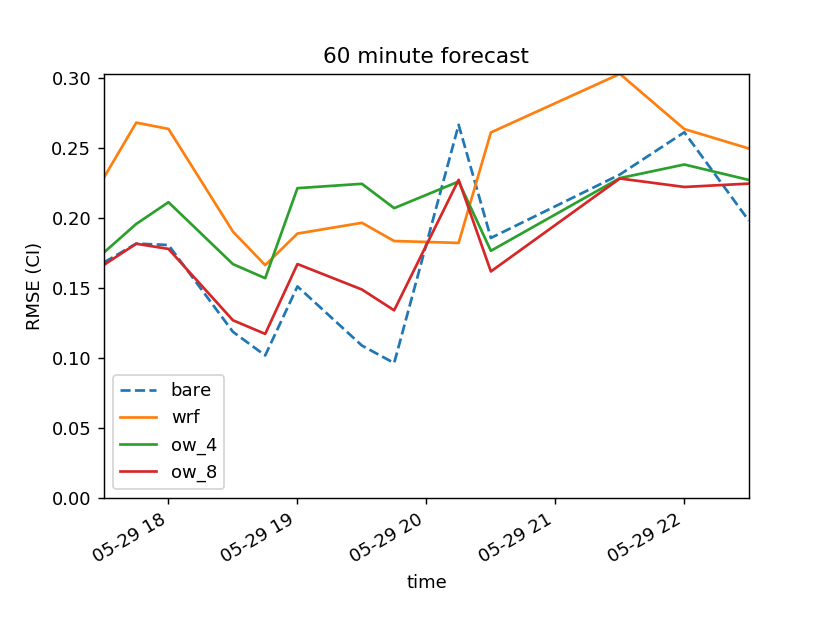

In [19]:
y_max = np.max([bare.max(),
                wrf.max(),
                ow_4.max(),
                ow_8.max()])
for hor in [15, 30, 45, 60]:
    plt.figure()
    bare[hor].dropna().plot(linestyle='--')
    wrf[hor].dropna().plot()
    ow_4[hor].dropna().plot()
    ow_8[hor].dropna().plot()
#     opt_wrf[hor].dropna().plot()
    #wrf_no_div[60].dropna().plot()
    plt.legend(['bare', 'wrf', 'ow_4', 'ow_8'])
    plt.ylim([0, y_max])
    plt.ylabel('RMSE (CI)')
    plt.title(f'{hor} minute forecast')

In [37]:
import letkf_forecasting.letkf_io as io

In [38]:
importlib.reload(ar)
importlib.reload(io)

<module 'letkf_forecasting.letkf_io' from '/home2/travis/python_code/letkf_forecasting/letkf_forecasting/letkf_io.py'>

In [133]:
runs = ['wrf', 'ow_15', 'ow_16', 'ow_17']

In [ ]:
error, spread_ci, mean_sd_ci, spread_wind = ar.error_stats(year, month, day, runs)

wrf
ow_15


In [ ]:
wrf = error[0]

In [124]:
plt.close('all')

<IPython.core.display.Javascript object>


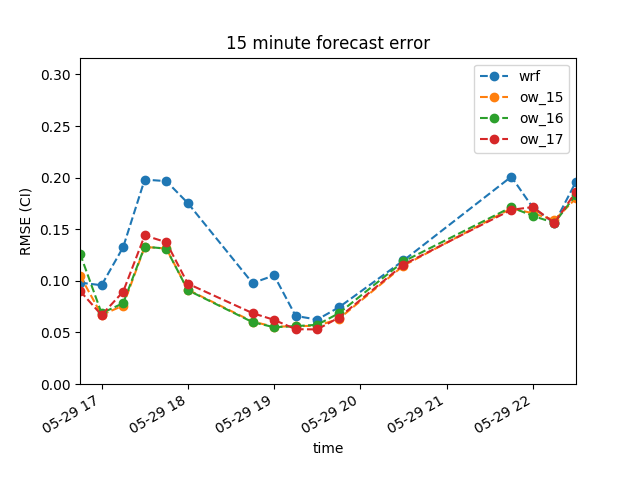

<IPython.core.display.Javascript object>


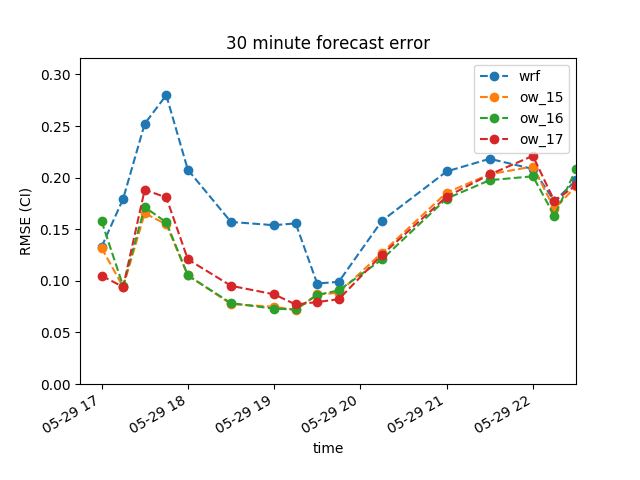

<IPython.core.display.Javascript object>


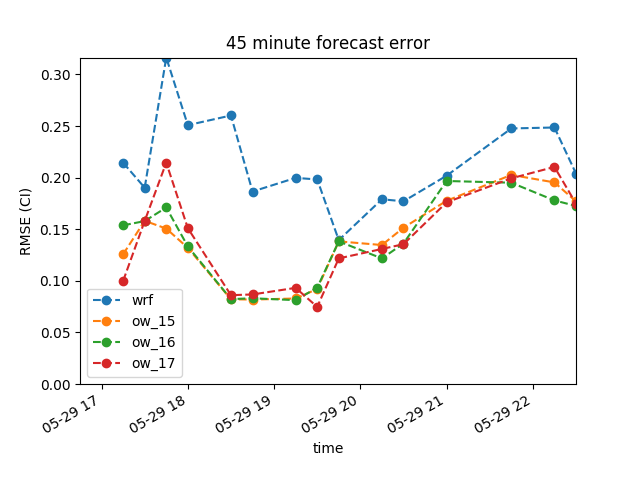

<IPython.core.display.Javascript object>


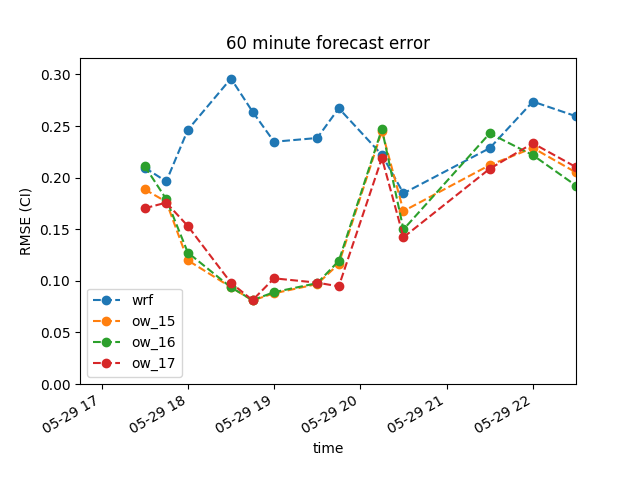

In [136]:
y_max = np.max(list(map(lambda x: x.max().max(), error)))
for hor in [15, 30, 45, 60]:
    plt.figure()
    for aresult in error:
        aresult[hor].dropna().plot(linestyle='--', marker='o')
    (aresult[hor]*np.nan).plot(color='b')
    
#     bare[hor].dropna().plot(linestyle='--')
#     wrf[hor].dropna().plot()
#     ow_4[hor].dropna().plot()
#     ow_8[hor].dropna().plot()
# #     opt_wrf[hor].dropna().plot()
#     #wrf_no_div[60].dropna().plot()
    plt.legend(runs)
    plt.ylim([0, y_max])
    plt.ylabel('RMSE (CI)')
    plt.title(f'{hor} minute forecast error')

<IPython.core.display.Javascript object>


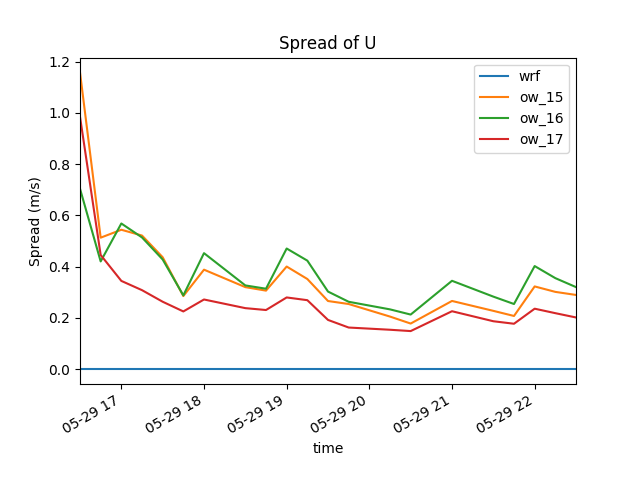

<IPython.core.display.Javascript object>


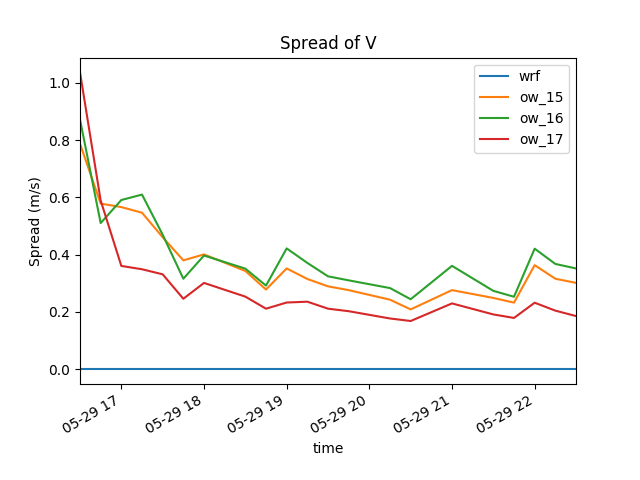

In [137]:
plt.figure()
for aresult in spread_wind:
    aresult['U'].plot()
plt.legend(runs)
plt.title('Spread of U')
plt.ylabel('Spread (m/s)')

plt.figure()
for aresult in spread_wind:
    aresult['V'].plot()
plt.legend(runs)
plt.title('Spread of V')
plt.ylabel('Spread (m/s)')

<IPython.core.display.Javascript object>


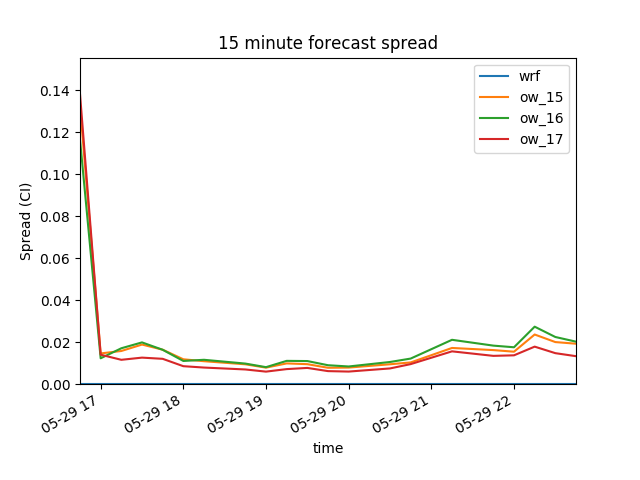

<IPython.core.display.Javascript object>


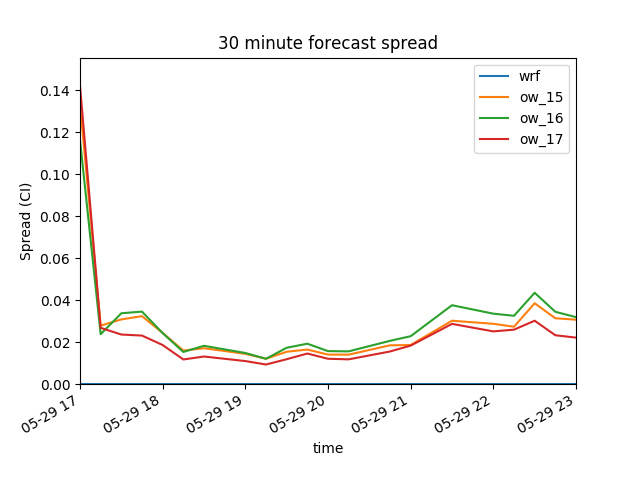

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


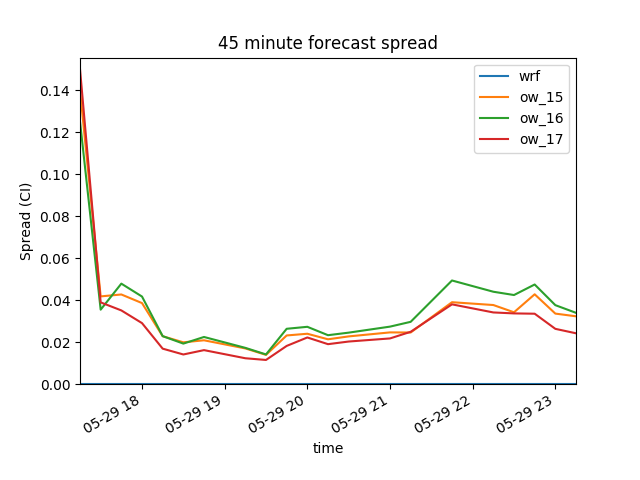

<IPython.core.display.Javascript object>


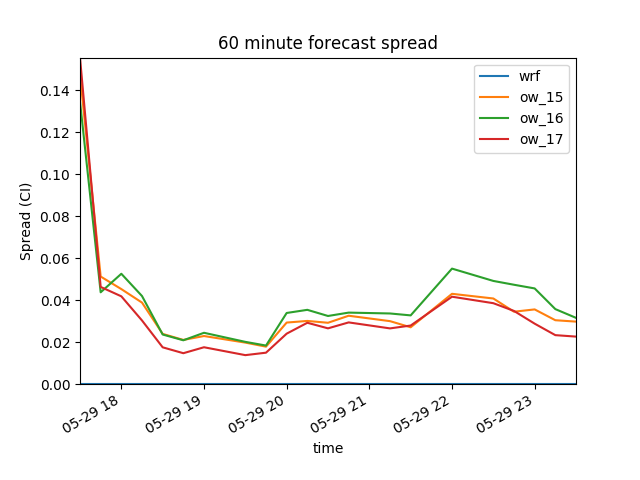

In [138]:
y_max = np.max(list(map(lambda x: x.max().max(), spread_ci)))
for hor in [15, 30, 45, 60]:
    plt.figure()
    for aresult in spread_ci:
        aresult[hor].dropna().plot()
#     bare[hor].dropna().plot(linestyle='--')
#     wrf[hor].dropna().plot()
#     ow_4[hor].dropna().plot()
#     ow_8[hor].dropna().plot()
# #     opt_wrf[hor].dropna().plot()
#     #wrf_no_div[60].dropna().plot()
    plt.legend(runs)
    plt.ylim([0, y_max])
    plt.ylabel('Spread (CI)')
    plt.title(f'{hor} minute forecast spread')

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


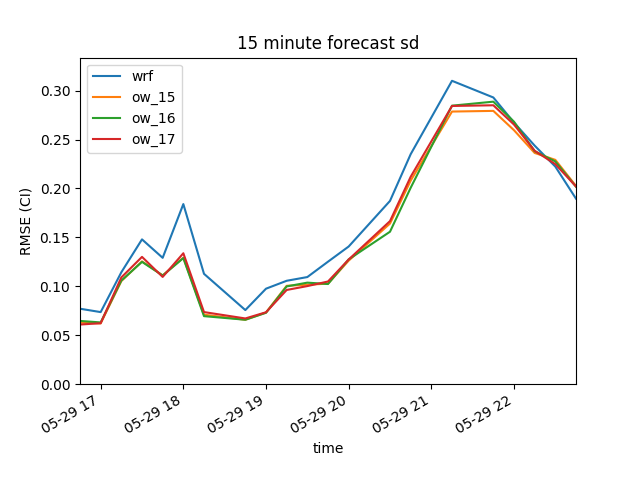

<IPython.core.display.Javascript object>


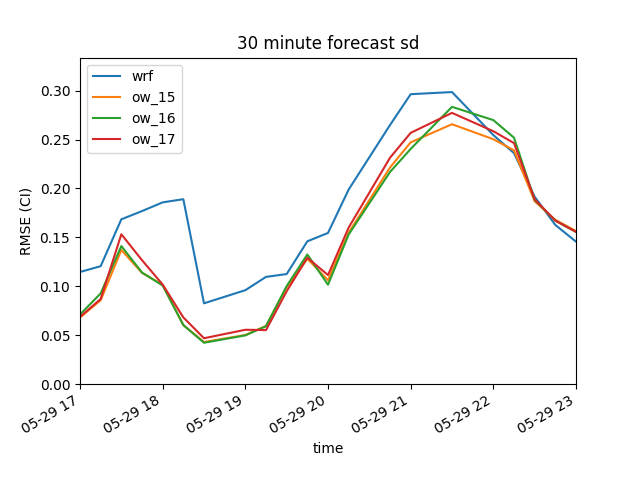

<IPython.core.display.Javascript object>


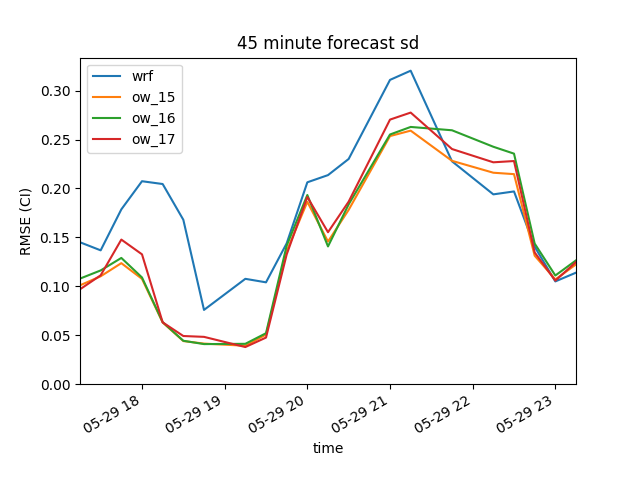

<IPython.core.display.Javascript object>


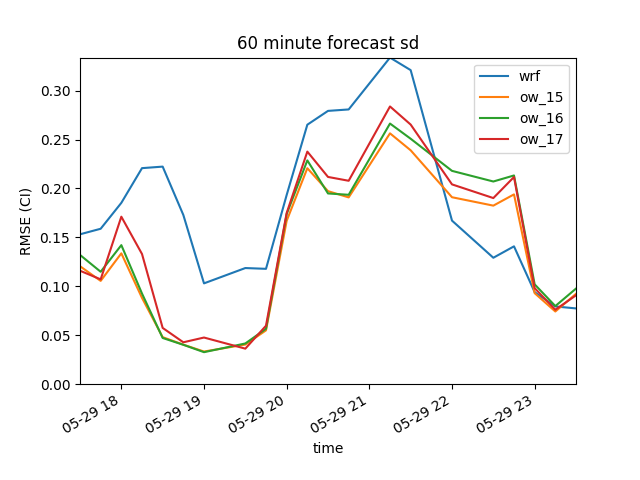

In [139]:
y_max = np.max(list(map(lambda x: x.max().max(), mean_sd_ci)))
for hor in [15, 30, 45, 60]:
    plt.figure()
    for aresult in mean_sd_ci:
        aresult[hor].dropna().plot()
#     bare[hor].dropna().plot(linestyle='--')
#     wrf[hor].dropna().plot()
#     ow_4[hor].dropna().plot()
#     ow_8[hor].dropna().plot()
# #     opt_wrf[hor].dropna().plot()
#     #wrf_no_div[60].dropna().plot()
    plt.legend(runs)
    plt.ylim([0, y_max])
    plt.ylabel('RMSE (CI)')
    plt.title(f'{hor} minute forecast sd')

In [99]:
plt.close('all')

In [46]:
plt.close('all')

In [45]:
for ii in range(len(error)):
    print(runs[ii] + '\n')
    arun = error[ii]
    decrease = wrf - arun
    percent_decrease = decrease/wrf
    print(percent_decrease.mean(), '\n')

bare

15    0.205957
30    0.240039
45    0.286303
60    0.335819
dtype: float64 

wrf

15    0.0
30    0.0
45    0.0
60    0.0
dtype: float64 

opt_flow

15   -0.217465
30   -0.024060
45    0.019316
60    0.121500
dtype: float64 

ow_13

15    0.249678
30    0.293745
45    0.358004
60    0.392905
dtype: float64 



In [30]:
for ii in range(len(error)):
    print(runs[ii] + '\n')
    arun = error[ii]
    decrease = wrf - arun
    percent_decrease = decrease/wrf
    print(percent_decrease.mean(), '\n')

bare

15    0.235504
30    0.177846
45    0.192675
60    0.235610
dtype: float64 

wrf

15    0.0
30    0.0
45    0.0
60    0.0
dtype: float64 

ow_8

15    0.210706
30    0.151581
45    0.172723
60    0.216235
dtype: float64 

ow_10

15    0.210115
30    0.167532
45    0.163033
60    0.220009
dtype: float64 

ow_11

15    0.253236
30    0.220105
45    0.250540
60    0.288602
dtype: float64 

ow_12

15    0.254197
30    0.213997
45    0.246642
60    0.287891
dtype: float64 

ow_13

15    0.280856
30    0.250191
45    0.282893
60    0.314126
dtype: float64 



In [2]:
importlib.reload(ar)
run = 'ow_1'

full_day = ar.return_day(year, month, day, run)
truth = xr.open_dataset(f'/home2/travis/data/{year:04}/{month:02}/{day:02}/data.nc')

full_day.attrs['we_er_min'] = 240 # these are based on sensor locations.
full_day.attrs['we_er_max'] = 280
full_day.attrs['sn_er_min'] = 32
full_day.attrs['sn_er_max'] = 88

truth.attrs['we_er_min'] = 240
truth.attrs['we_er_max'] = 280
truth.attrs['sn_er_min'] = 32
truth.attrs['sn_er_max'] = 88

NameError: name 'year' is not defined

In [ ]:
full_day.horizon

In [20]:
this = xr.open_dataset(
    '/home/travis/results/2014/05/29/opt_wrf_000/20140529_1630Z.nc')

In [22]:
this.west_east

<xarray.DataArray 'west_east' (west_east: 373)>
array([ 237.5 ,  237.75,  238.  , ...,  330.  ,  330.25,  330.5 ], dtype=float32)
Coordinates:
  * west_east  (west_east) float32 237.5 237.75 238.0 238.25 238.5 238.75 ...

In [24]:
we_slice = slice(this.west_east[50], this.west_east[60])
sn_slice = slice(this.south_north[50], this.south_north[60])

In [28]:
this.sel(west_east=we_slice, south_north=sn_slice,
         west_east_stag=we_slice, south_north_stag=sn_slice)

<xarray.Dataset>
Dimensions:           (ensemble_number: 20, south_north: 11, south_north_stag: 11, time: 5, west_east: 11, west_east_stag: 11)
Coordinates:
  * west_east         (west_east) float32 250.0 250.25 250.5 250.75 251.0 ...
  * south_north       (south_north) float32 -60.25 -60.0 -59.75 -59.5 -59.25 ...
  * west_east_stag    (west_east_stag) float32 250.0 250.25 250.5 250.75 ...
  * south_north_stag  (south_north_stag) float32 -60.25 -60.0 -59.75 -59.5 ...
  * time              (time) datetime64[ns] 2014-05-29T16:30:00 ...
  * ensemble_number   (ensemble_number) uint32 0 1 2 3 4 5 6 7 8 9 10 11 12 ...
Data variables:
    ci                (time, ensemble_number, south_north, west_east) float32 0.0892617 ...
    U                 (time, ensemble_number, south_north, west_east_stag) float32 0.708554 ...
    V                 (time, ensemble_number, south_north_stag, west_east) float32 17.6633 ...
Attributes:
    year:                 2014
    month:                5
    day:  

<IPython.core.display.Javascript object>


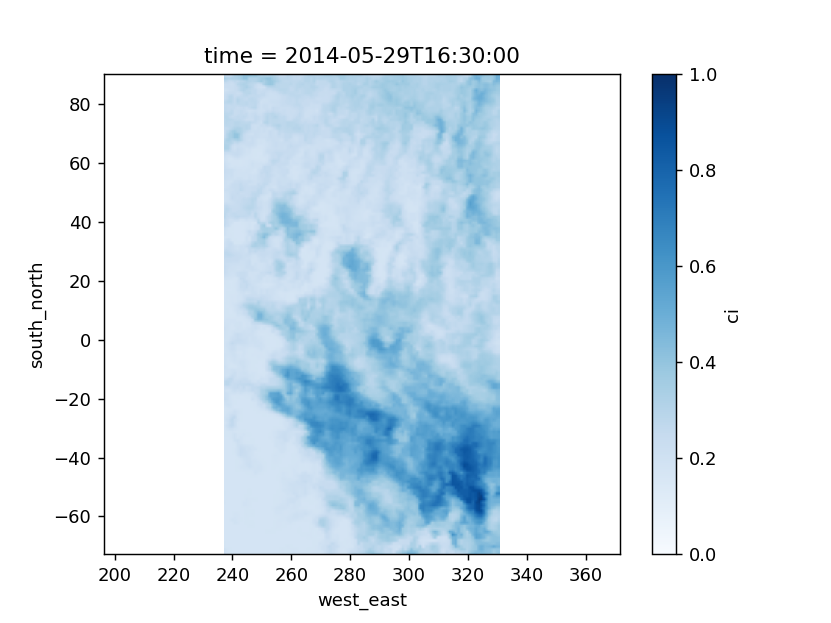

<IPython.core.display.Javascript object>


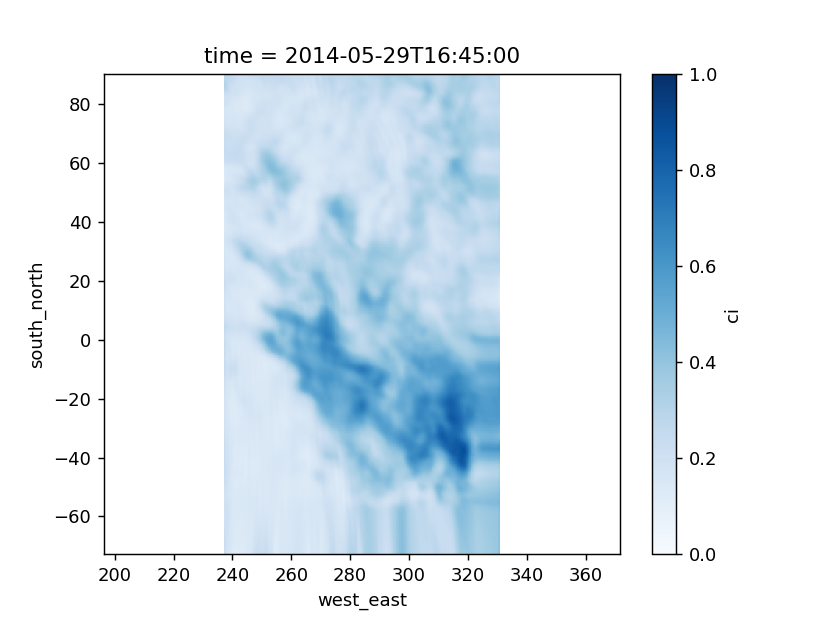

<IPython.core.display.Javascript object>


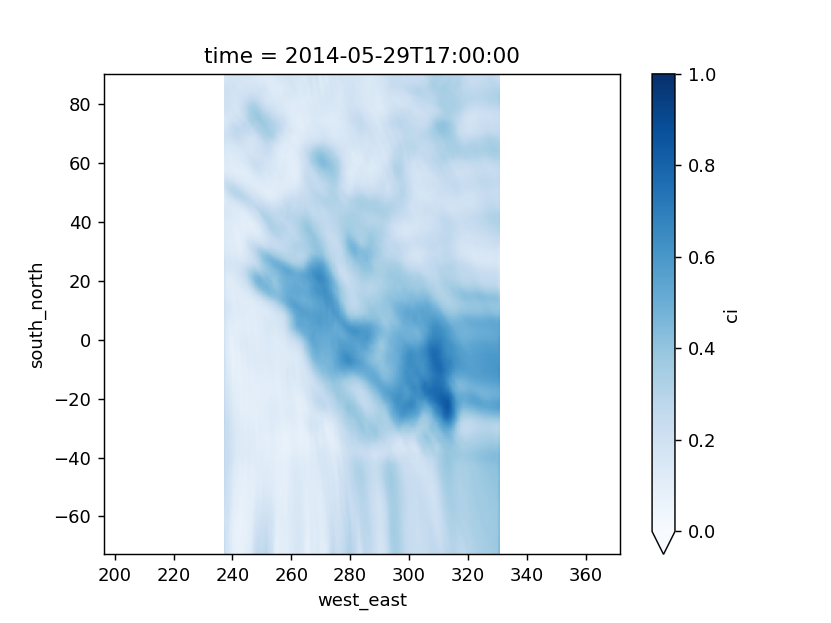

<IPython.core.display.Javascript object>


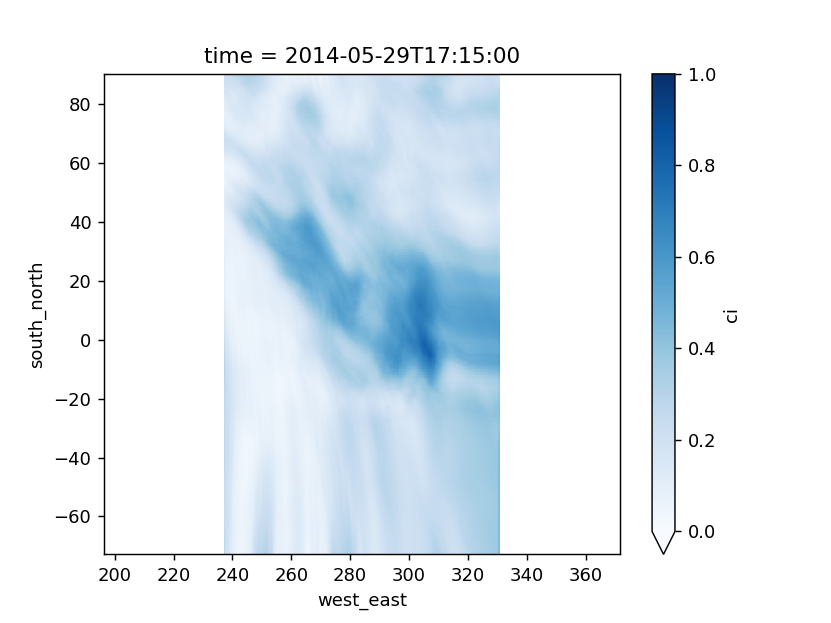

<IPython.core.display.Javascript object>


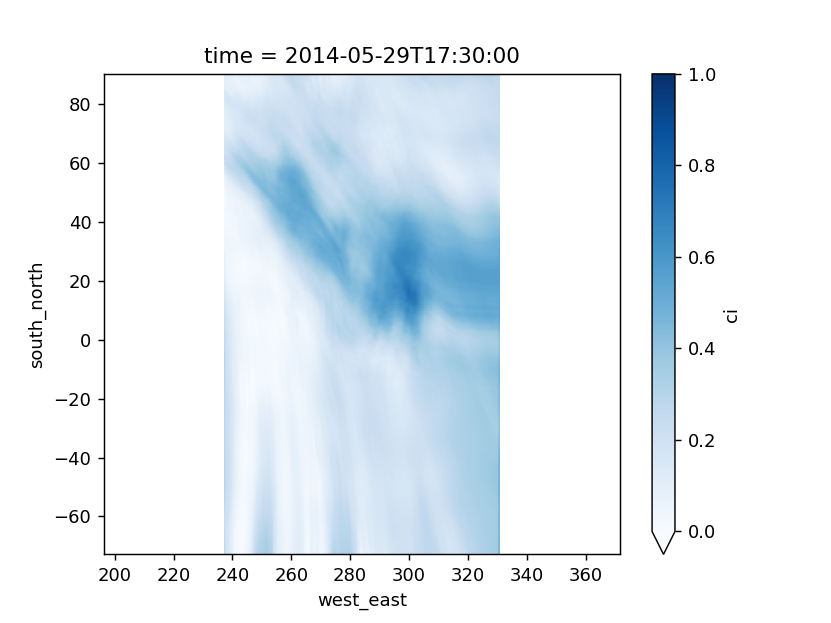

In [73]:
for i in range(5):
    plt.figure()
    this['ci'].isel(time=i).mean(
        dim='ensemble_number').plot(cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    this['U']

<IPython.core.display.Javascript object>


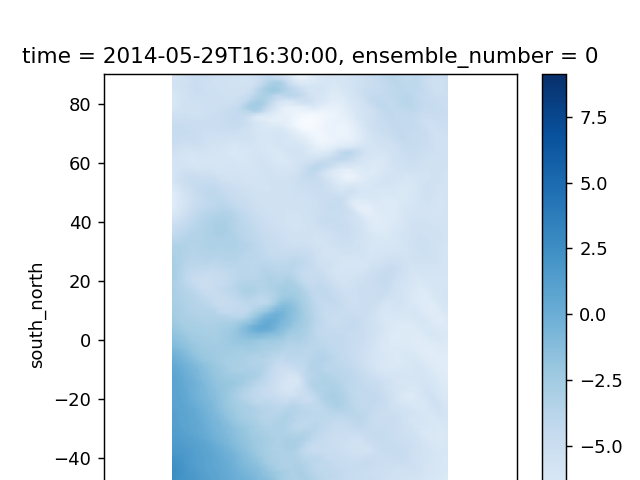

<IPython.core.display.Javascript object>


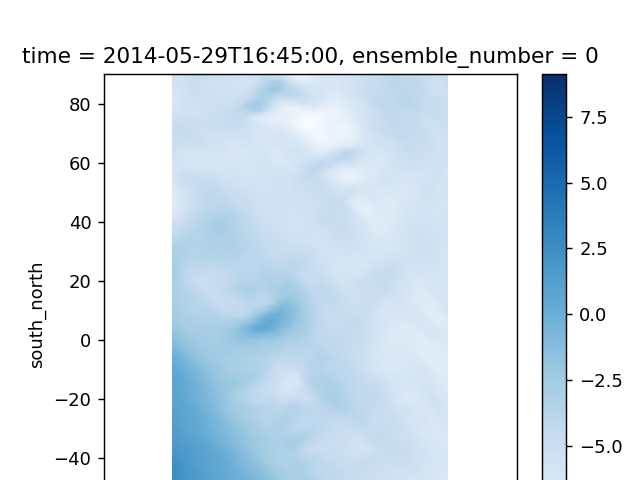

<IPython.core.display.Javascript object>


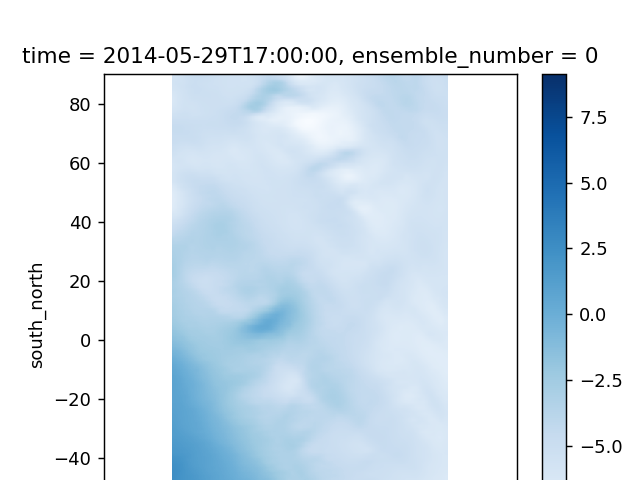

<IPython.core.display.Javascript object>


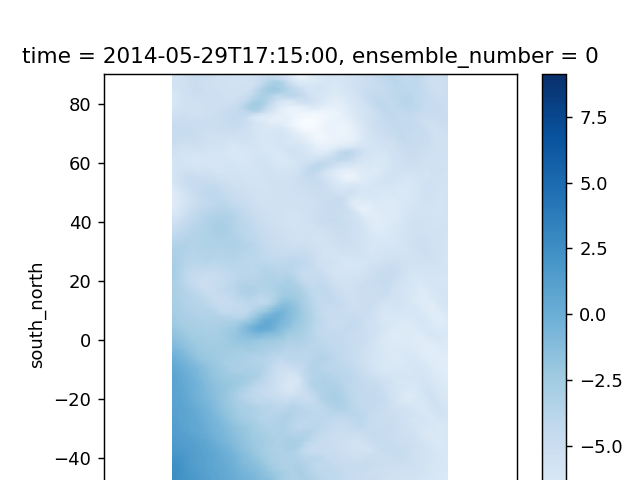

<IPython.core.display.Javascript object>


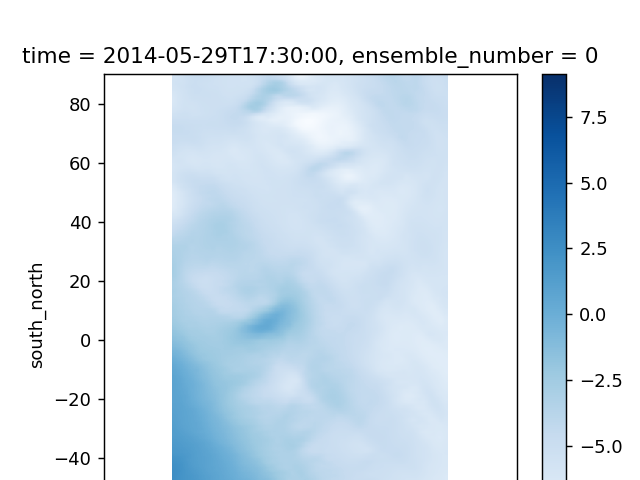

In [28]:
for i in range(5):
    plt.figure()
    im = this['U'].isel(time=i).isel(
        ensemble_number=0).plot(cmap='Blues')
    plt.axis('equal')
    plt.colorbar(im)

In [7]:
truth.south_north

<xarray.DataArray 'south_north' (south_north: 1445)>
array([-118.  , -117.75, -117.5 , ...,  242.5 ,  242.75,  243.  ])
Coordinates:
  * south_north  (south_north) float64 -118.0 -117.8 -117.5 -117.2 -117.0 ...

In [12]:
255/4

63.75

In [13]:
161/4

40.25

In [11]:
truth_ed

<xarray.Dataset>
Dimensions:      (sn_stag: 1446, south_north: 225, time: 21, time_wind: 8, we_stag: 1446, west_east: 161)
Coordinates:
  * west_east    (west_east) float64 240.0 240.2 240.5 240.8 241.0 241.2 ...
  * south_north  (south_north) float64 32.0 32.25 32.5 32.75 33.0 33.25 33.5 ...
  * we_stag      (we_stag) float64 79.88 80.12 80.38 80.62 80.88 81.12 81.38 ...
  * sn_stag      (sn_stag) float64 -118.1 -117.9 -117.6 -117.4 -117.1 -116.9 ...
  * time         (time) datetime64[ns] 2014-05-29T16:30:00 ...
  * time_wind    (time_wind) datetime64[ns] 2014-05-29T16:00:00 ...
Data variables:
    ci           (time, south_north, west_east) float64 0.2271 0.2235 0.2199 ...
    U            (time_wind, south_north, we_stag) float64 2.277 2.319 2.361 ...
    V            (time_wind, sn_stag, west_east) float64 16.88 16.86 16.85 ...
Attributes:
    we_er_min:  240
    we_er_max:  280
    sn_er_min:  32
    sn_er_max:  88

In [10]:
truth_ed = ar.return_error_domain(truth)

In [132]:
fd_mean = ar.return_ens_mean(full_day)

In [133]:
fd_m_ed = ar.return_error_domain(fd_mean)

In [134]:
full_day_err_domain = ar.return_ens_mean(ar.return_error_domain(full_day))

In [135]:
analy = ar.return_horizon(fd_m_ed, 0)
fore15 = ar.return_horizon(fd_m_ed, 15)
fore30 = ar.return_horizon(fd_m_ed, 30)
fore45 = ar.return_horizon(fd_m_ed, 45)
fore60 = ar.return_horizon(fd_m_ed, 60)

In [136]:
import functools

In [137]:
times = functools.reduce(np.intersect1d, (analy.time,
                                          fore15.time,
                                          fore30.time,
                                          fore45.time,
                                          fore60.time))

<IPython.core.display.Javascript object>


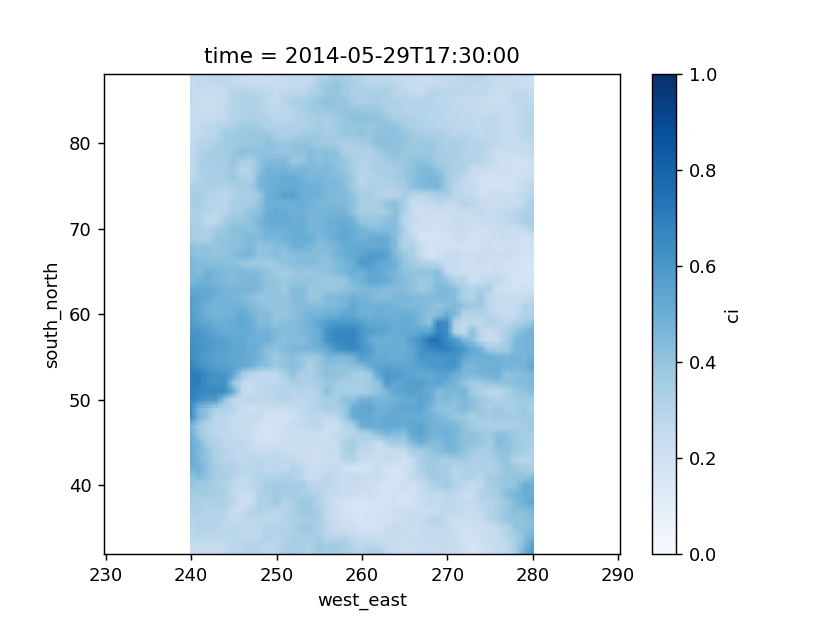

<IPython.core.display.Javascript object>


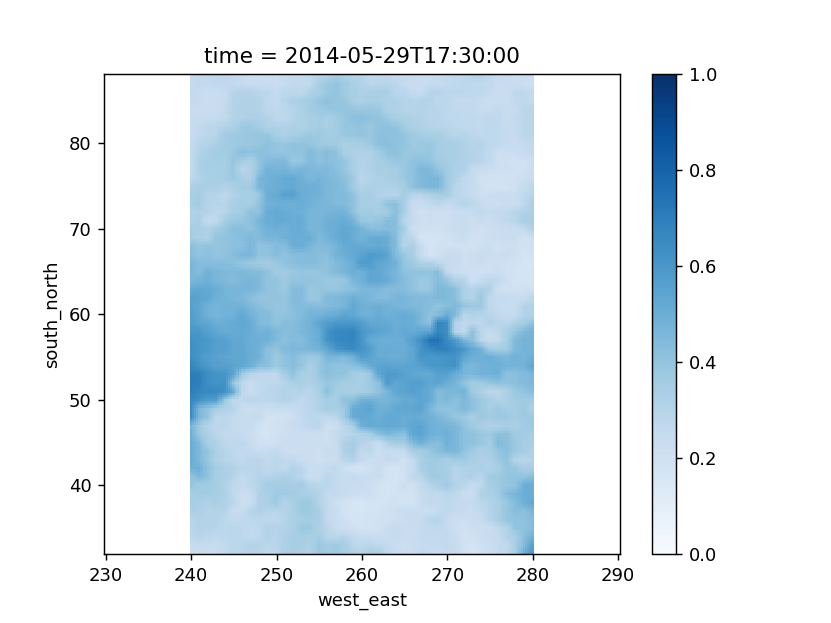

<IPython.core.display.Javascript object>


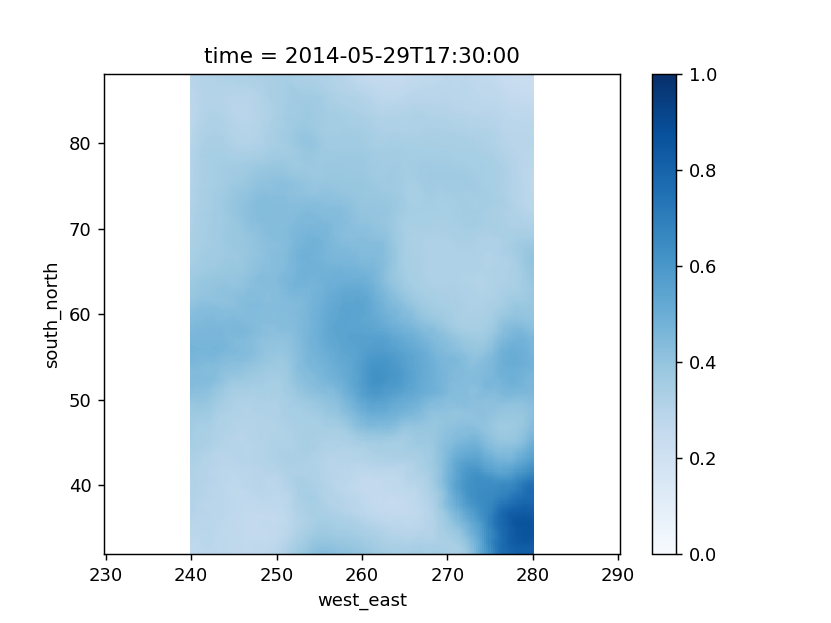

<IPython.core.display.Javascript object>


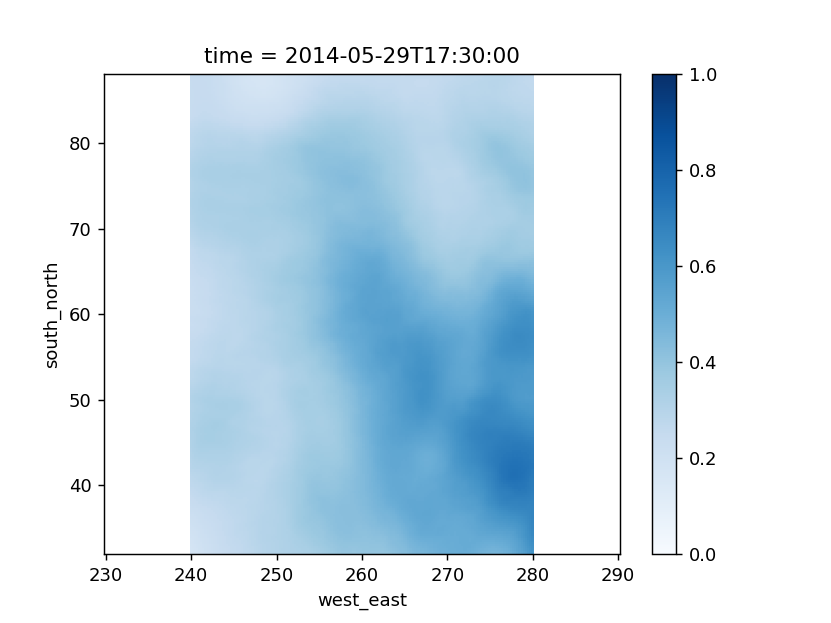

<IPython.core.display.Javascript object>


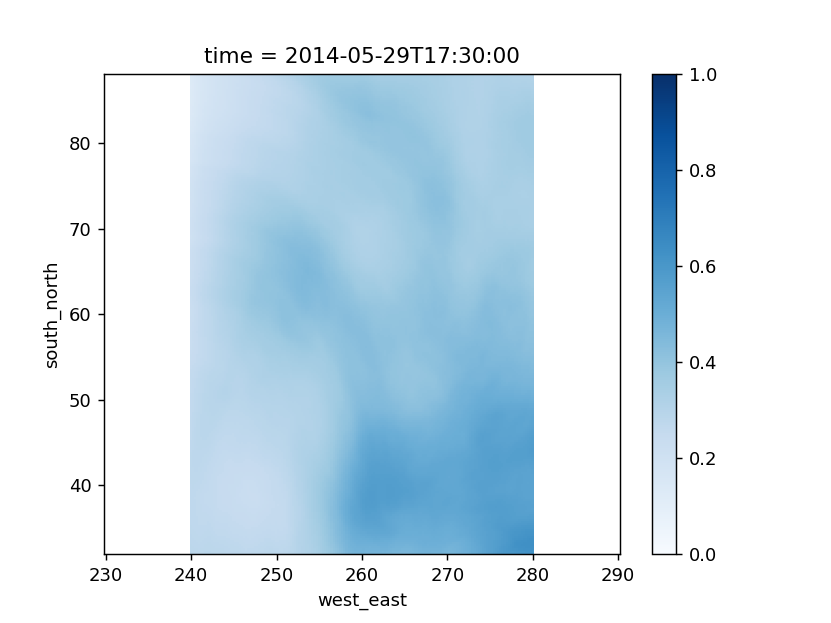

<IPython.core.display.Javascript object>


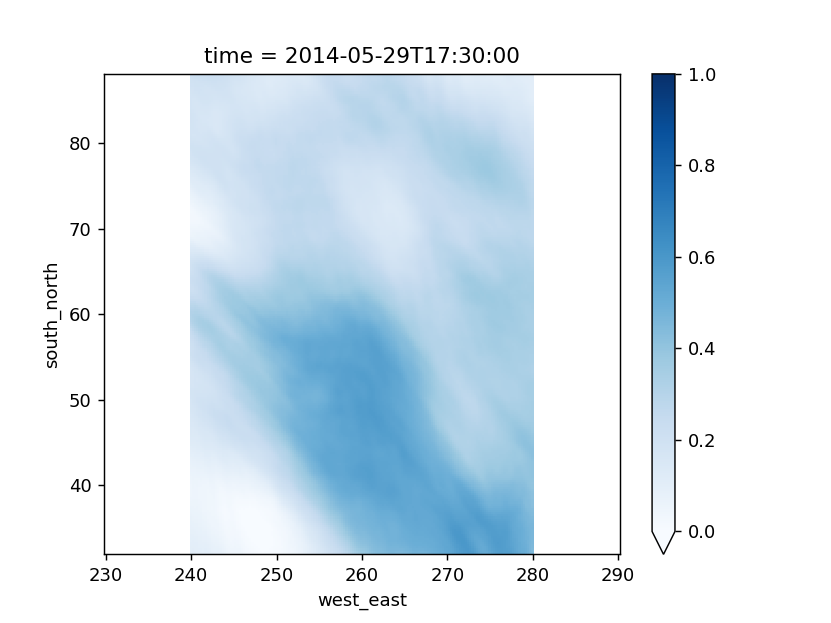

<IPython.core.display.Javascript object>


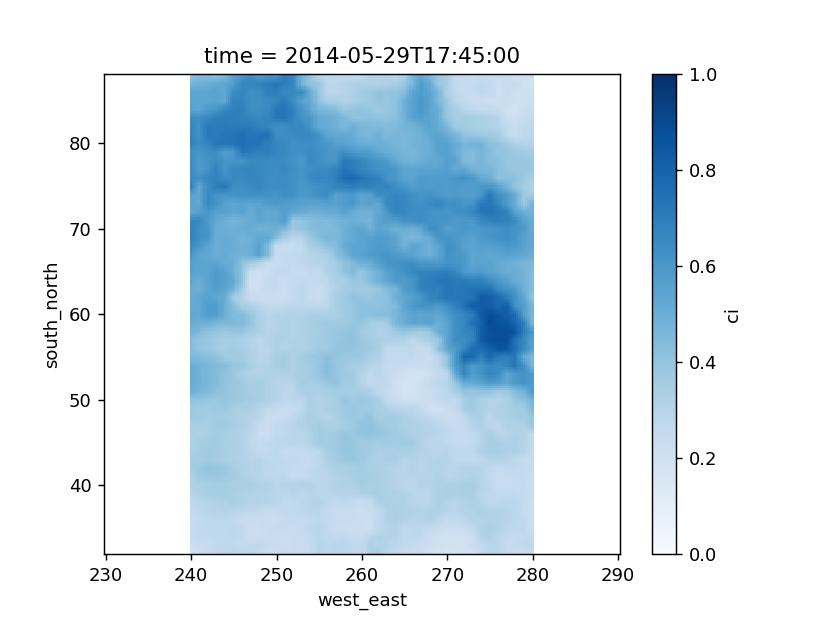

<IPython.core.display.Javascript object>


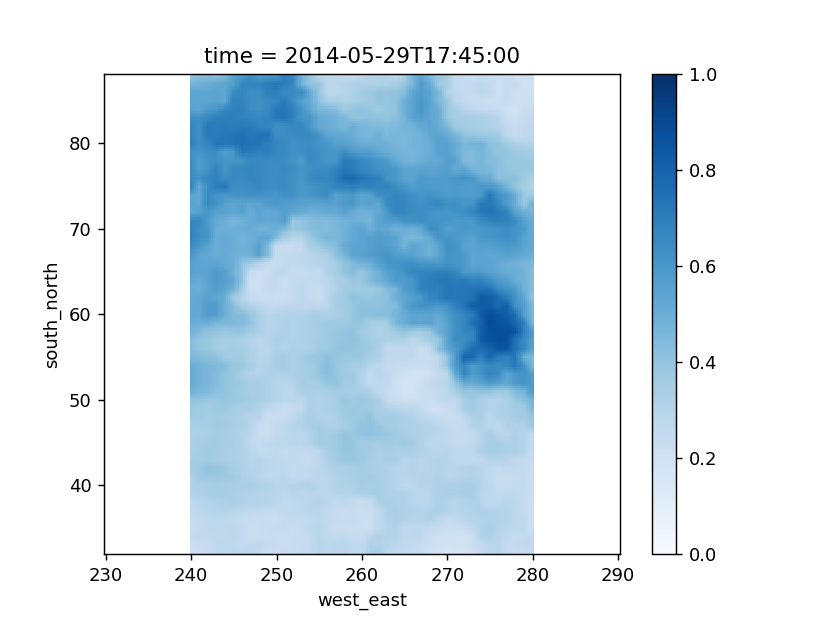

<IPython.core.display.Javascript object>


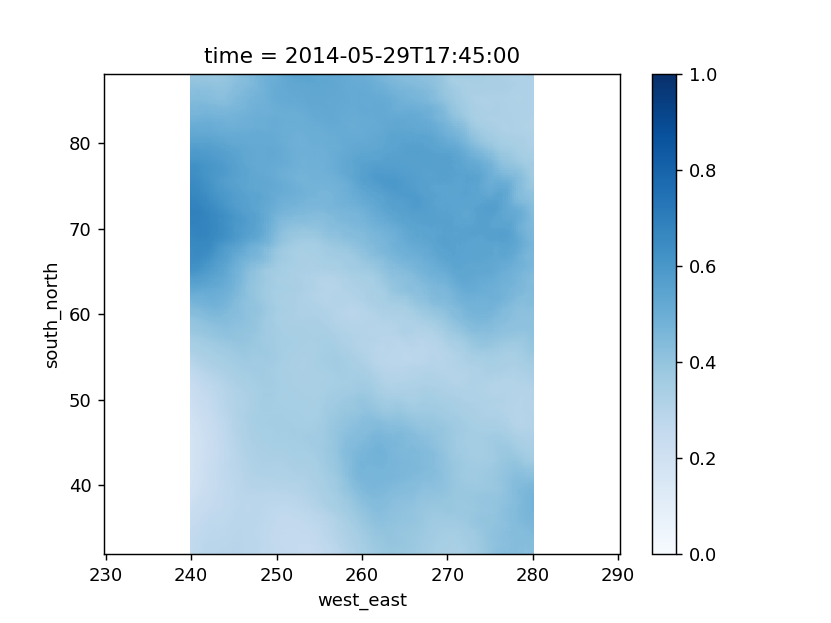

<IPython.core.display.Javascript object>


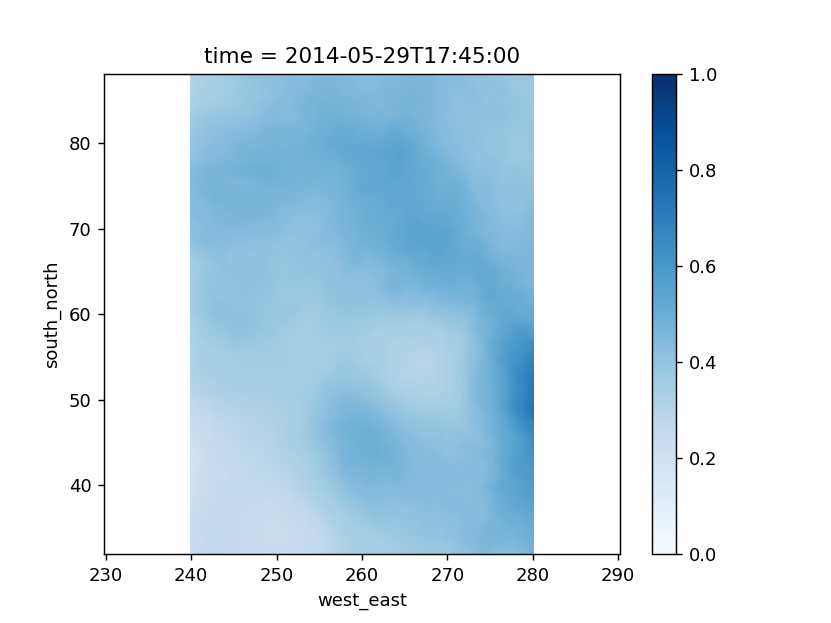

<IPython.core.display.Javascript object>


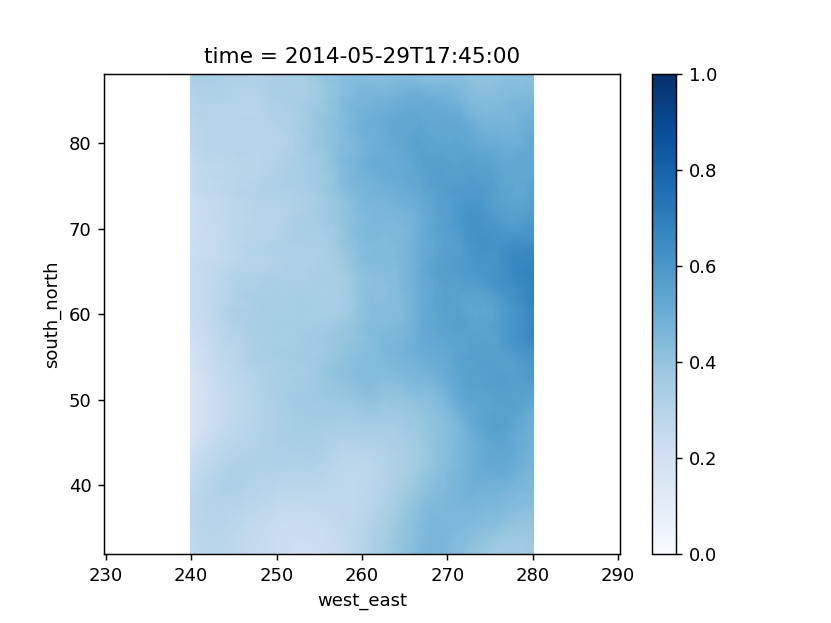

<IPython.core.display.Javascript object>


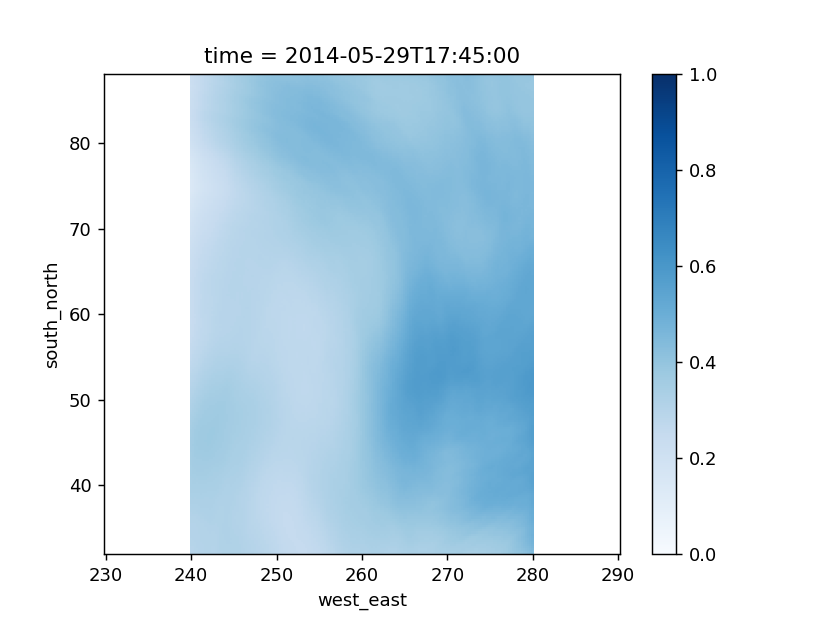

<IPython.core.display.Javascript object>


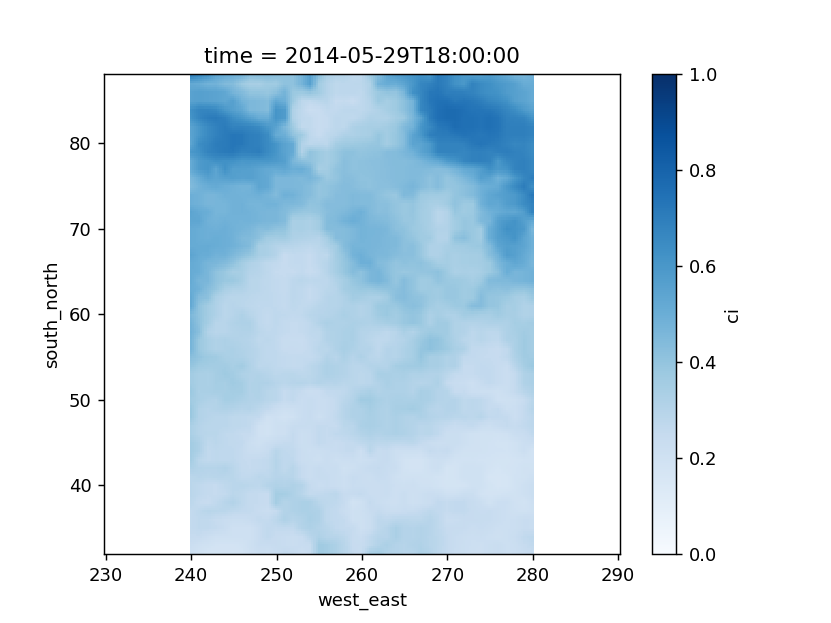

<IPython.core.display.Javascript object>


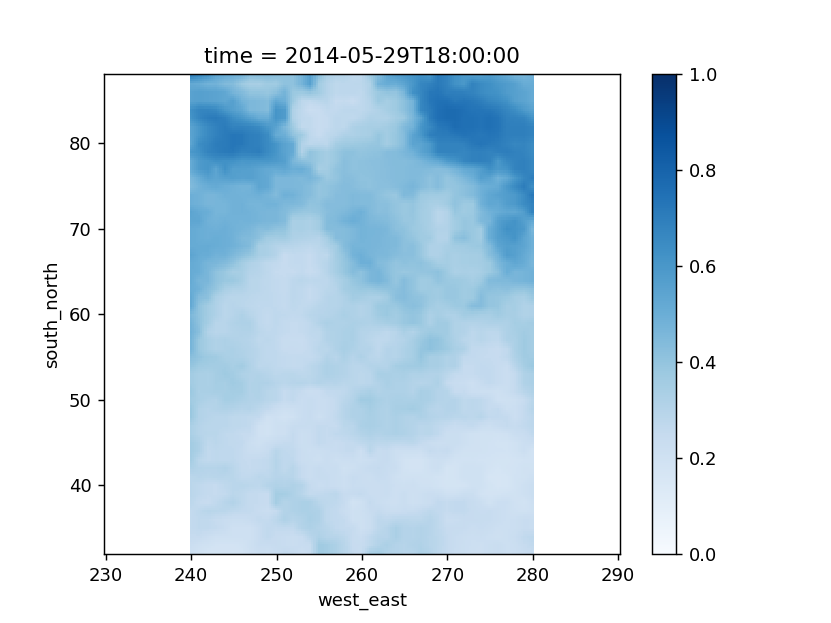

<IPython.core.display.Javascript object>


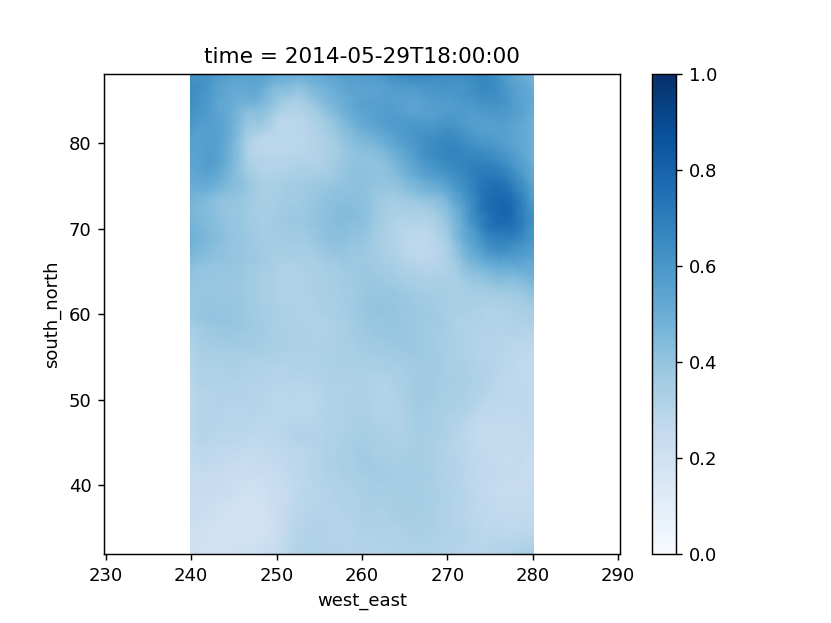

<IPython.core.display.Javascript object>


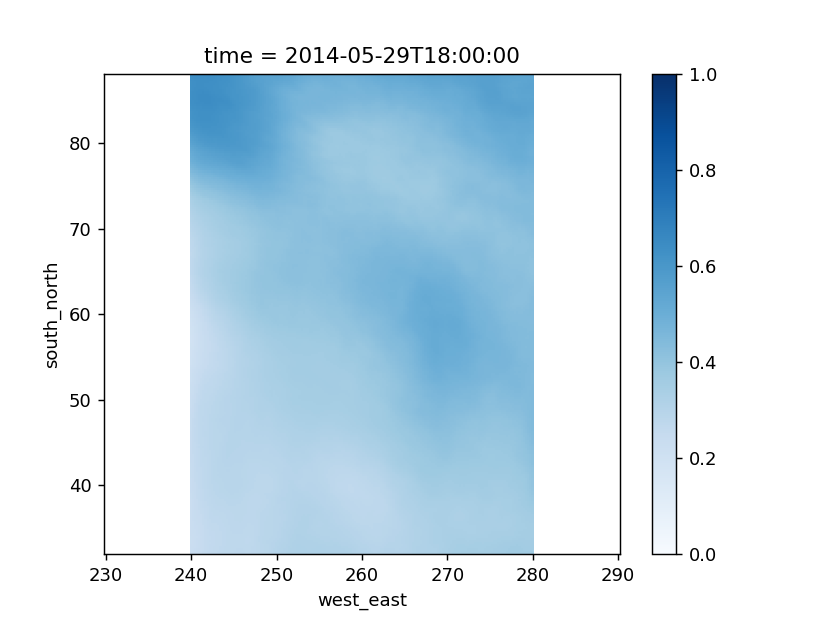

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


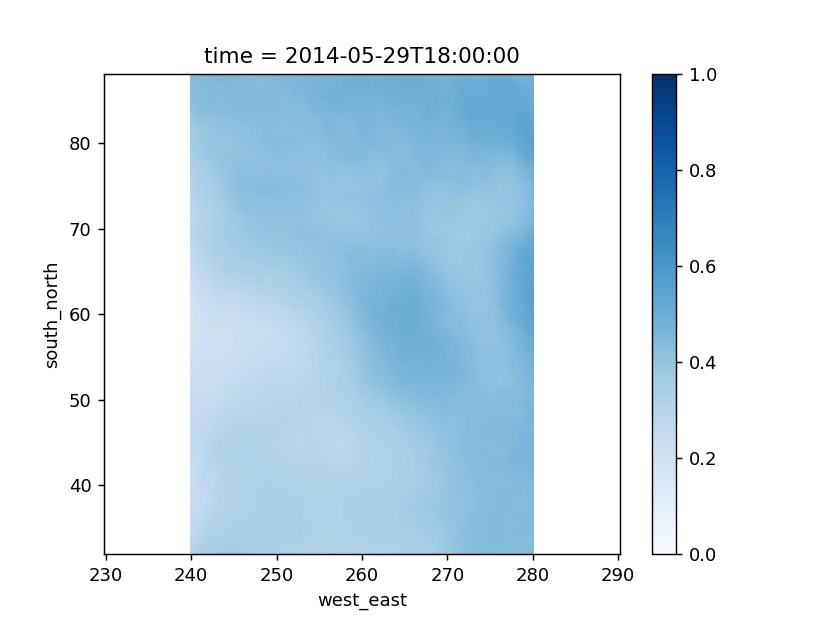

<IPython.core.display.Javascript object>


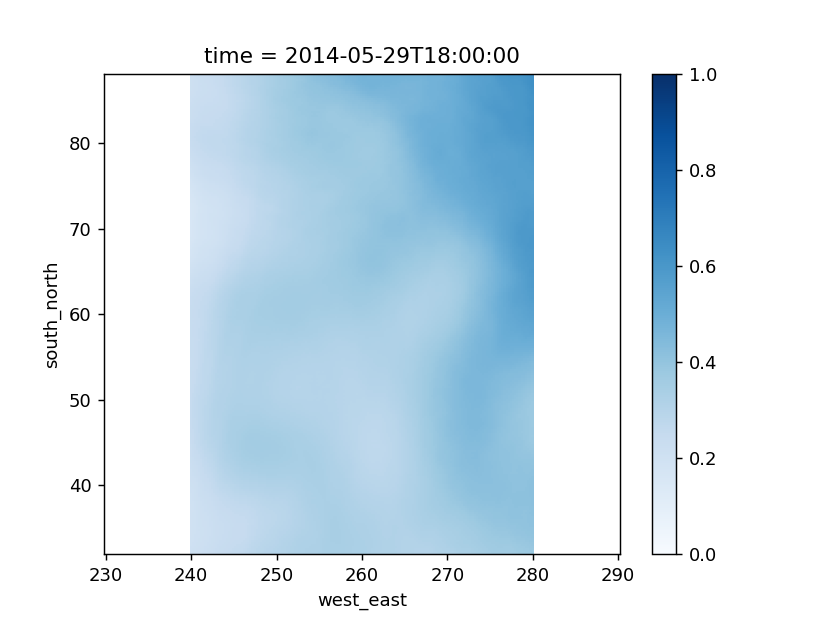

<IPython.core.display.Javascript object>


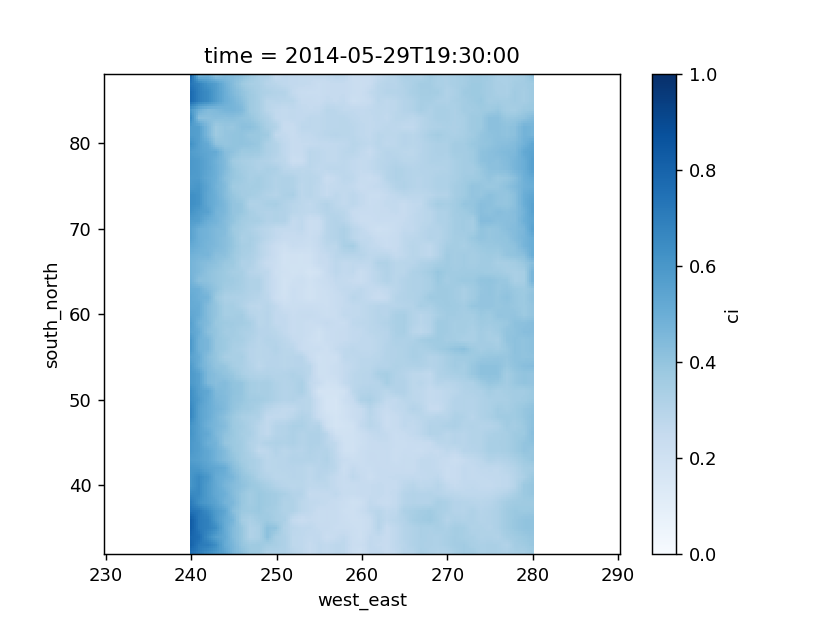

<IPython.core.display.Javascript object>


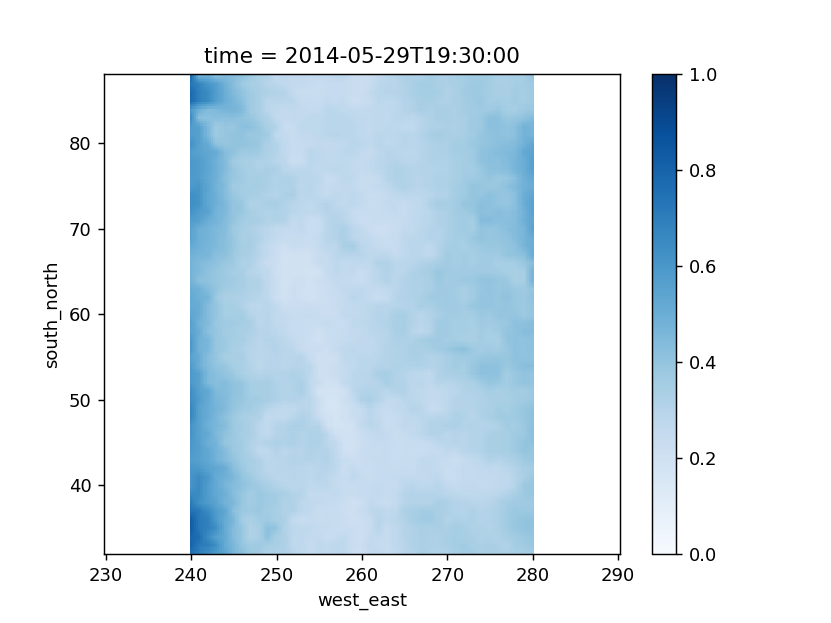

<IPython.core.display.Javascript object>


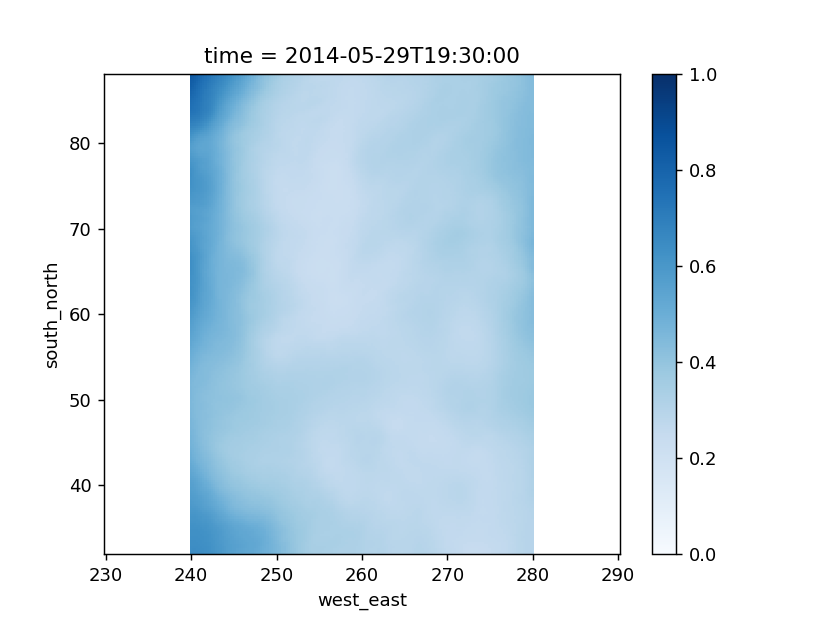

<IPython.core.display.Javascript object>


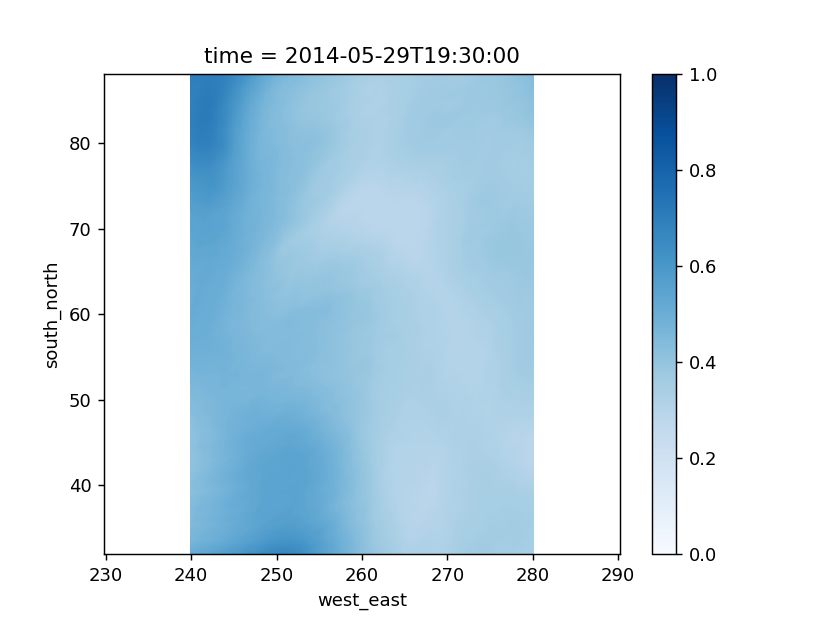

<IPython.core.display.Javascript object>


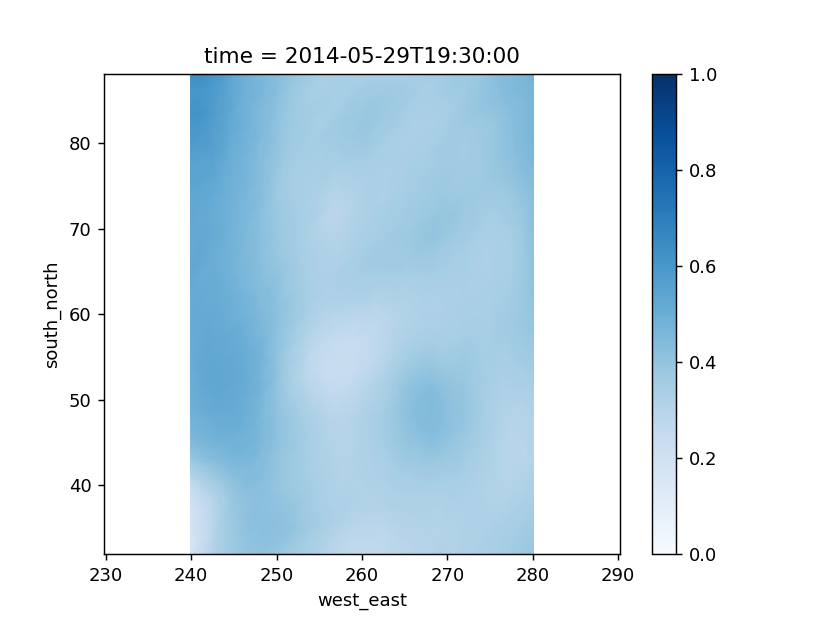

<IPython.core.display.Javascript object>


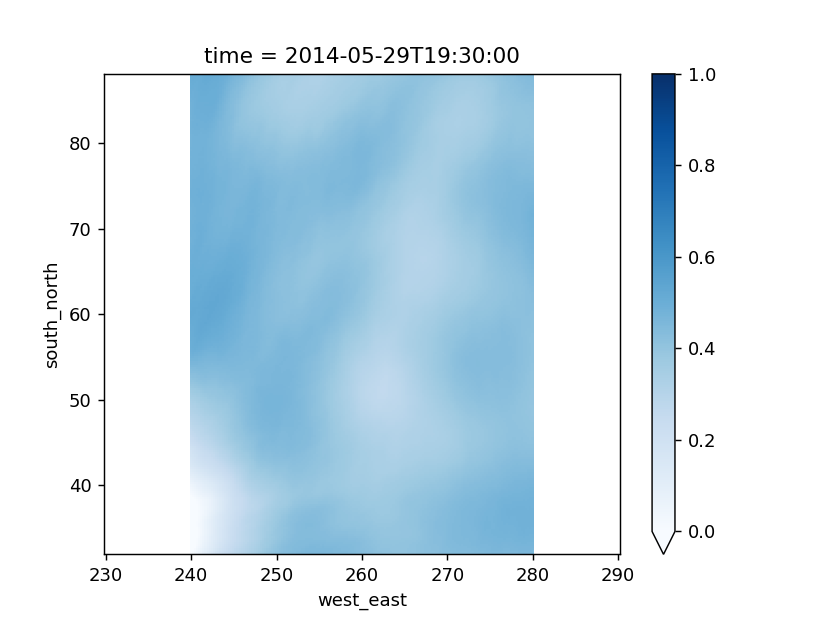

<IPython.core.display.Javascript object>


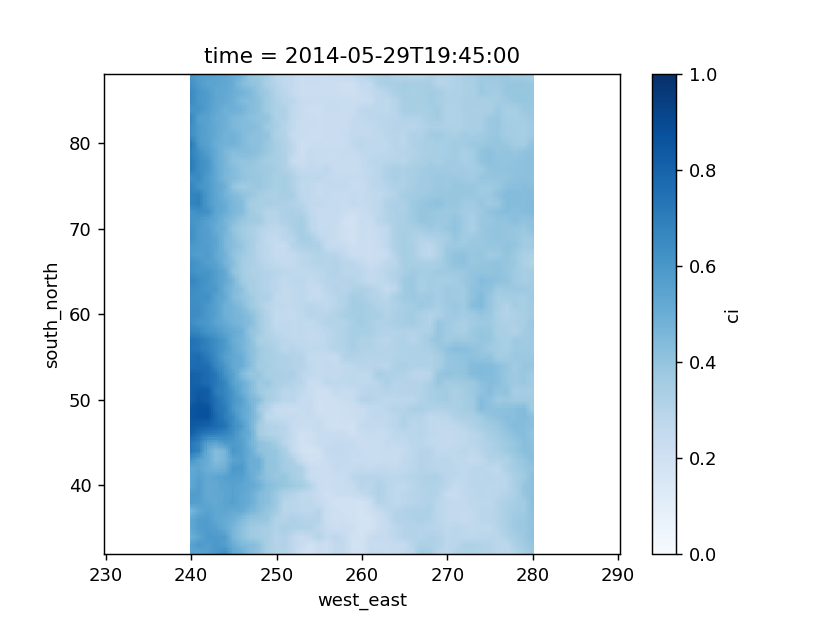

<IPython.core.display.Javascript object>


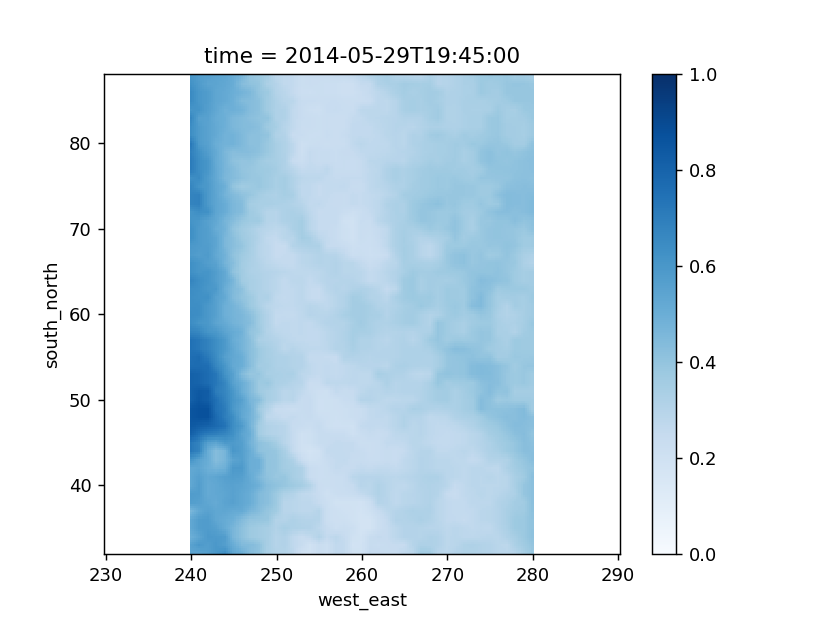

<IPython.core.display.Javascript object>


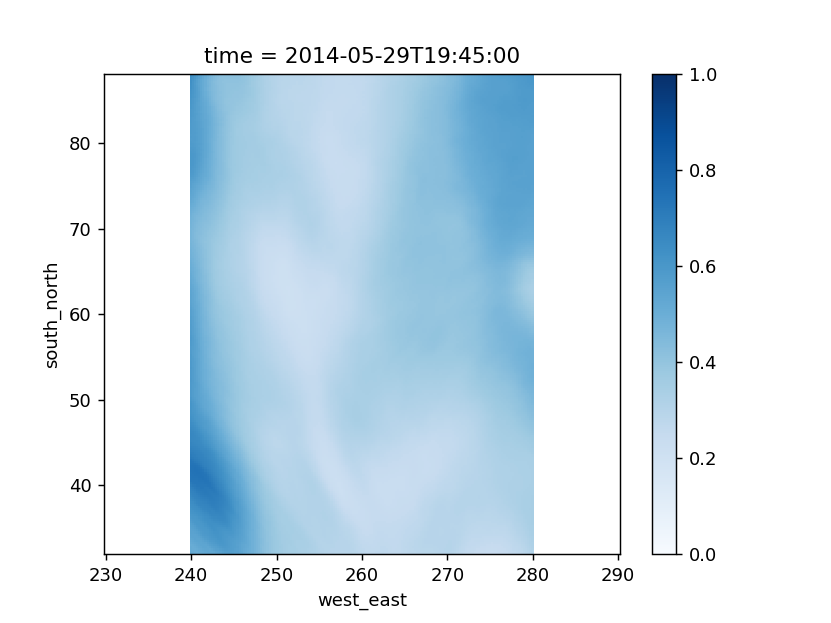

<IPython.core.display.Javascript object>


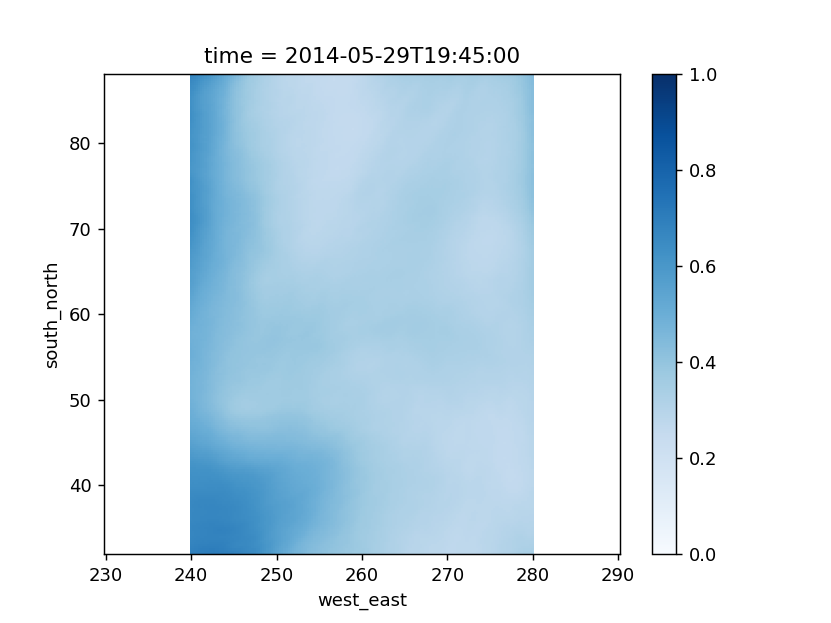

<IPython.core.display.Javascript object>


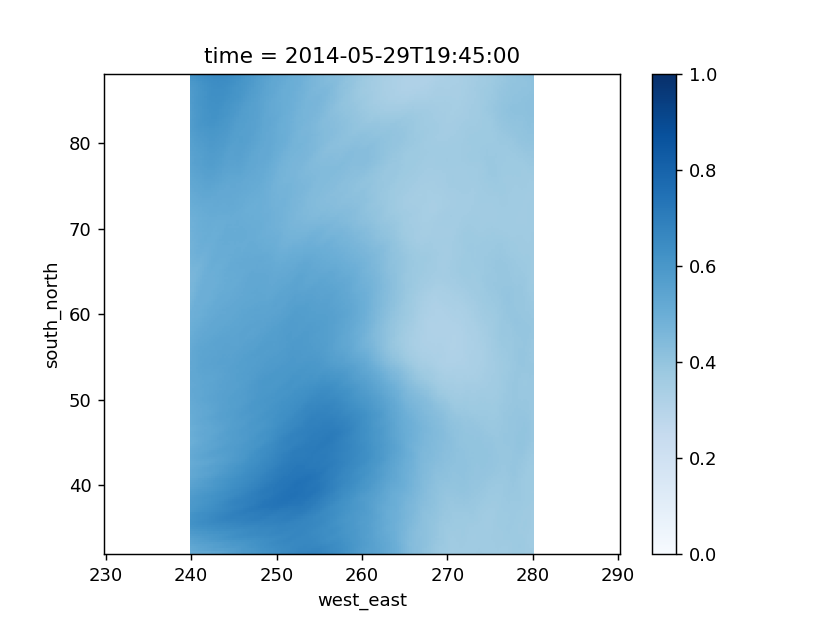

<IPython.core.display.Javascript object>


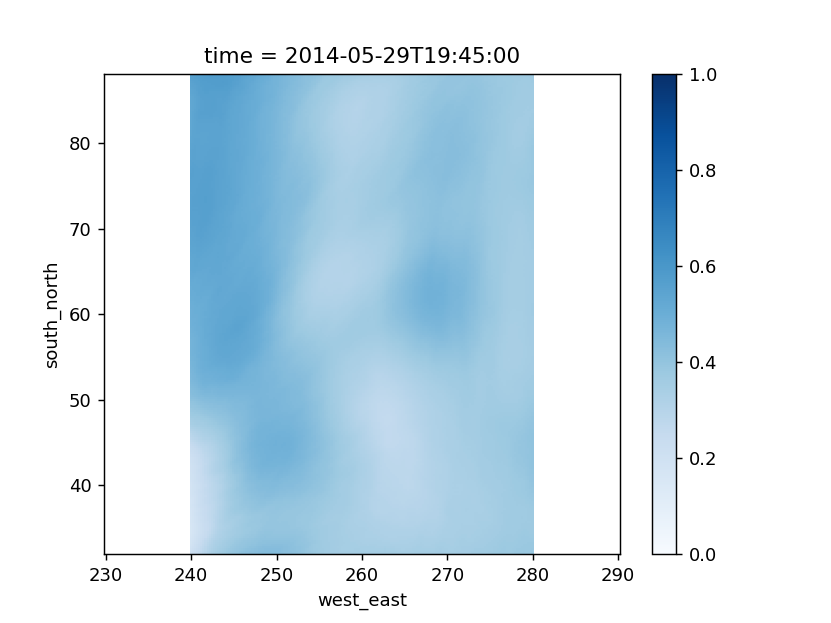

In [138]:
for t in times:
    plt.figure()
    truth_ed.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    analy.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore15.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore30.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore45.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore60.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')

In [140]:
times = functools.reduce(np.intersect1d, (analy.time,
                                          fore60.time))

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


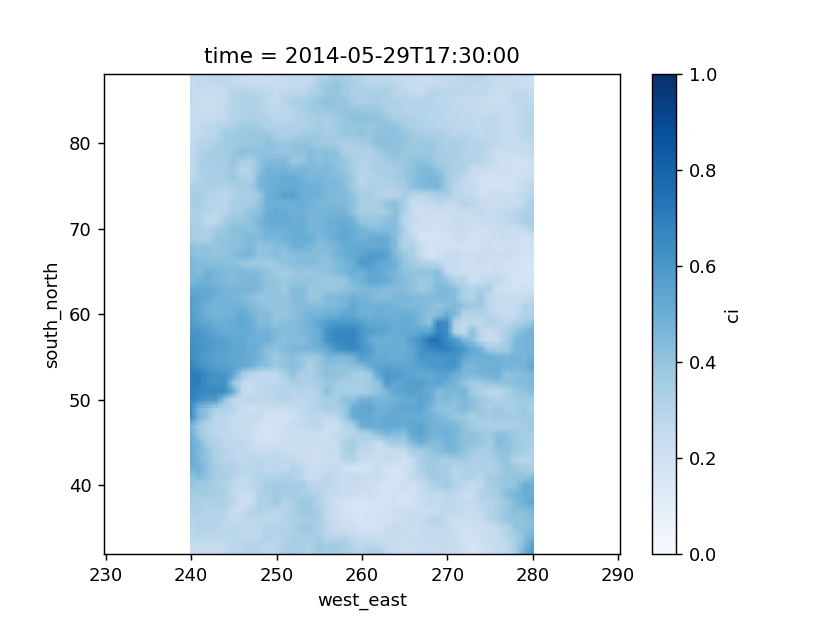

<IPython.core.display.Javascript object>


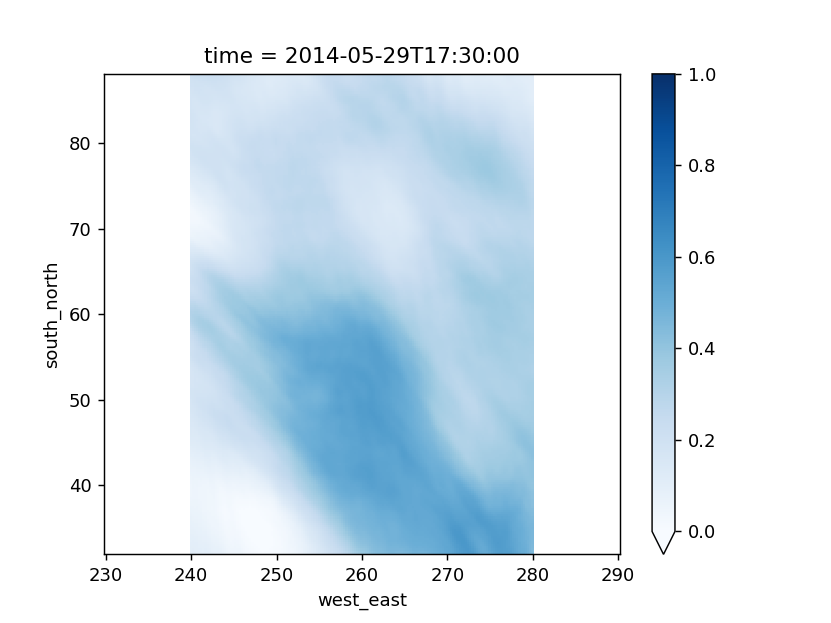

<IPython.core.display.Javascript object>


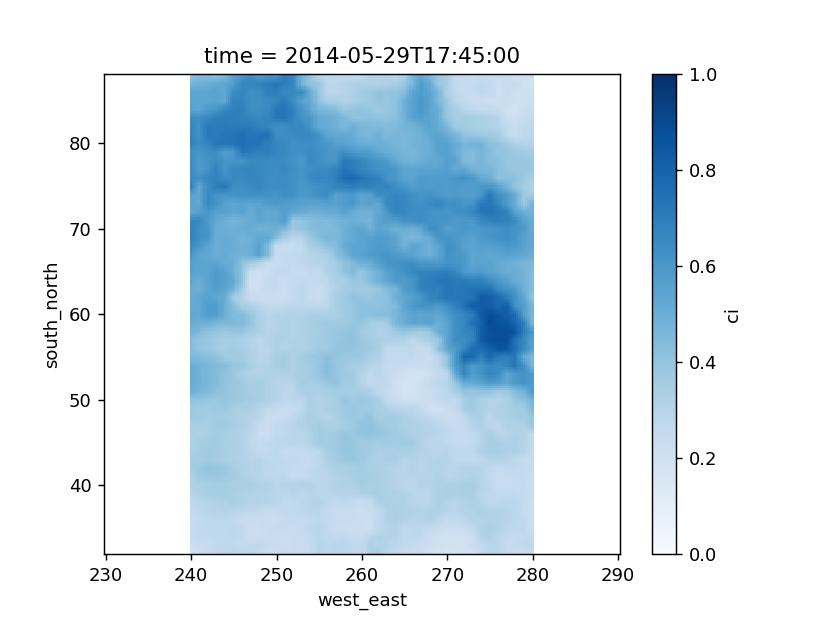

<IPython.core.display.Javascript object>


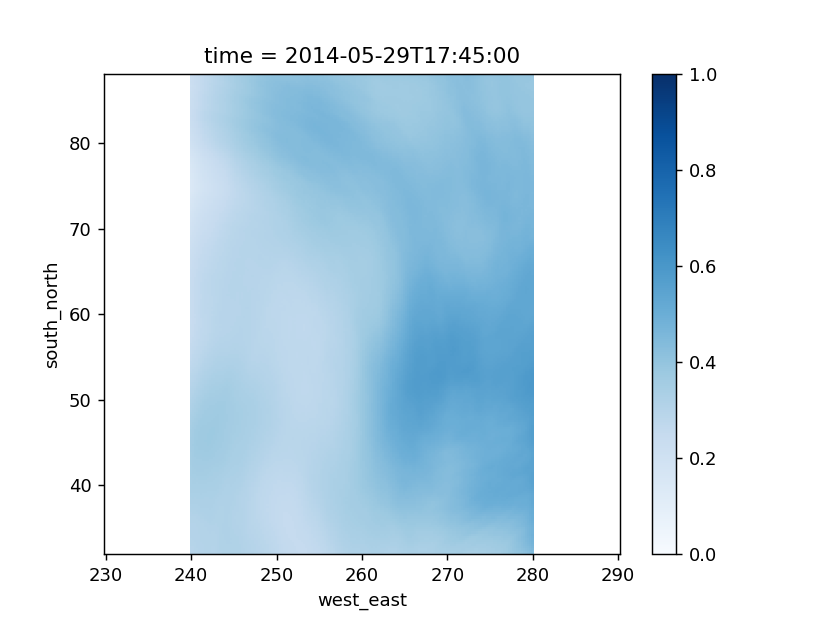

<IPython.core.display.Javascript object>


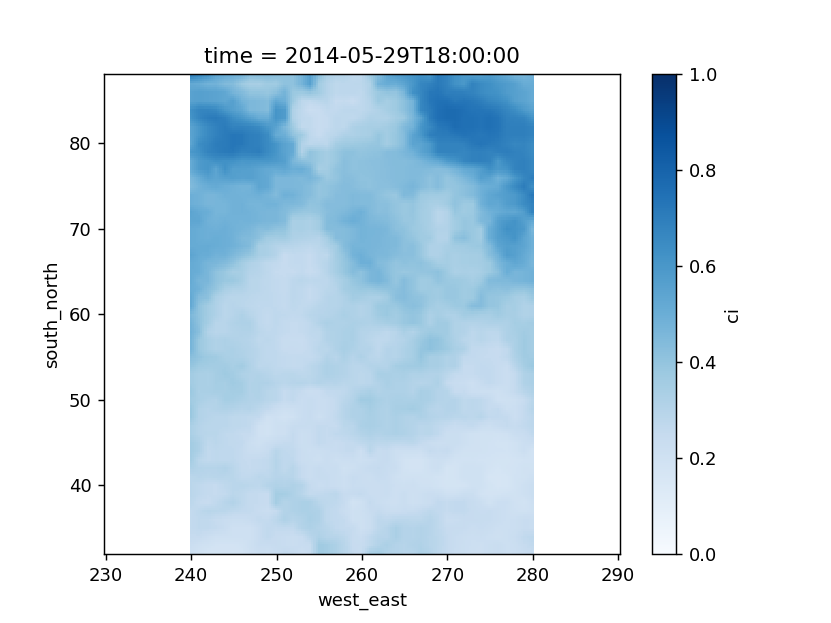

<IPython.core.display.Javascript object>


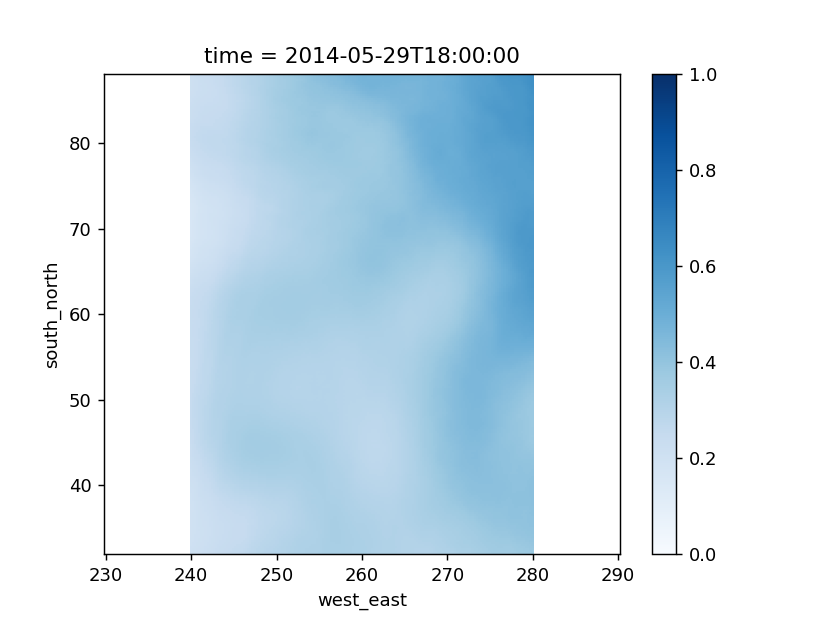

<IPython.core.display.Javascript object>


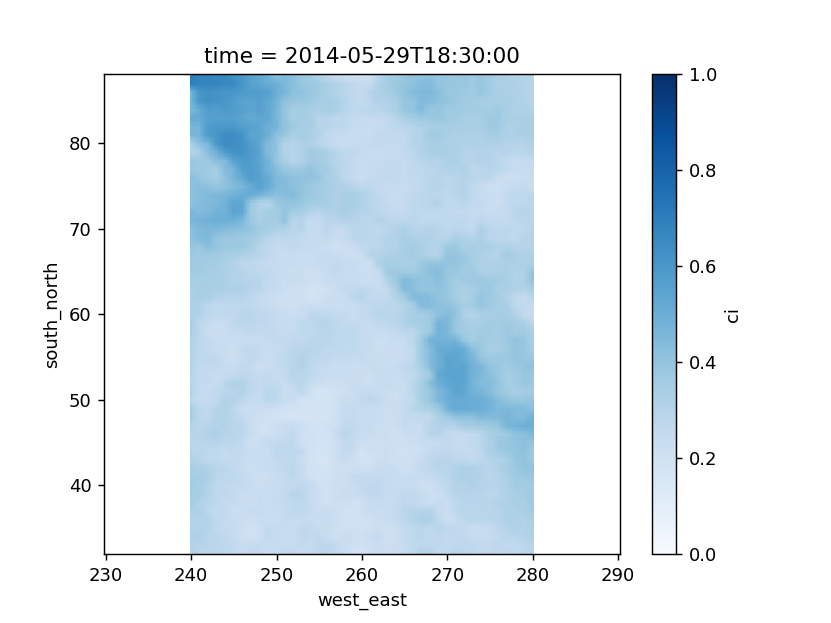

<IPython.core.display.Javascript object>


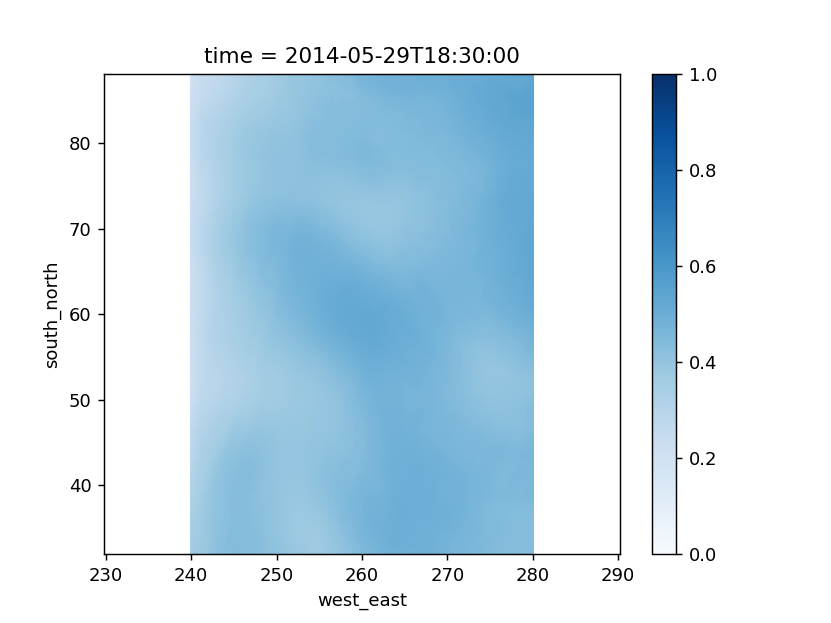

<IPython.core.display.Javascript object>


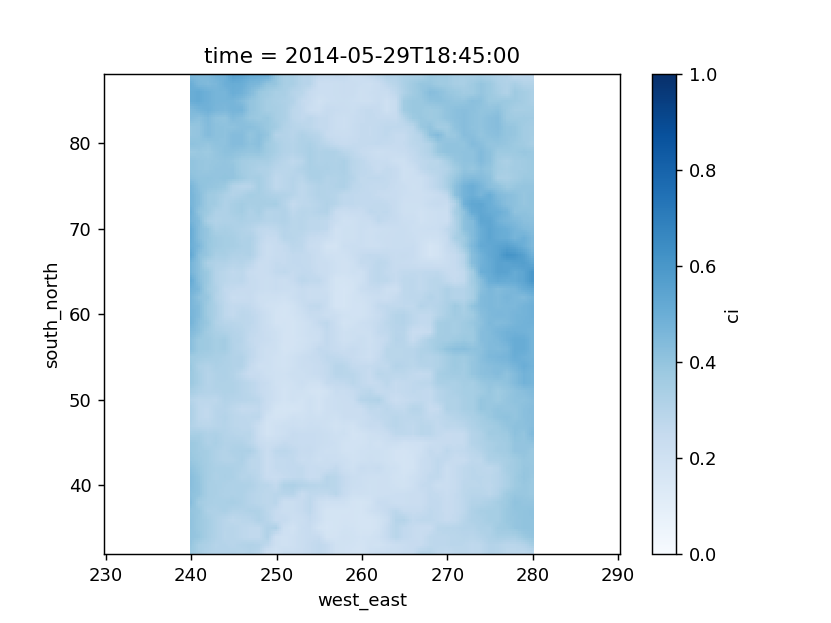

<IPython.core.display.Javascript object>


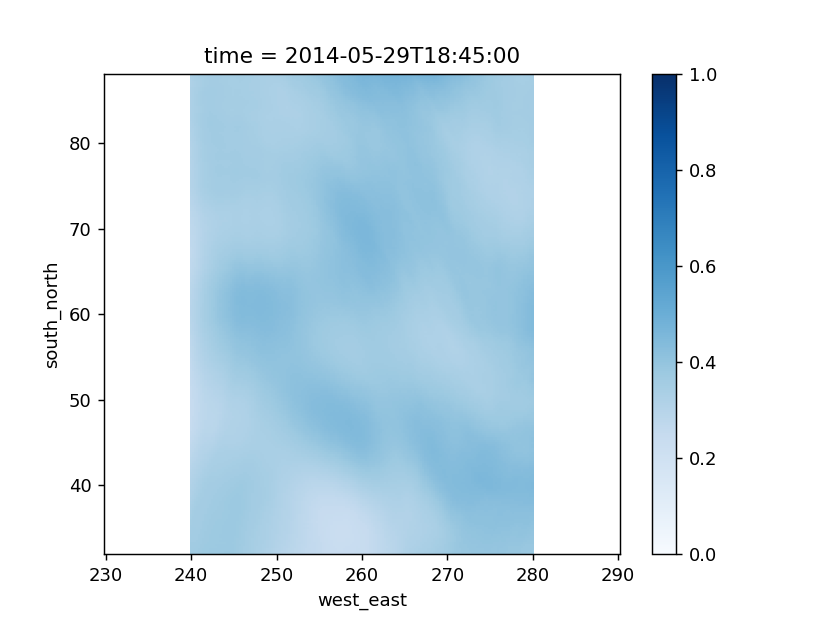

<IPython.core.display.Javascript object>


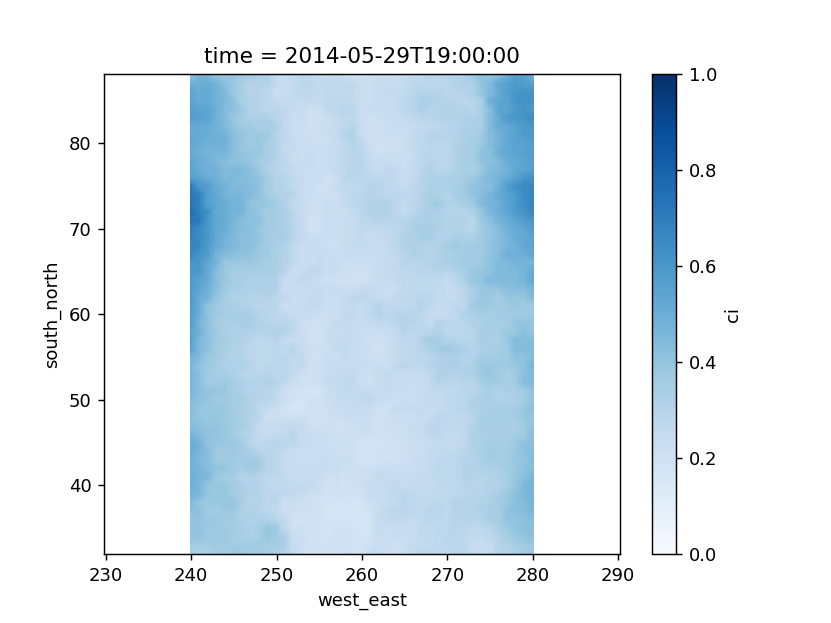

<IPython.core.display.Javascript object>


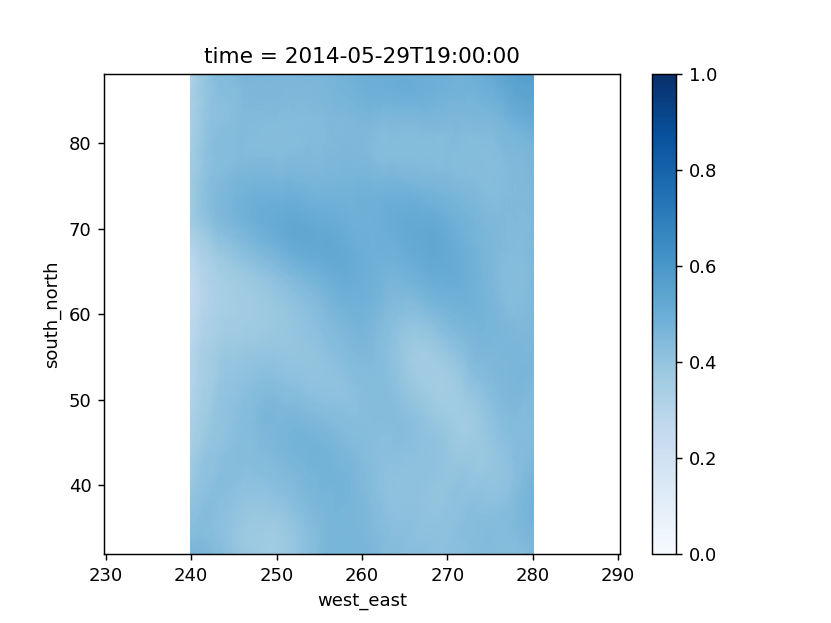

<IPython.core.display.Javascript object>


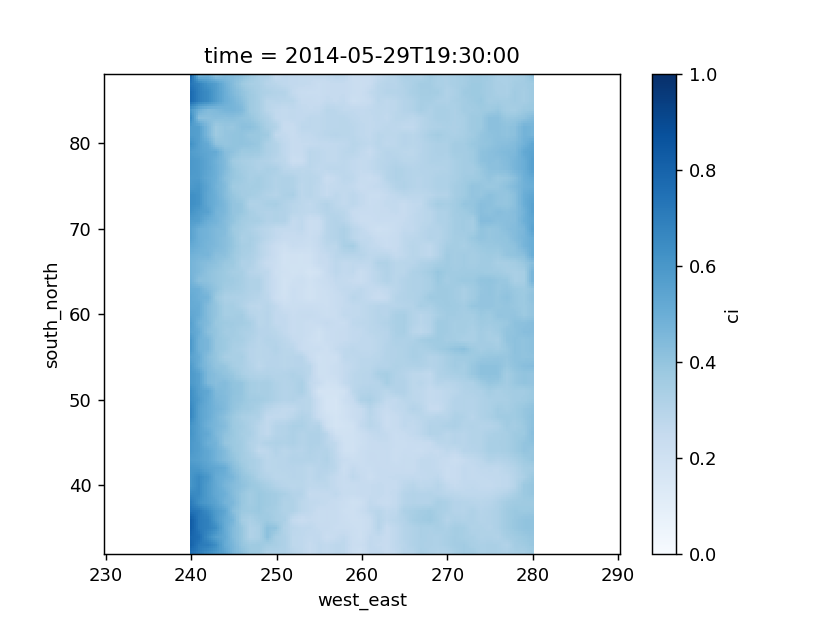

<IPython.core.display.Javascript object>


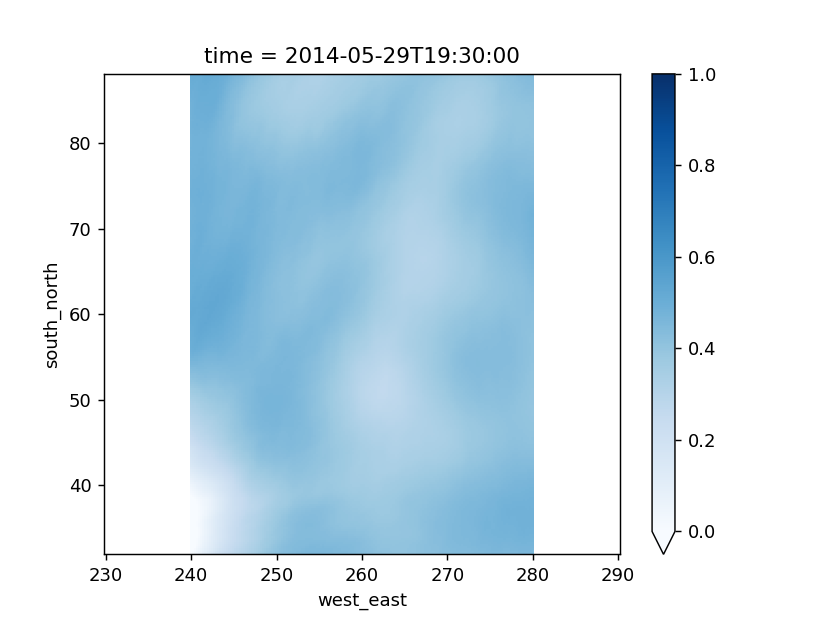

<IPython.core.display.Javascript object>


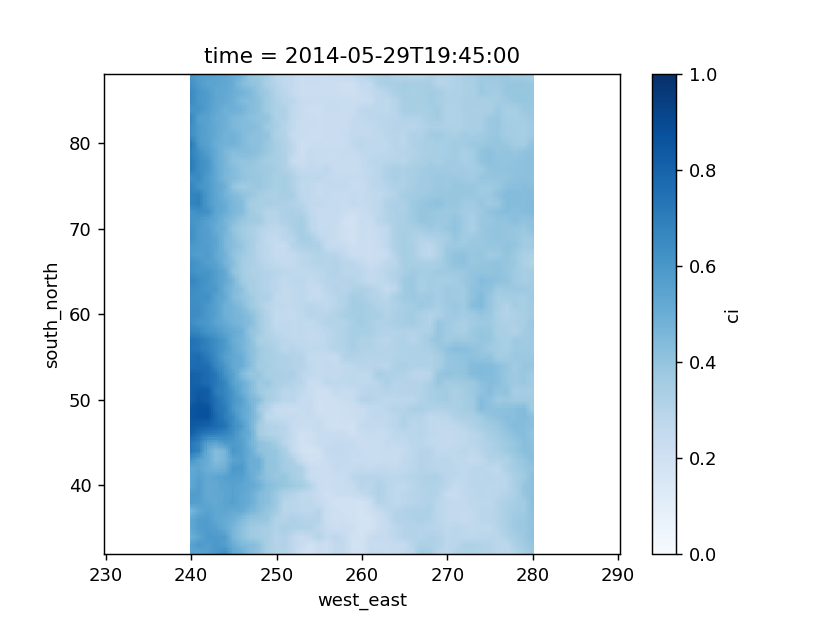

<IPython.core.display.Javascript object>


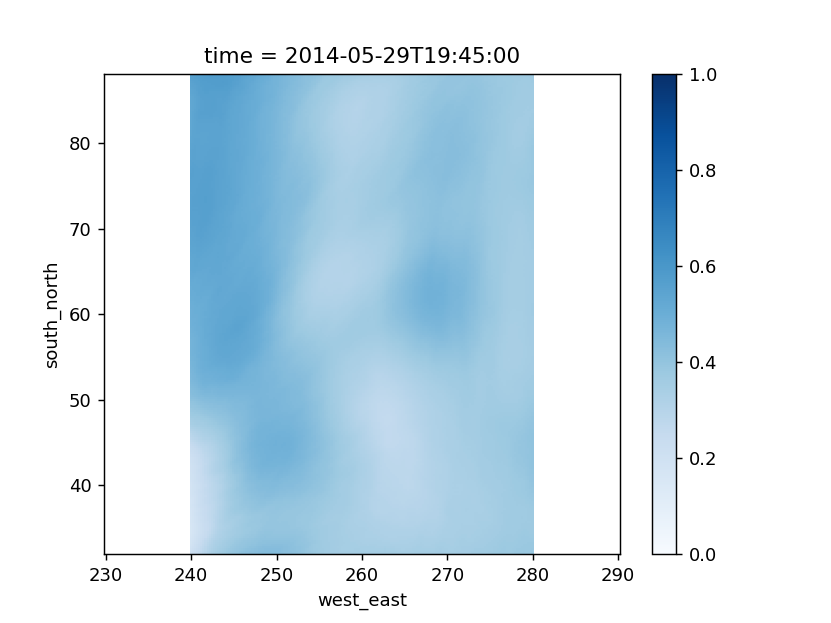

<IPython.core.display.Javascript object>


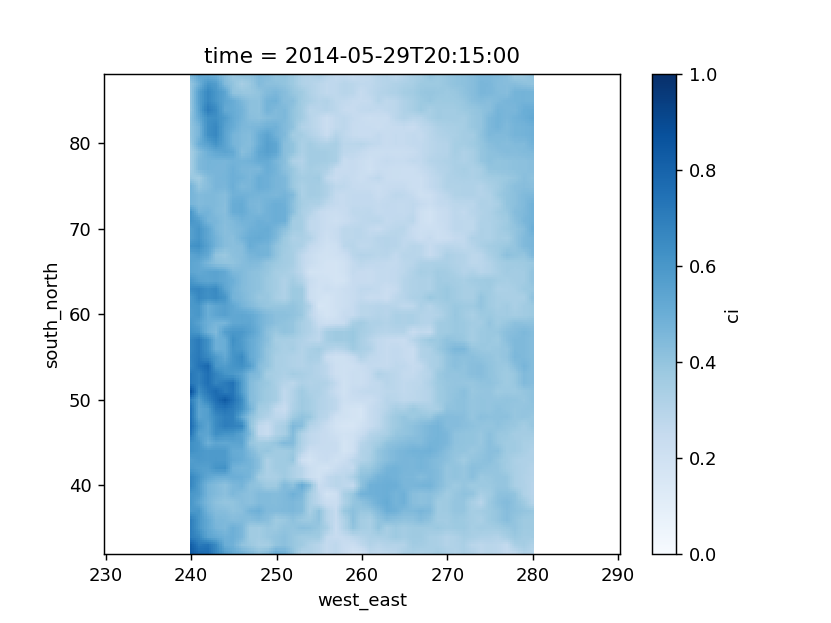

<IPython.core.display.Javascript object>


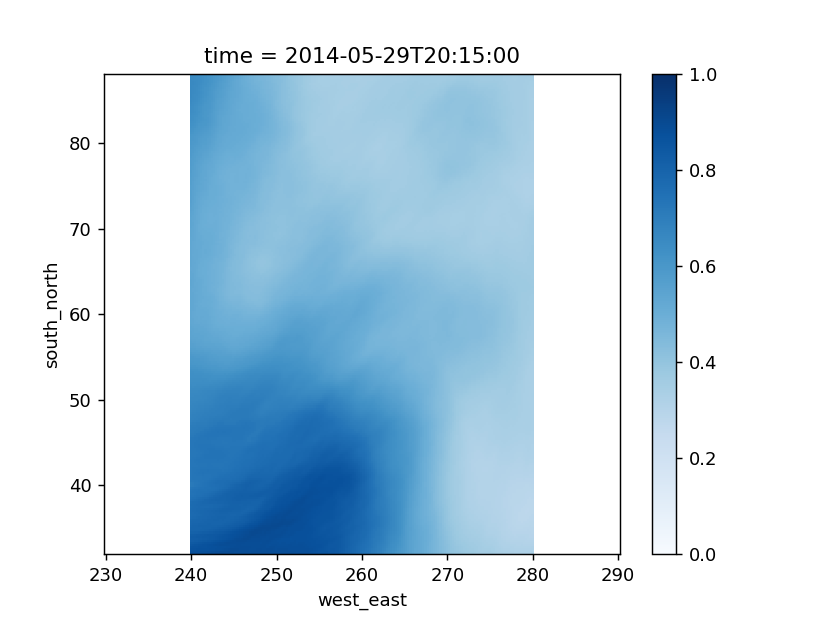

<IPython.core.display.Javascript object>


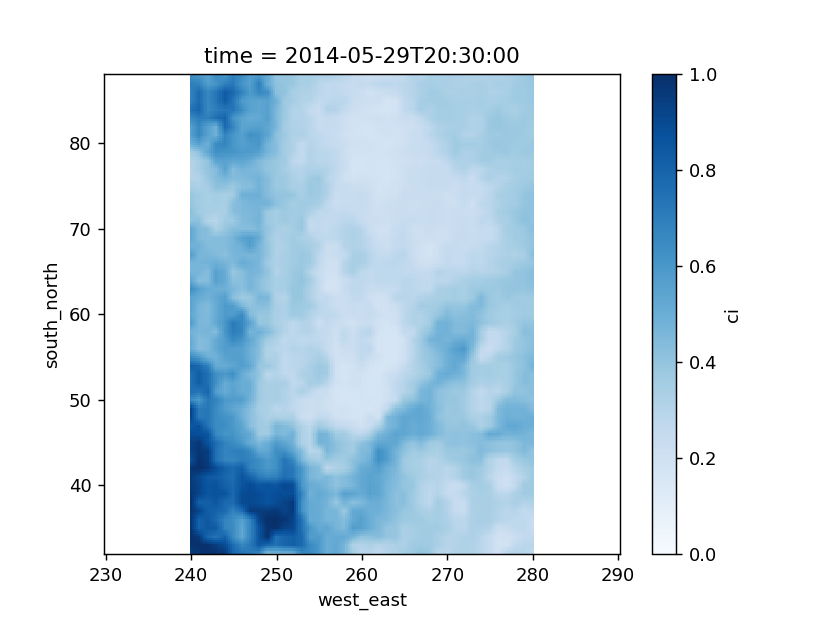

<IPython.core.display.Javascript object>


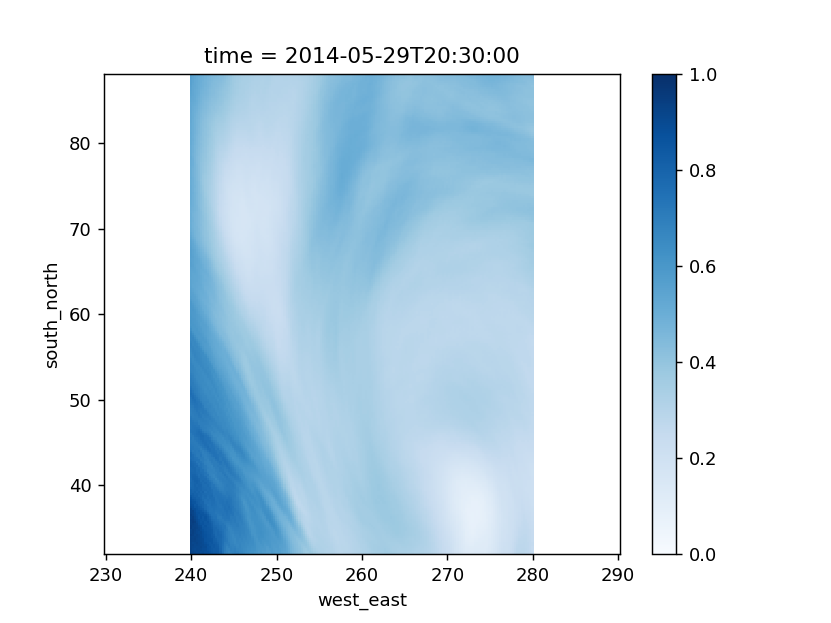

<IPython.core.display.Javascript object>


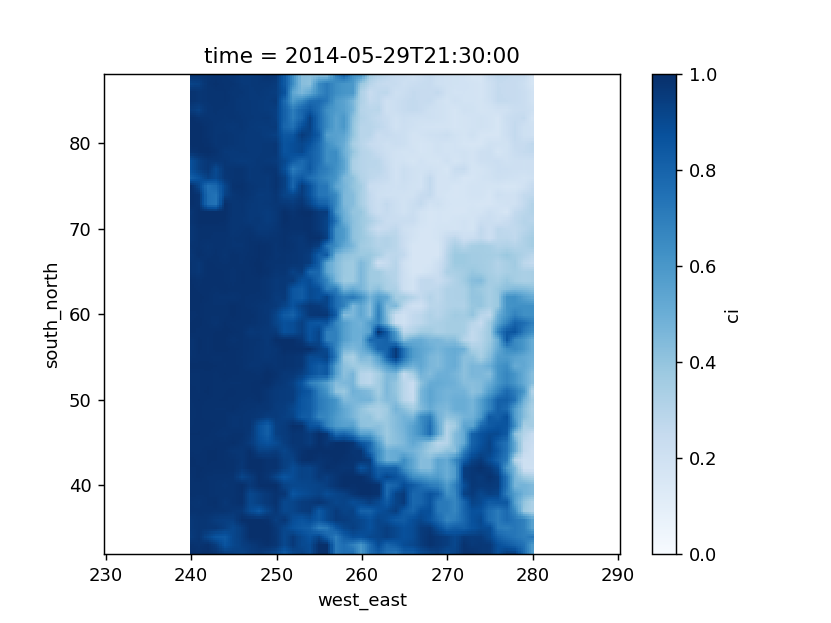

<IPython.core.display.Javascript object>


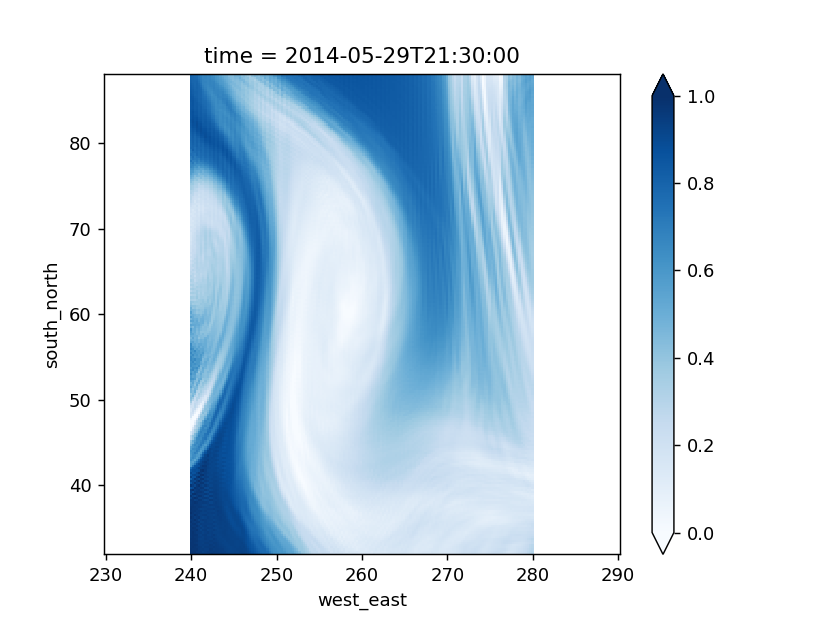

<IPython.core.display.Javascript object>


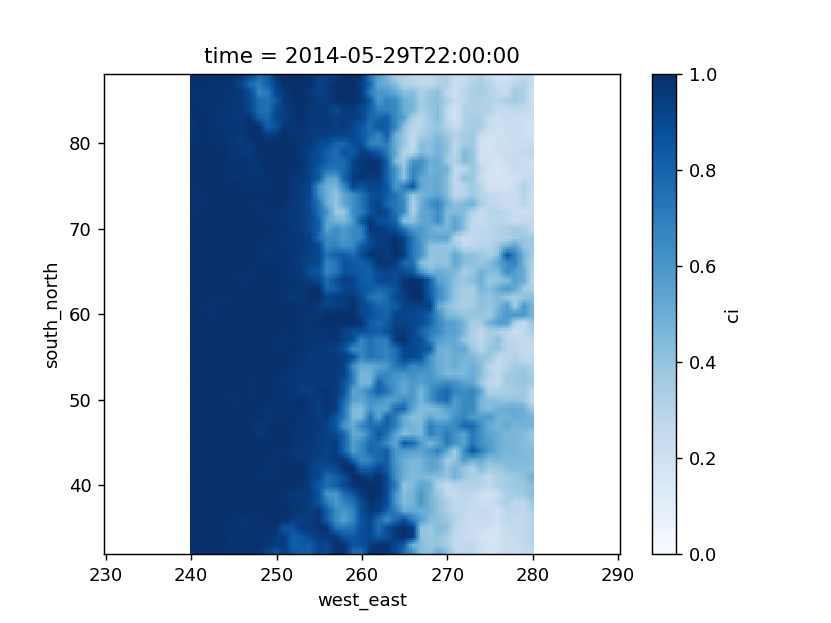

<IPython.core.display.Javascript object>


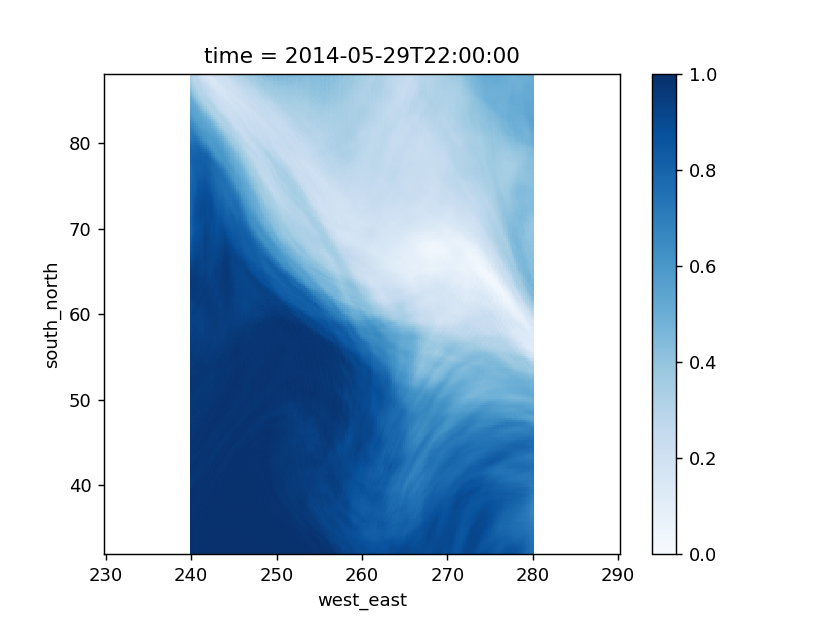

In [141]:
for t in times:
    plt.figure()
    truth_ed.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore60.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')

<IPython.core.display.Javascript object>


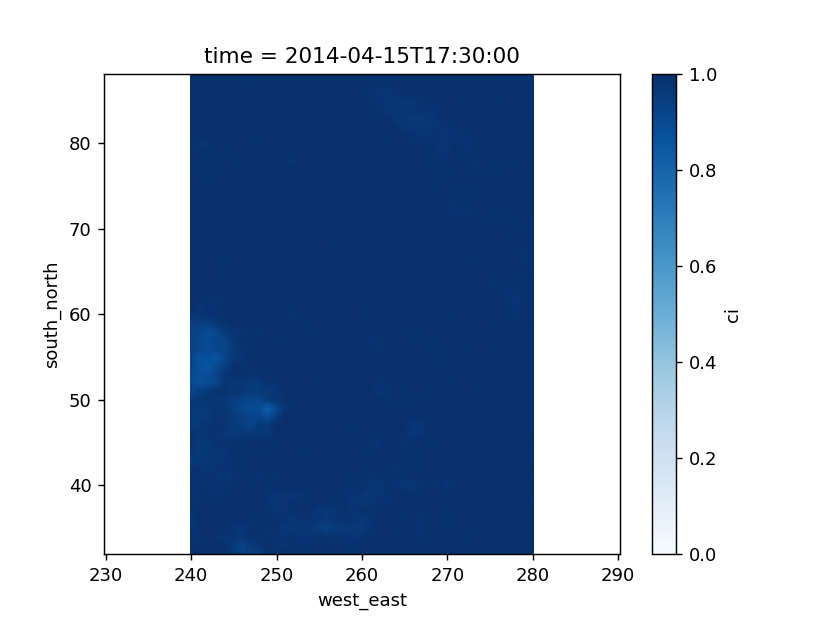

<IPython.core.display.Javascript object>


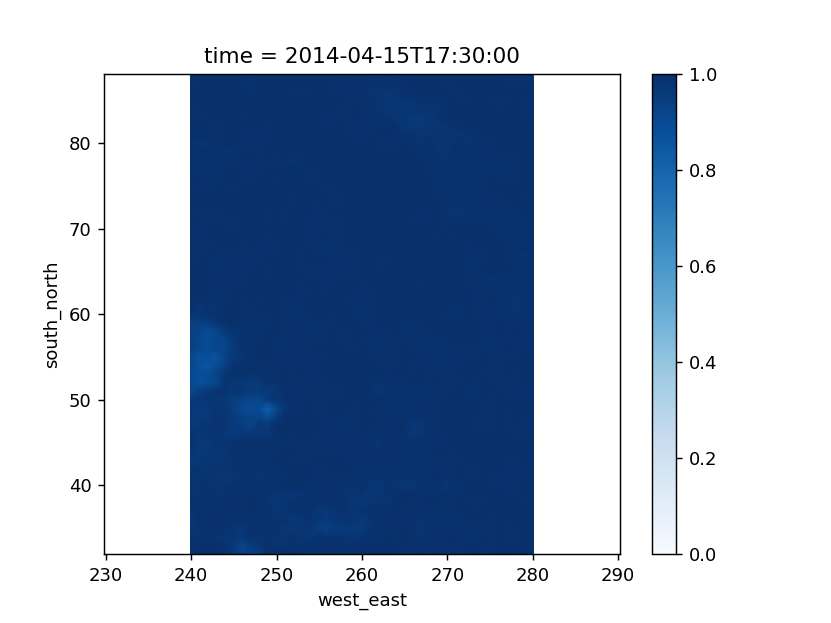

<IPython.core.display.Javascript object>


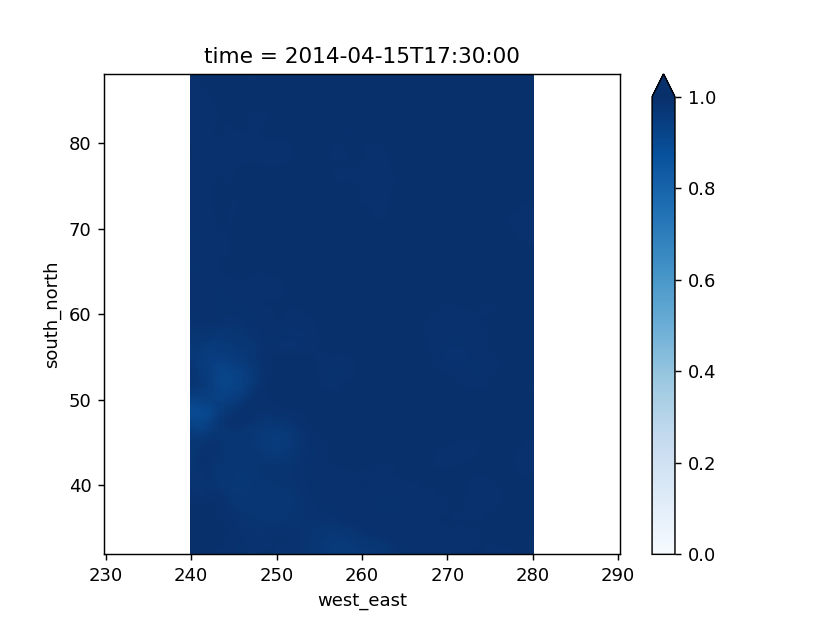

<IPython.core.display.Javascript object>


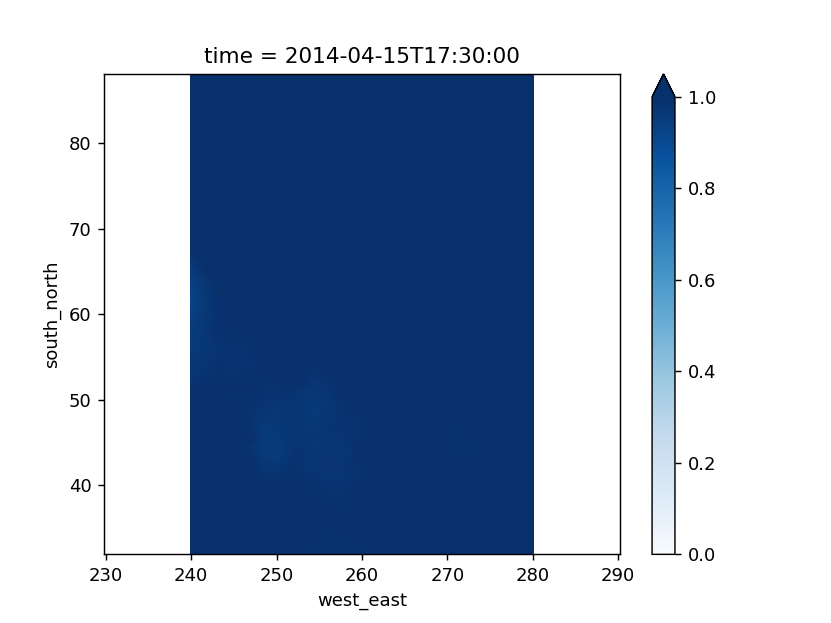

<IPython.core.display.Javascript object>


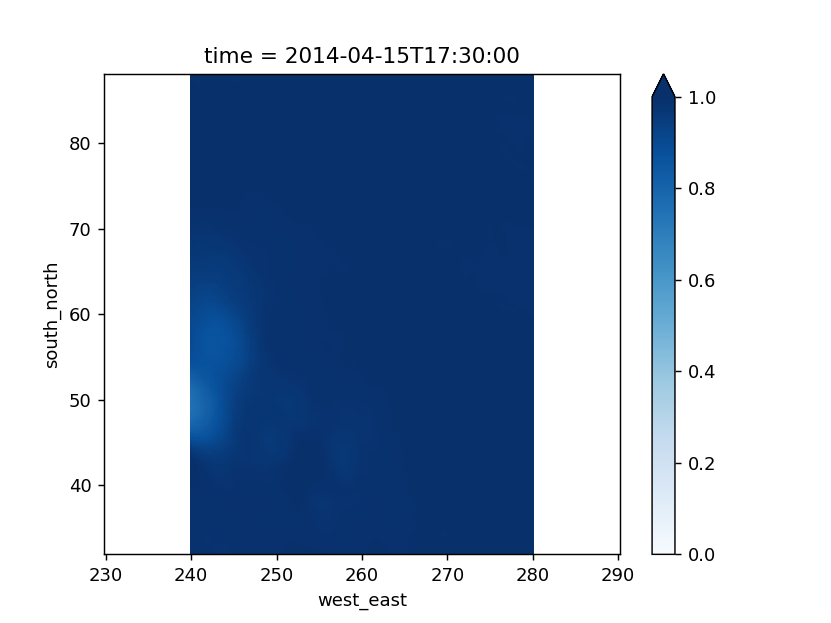

<IPython.core.display.Javascript object>


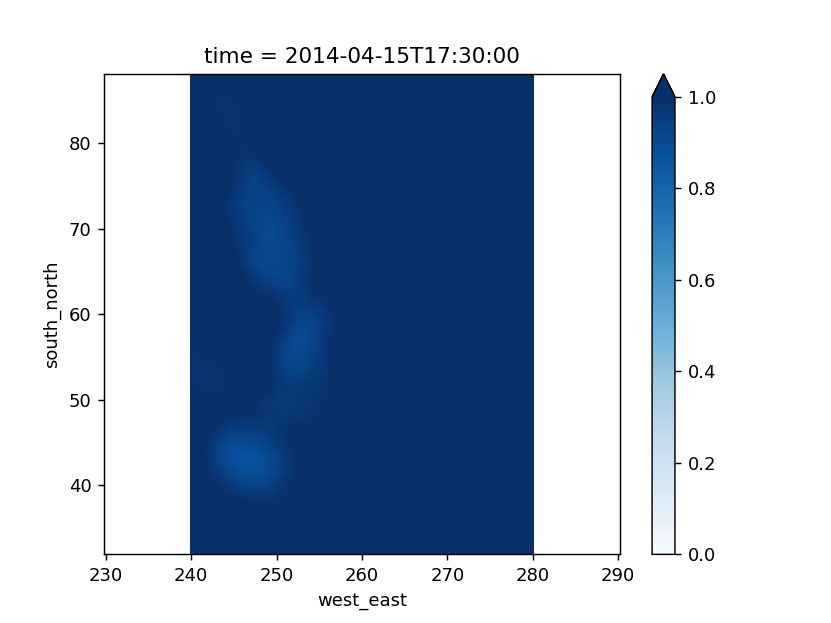

<IPython.core.display.Javascript object>


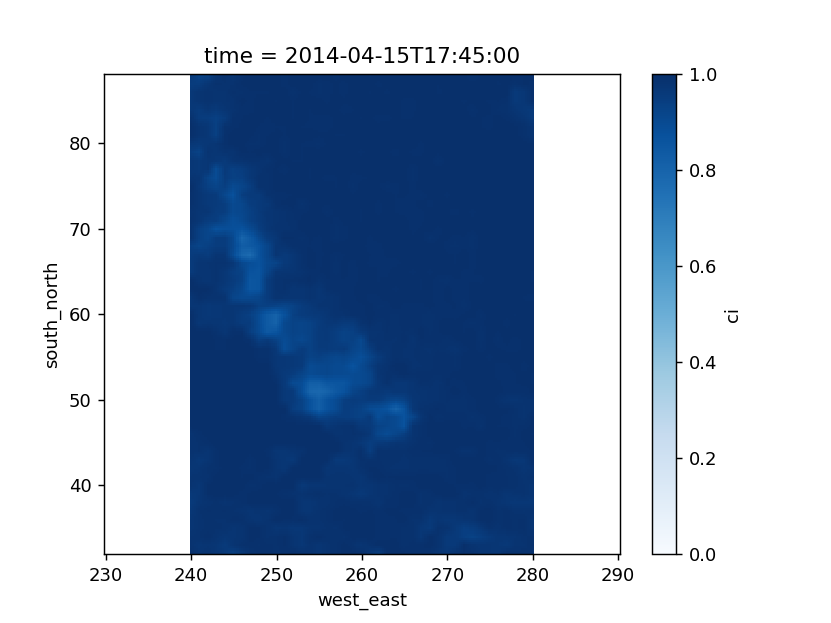

<IPython.core.display.Javascript object>


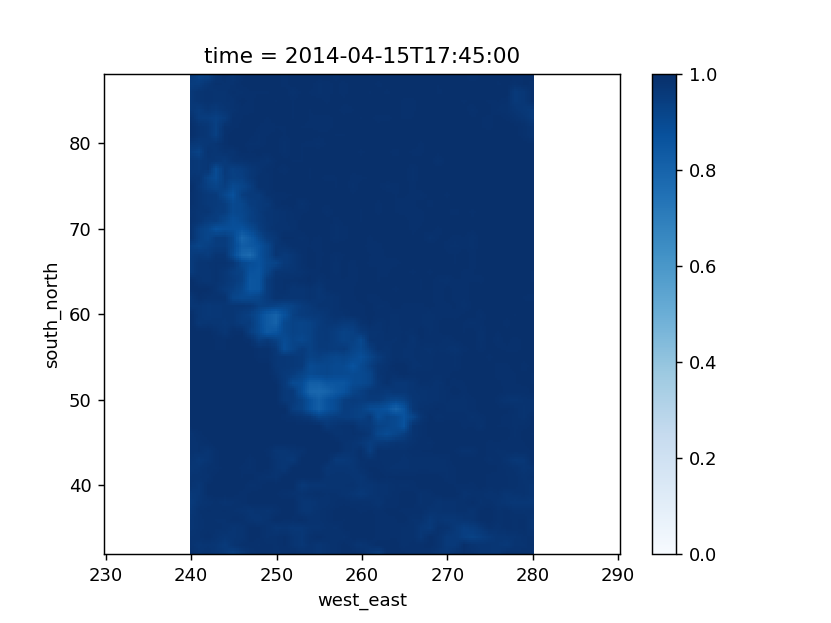

<IPython.core.display.Javascript object>


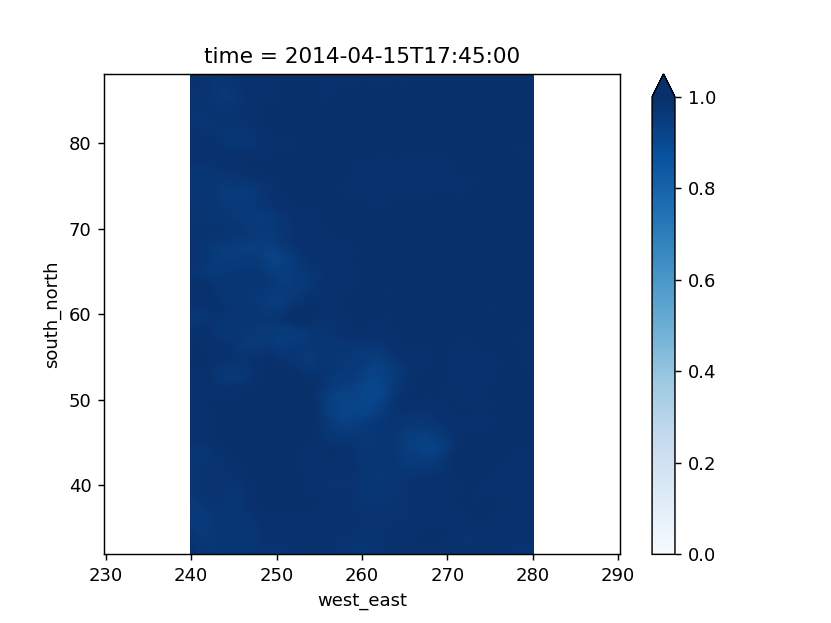

<IPython.core.display.Javascript object>


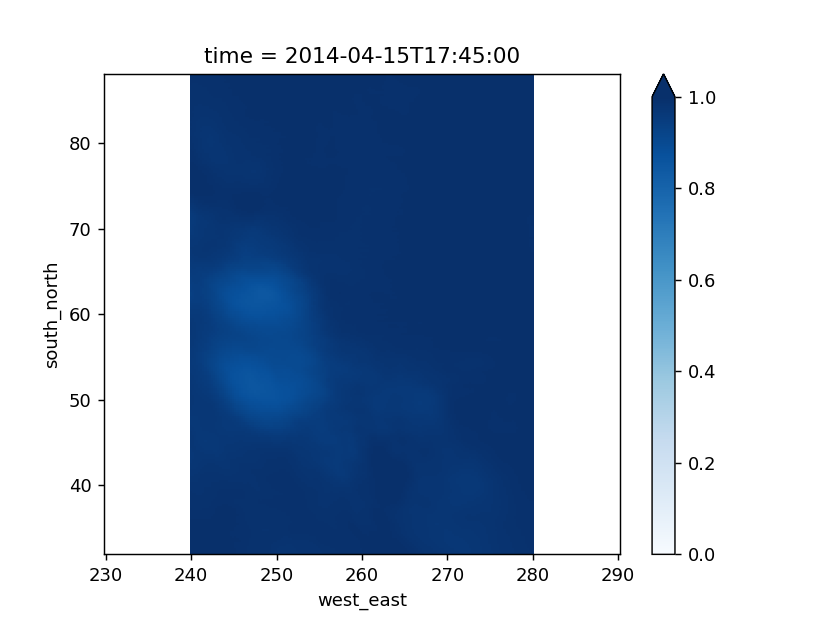

<IPython.core.display.Javascript object>


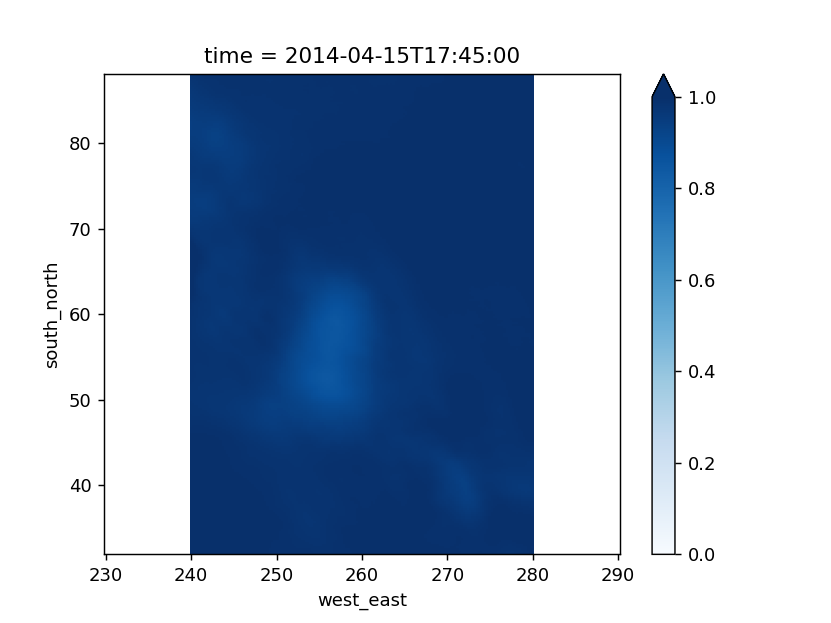

<IPython.core.display.Javascript object>


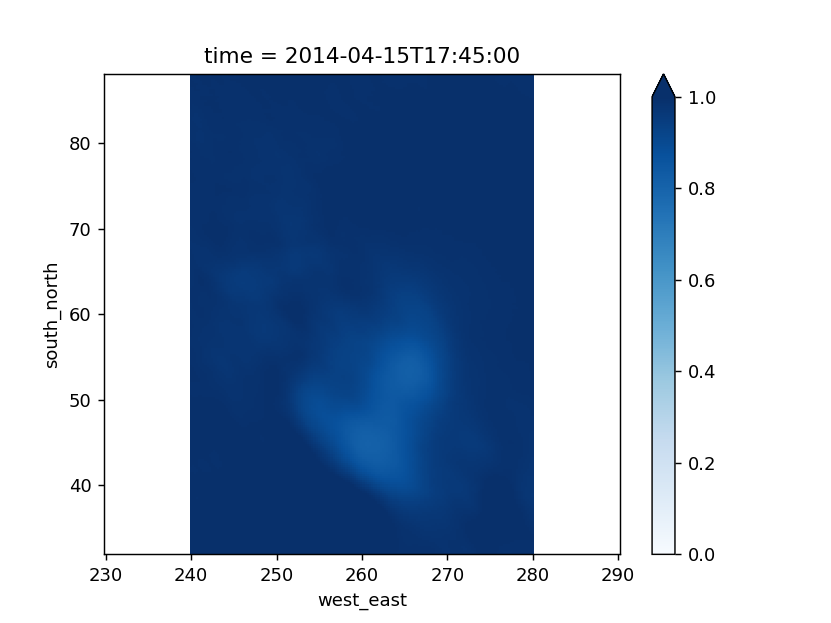

<IPython.core.display.Javascript object>


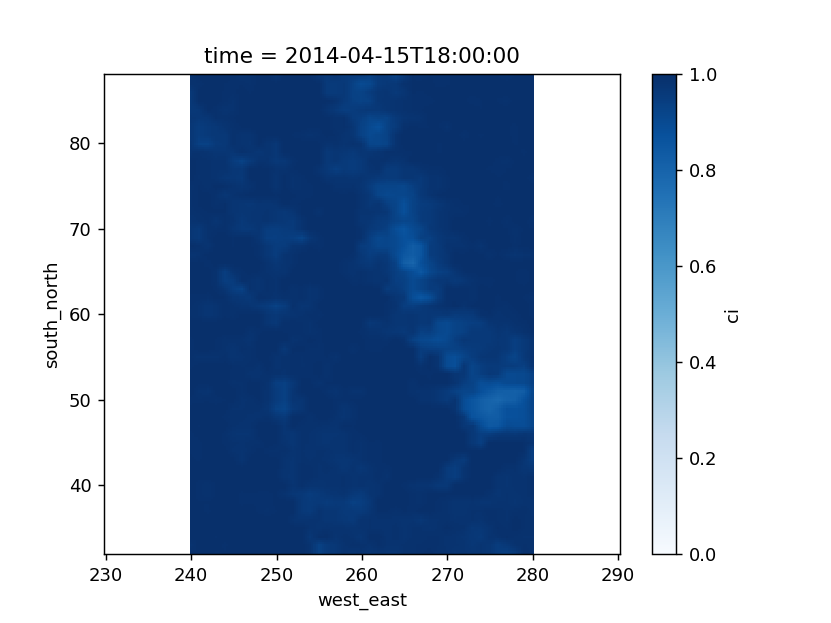

<IPython.core.display.Javascript object>


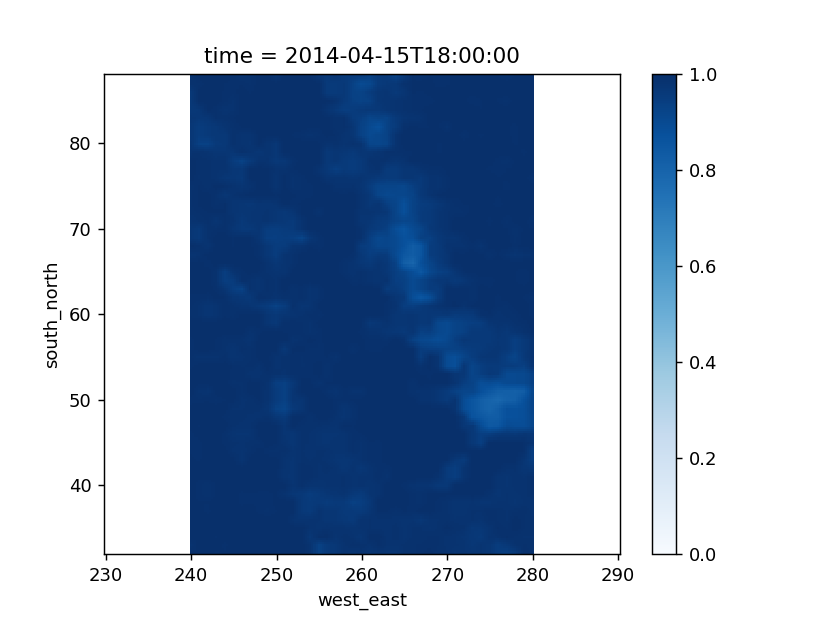

<IPython.core.display.Javascript object>


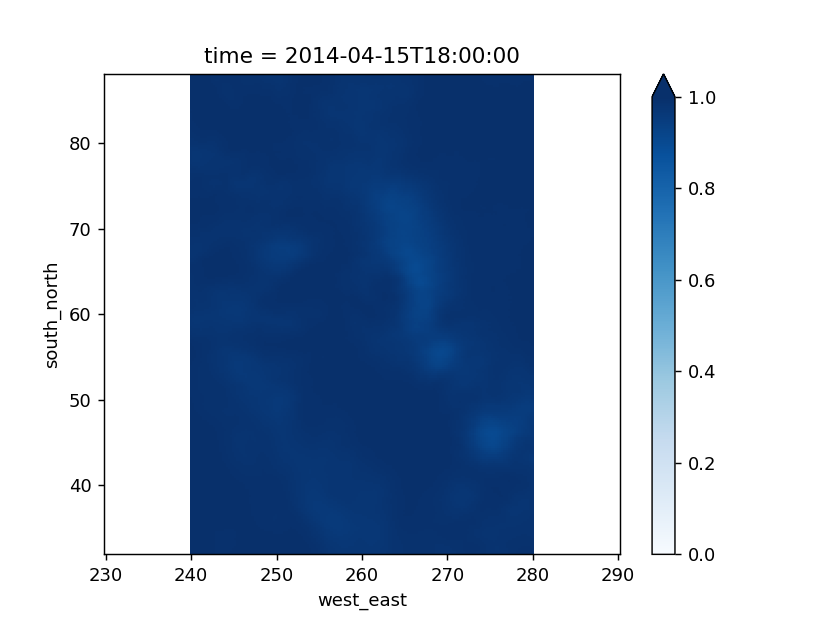

<IPython.core.display.Javascript object>


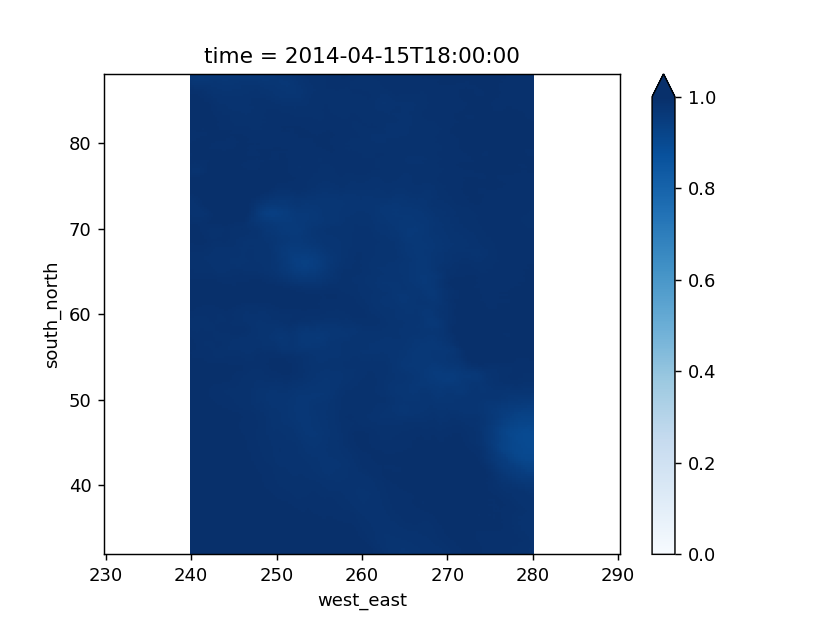

<IPython.core.display.Javascript object>


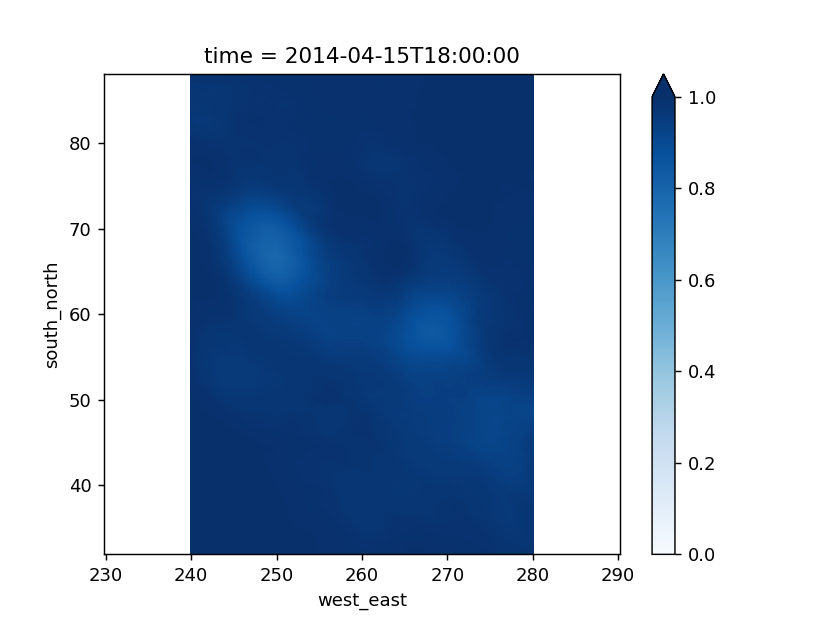

<IPython.core.display.Javascript object>


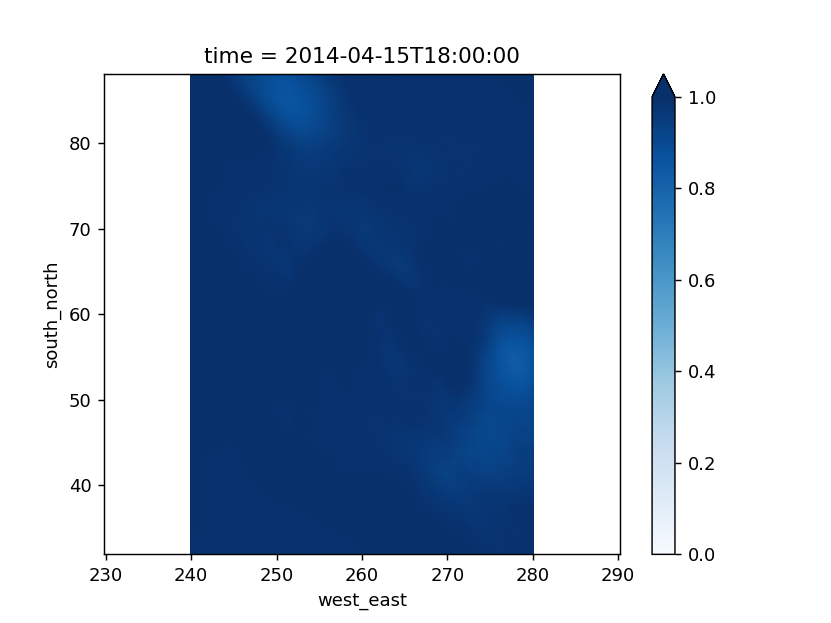

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


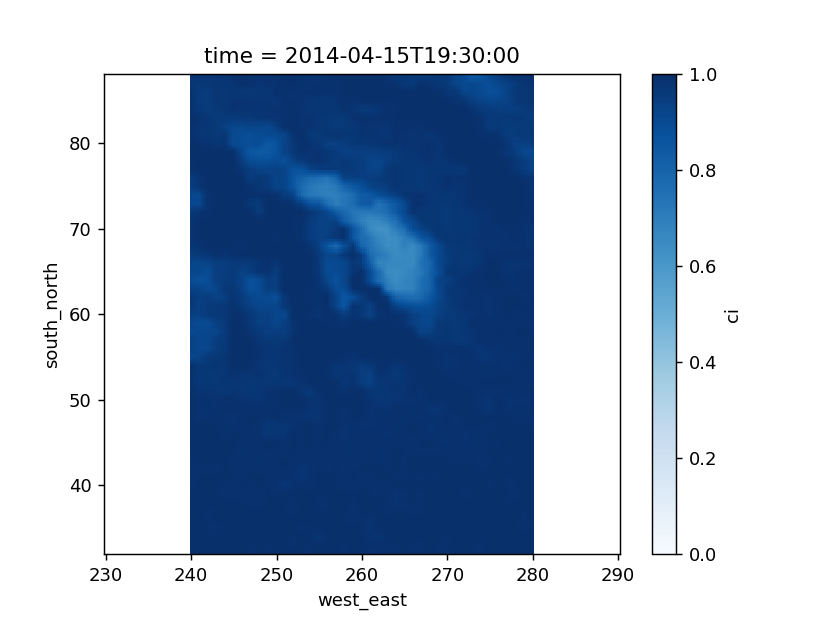

<IPython.core.display.Javascript object>


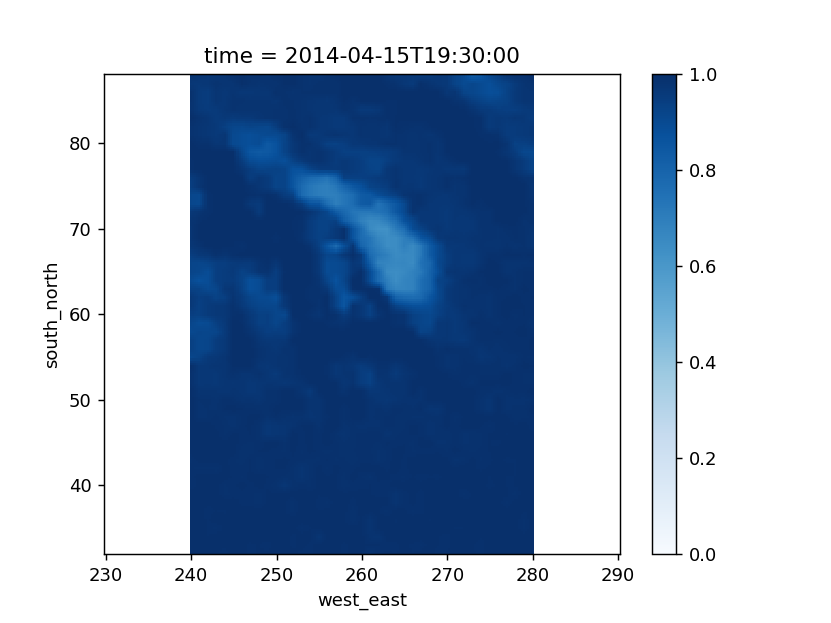

<IPython.core.display.Javascript object>


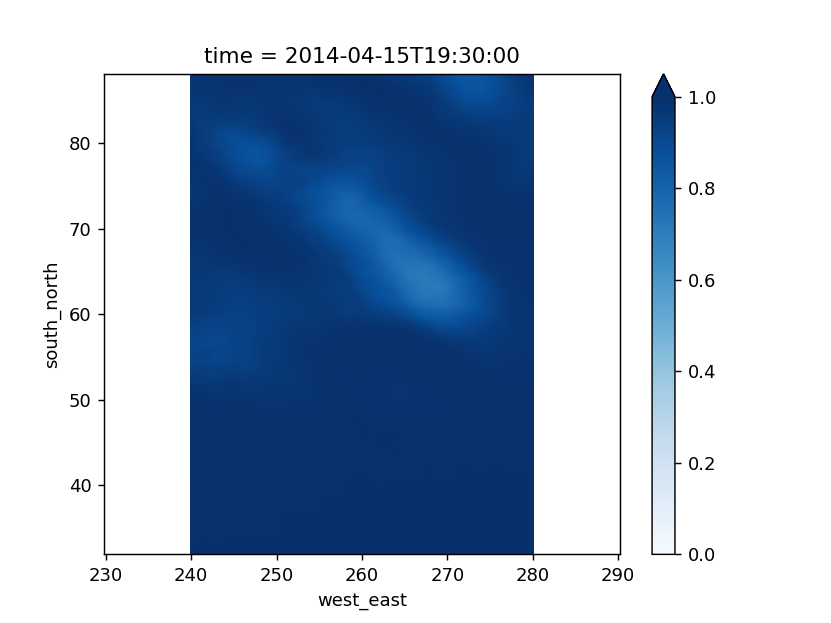

<IPython.core.display.Javascript object>


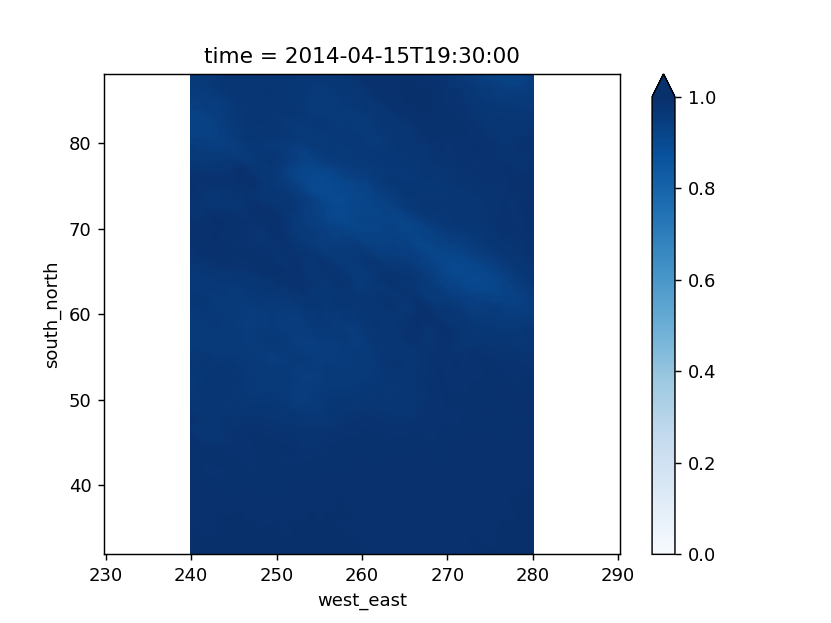

<IPython.core.display.Javascript object>


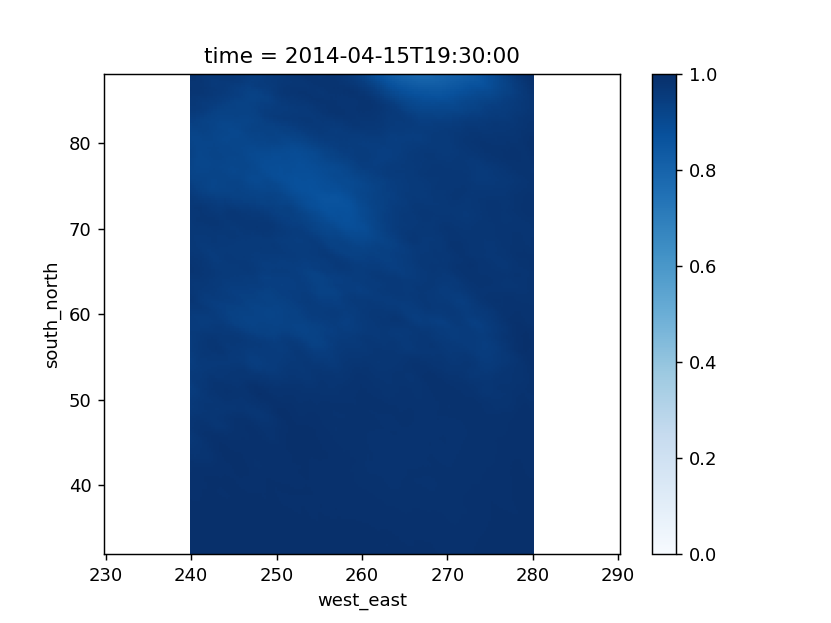

<IPython.core.display.Javascript object>


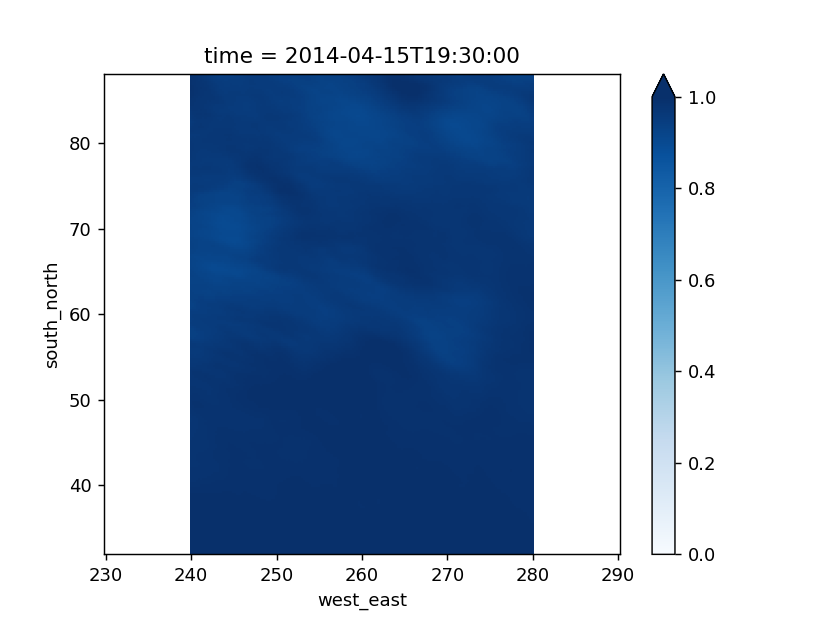

<IPython.core.display.Javascript object>


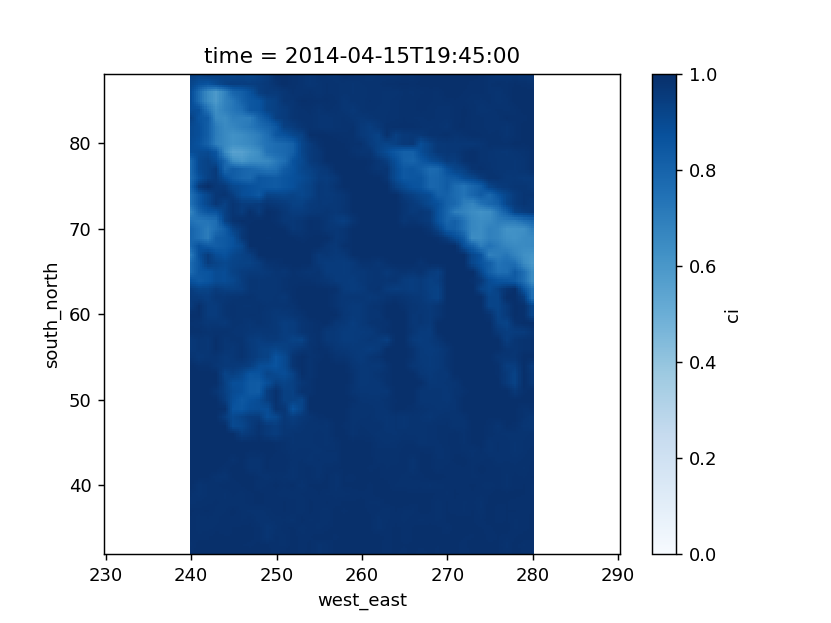

<IPython.core.display.Javascript object>


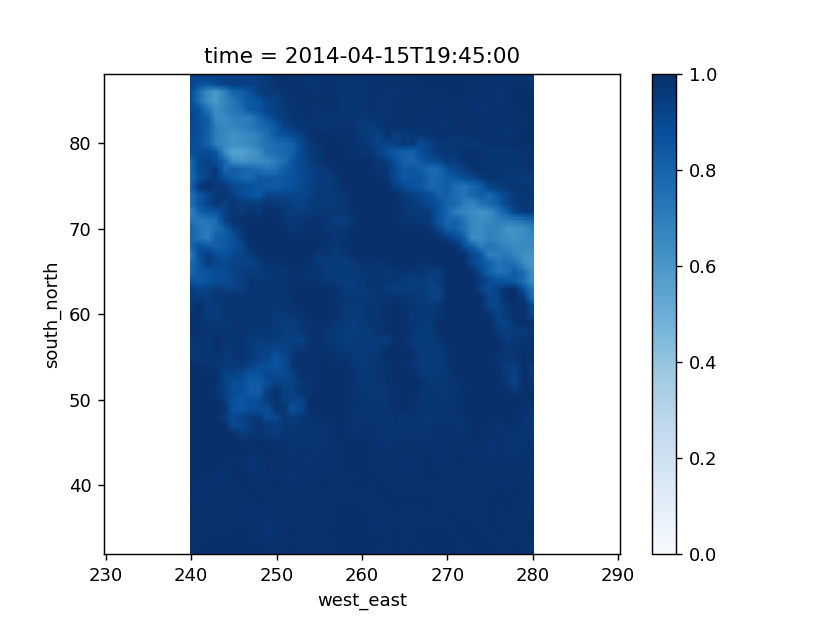

<IPython.core.display.Javascript object>


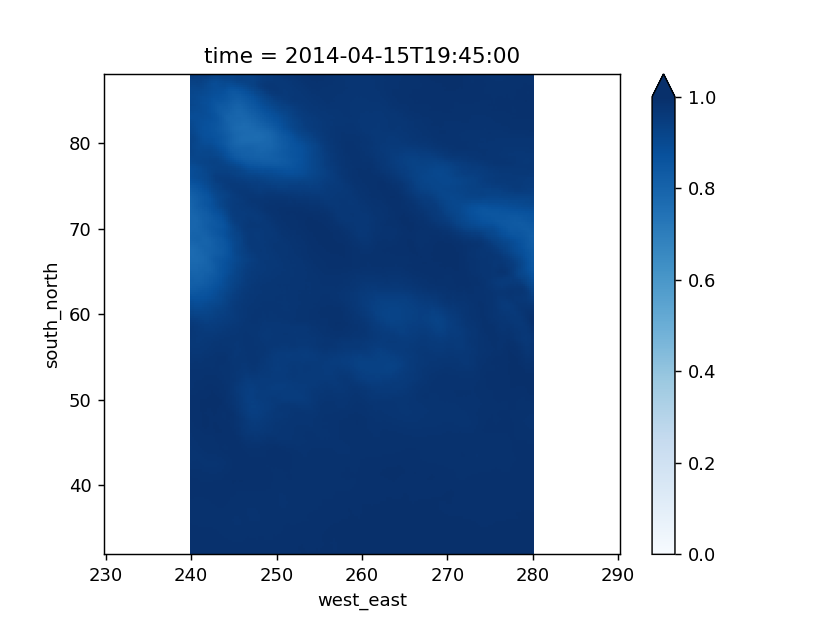

<IPython.core.display.Javascript object>


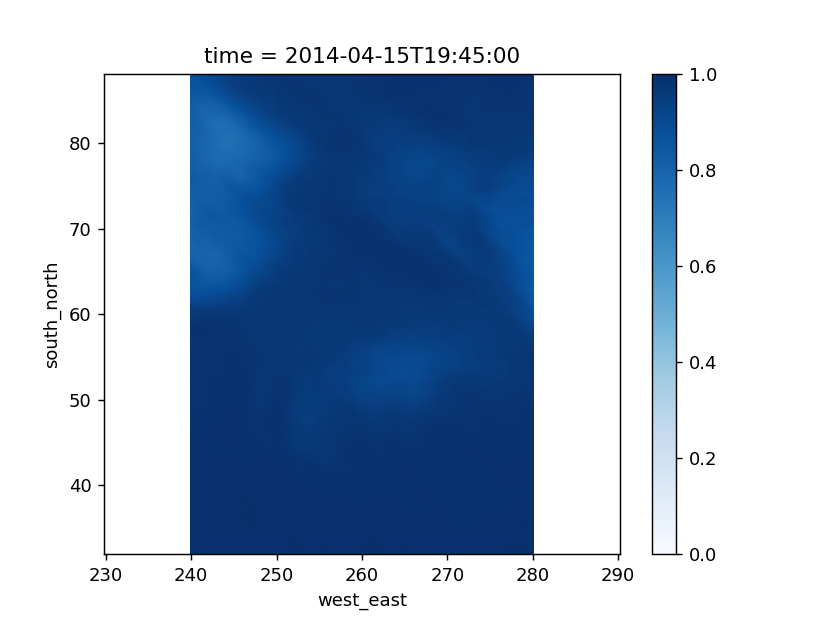

<IPython.core.display.Javascript object>


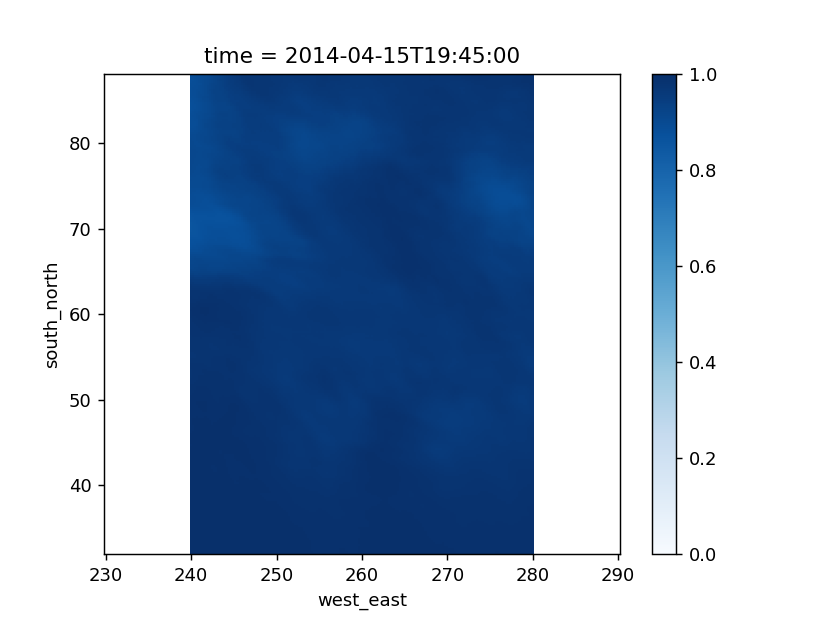

<IPython.core.display.Javascript object>


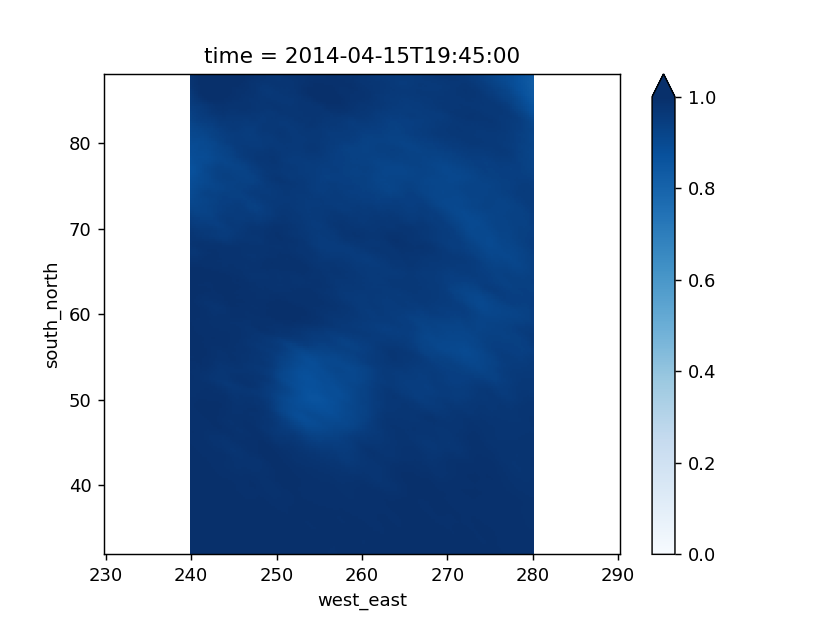

<IPython.core.display.Javascript object>


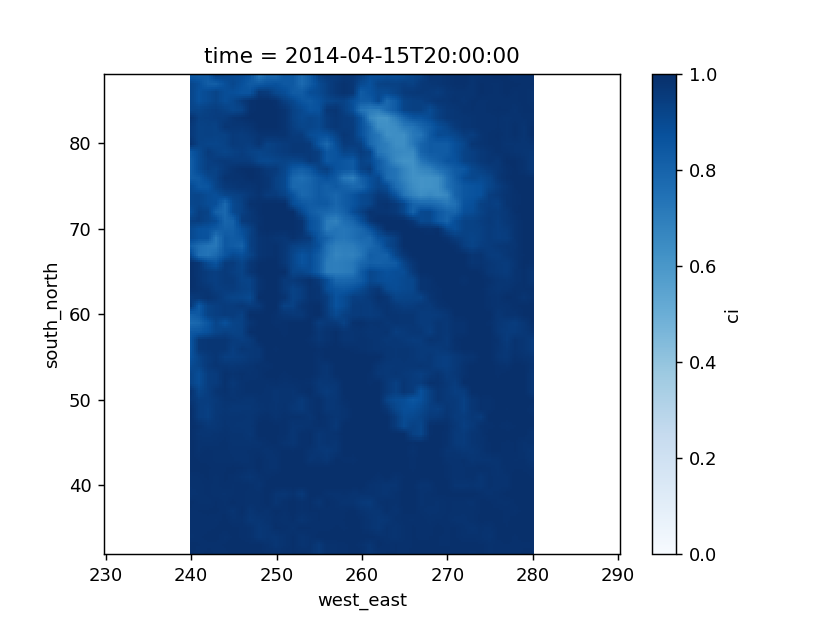

<IPython.core.display.Javascript object>


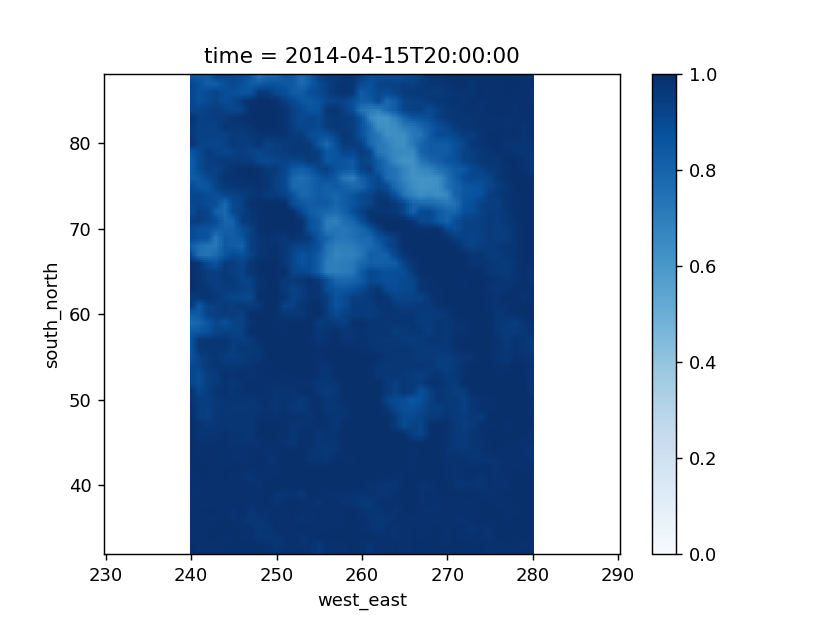

<IPython.core.display.Javascript object>


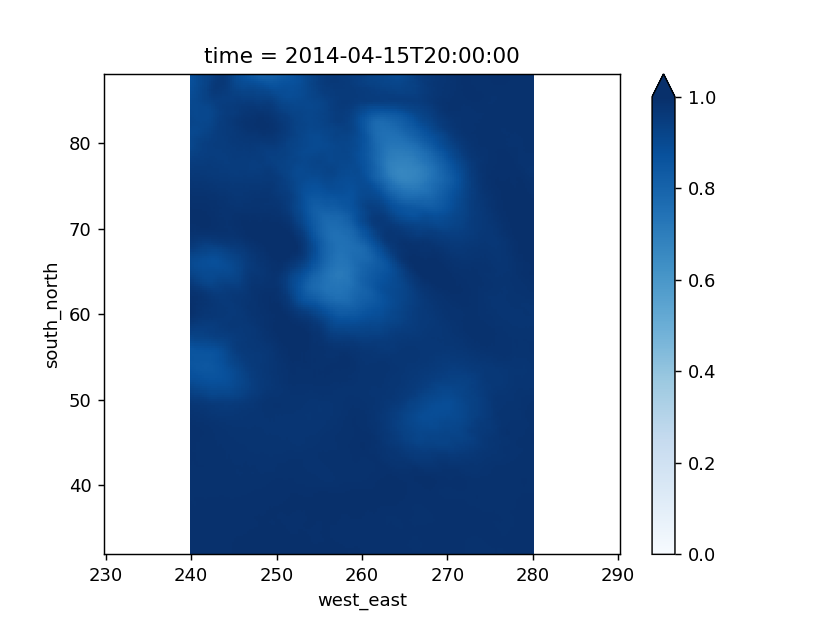

<IPython.core.display.Javascript object>


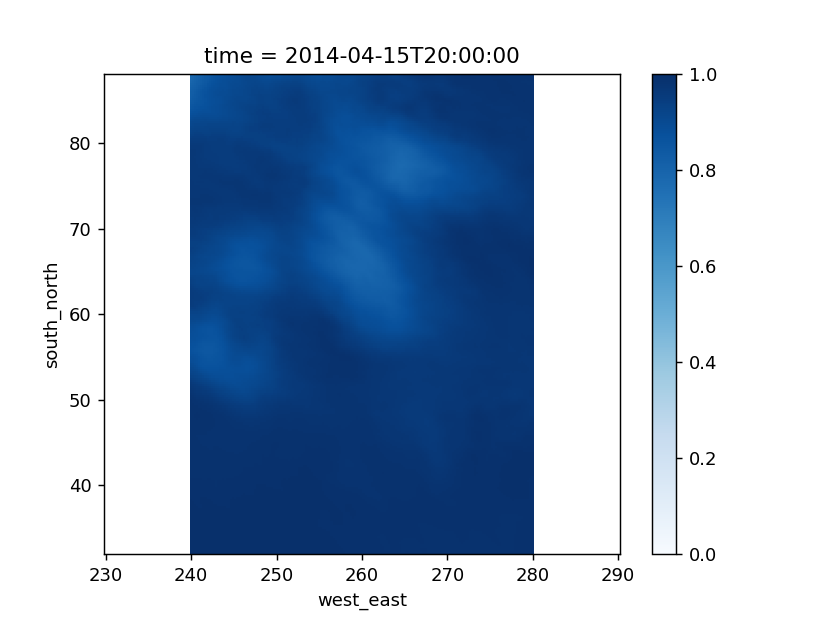

<IPython.core.display.Javascript object>


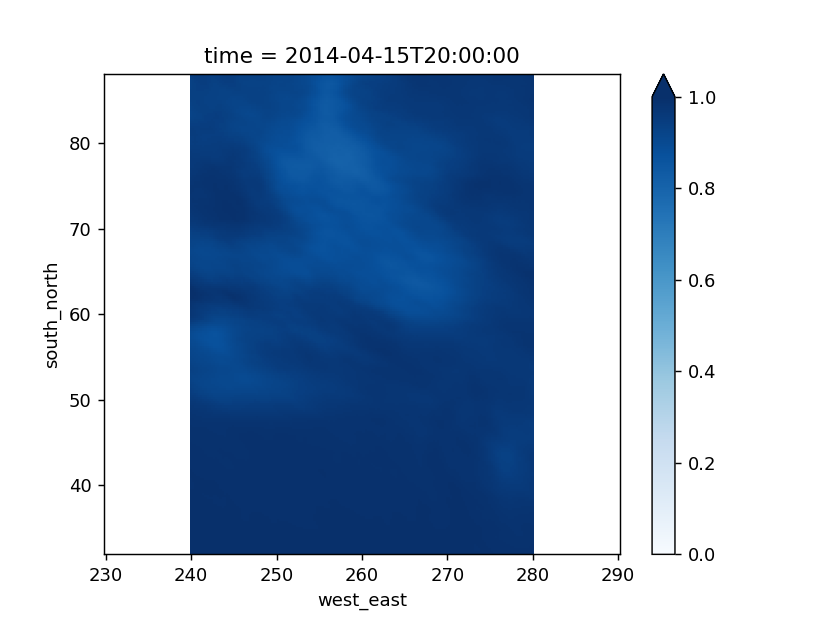

<IPython.core.display.Javascript object>


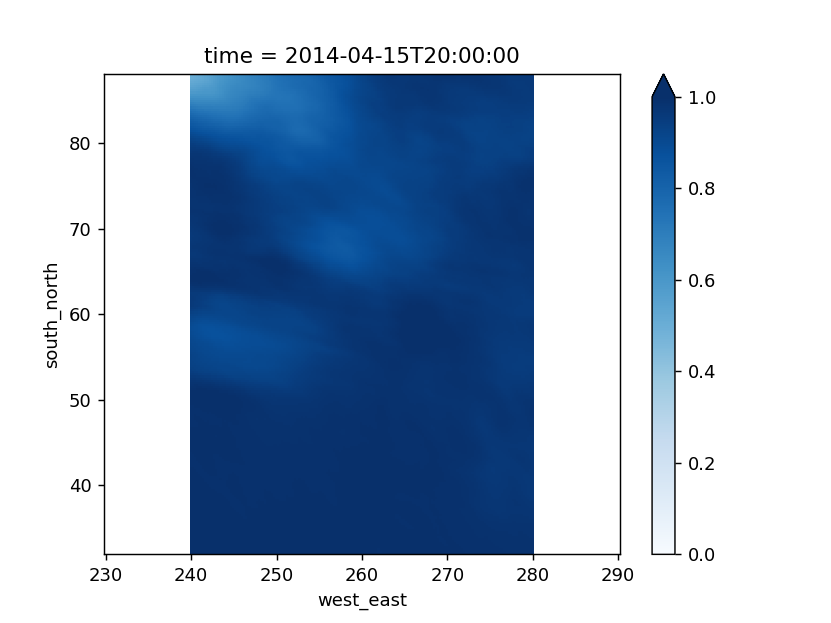

<IPython.core.display.Javascript object>


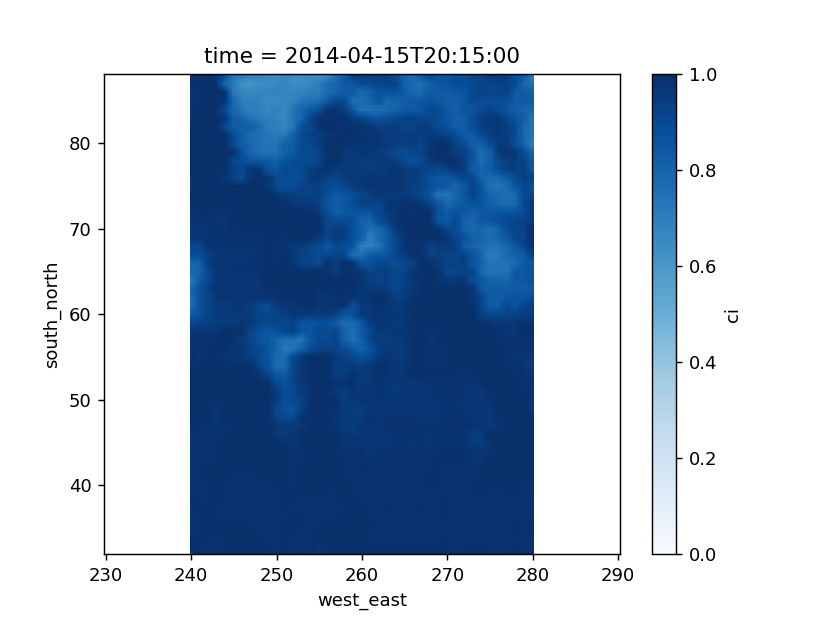

<IPython.core.display.Javascript object>


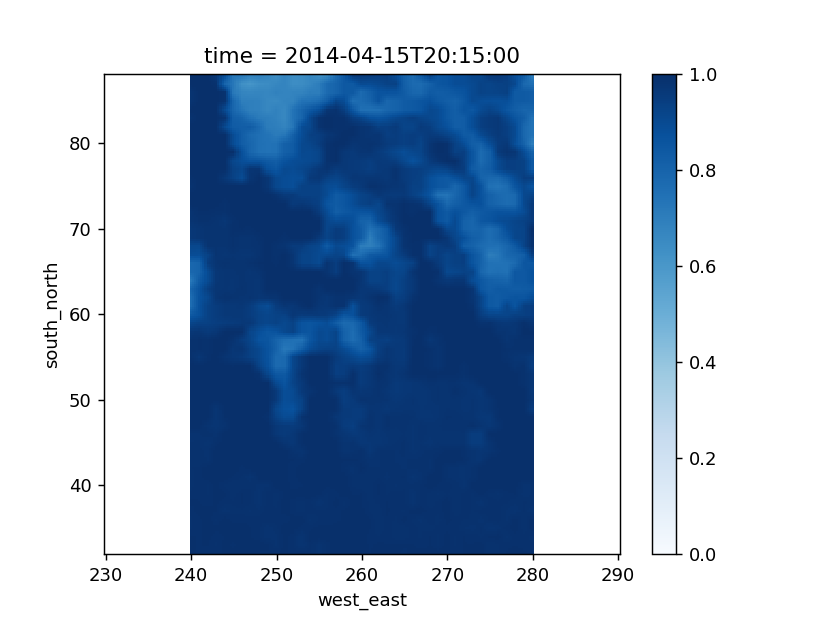

<IPython.core.display.Javascript object>


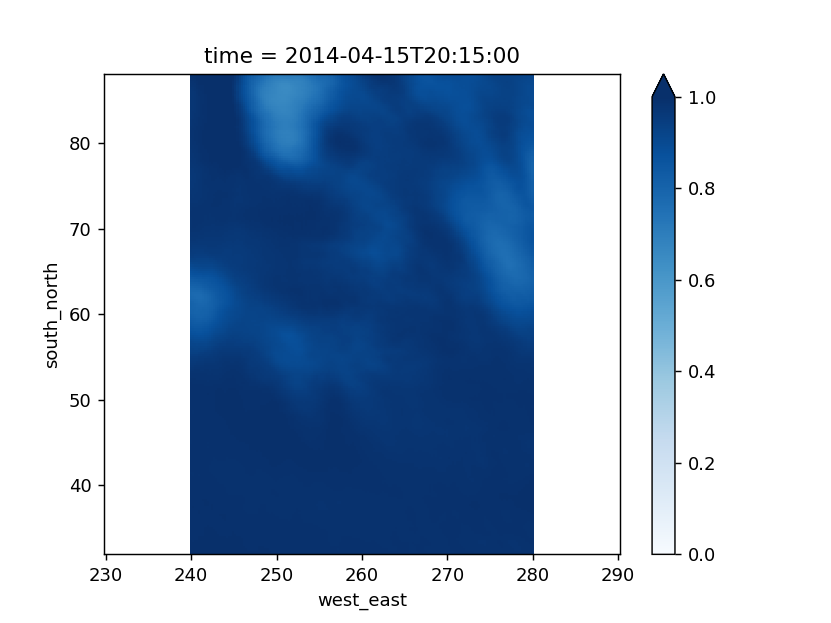

<IPython.core.display.Javascript object>


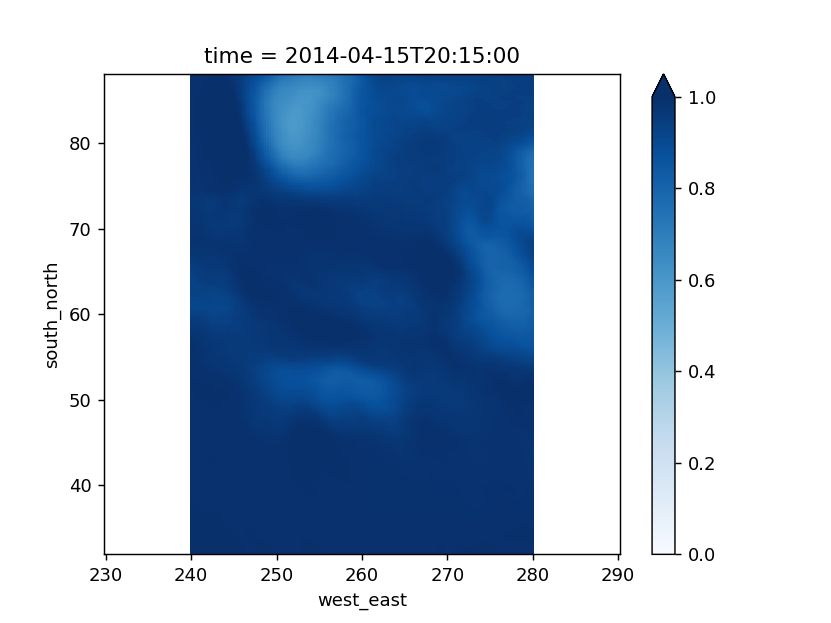

<IPython.core.display.Javascript object>


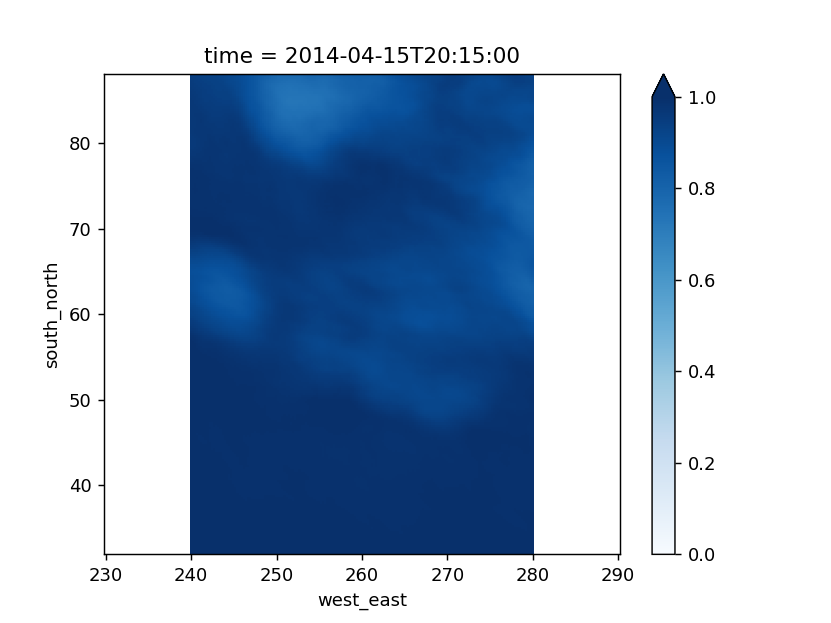

<IPython.core.display.Javascript object>


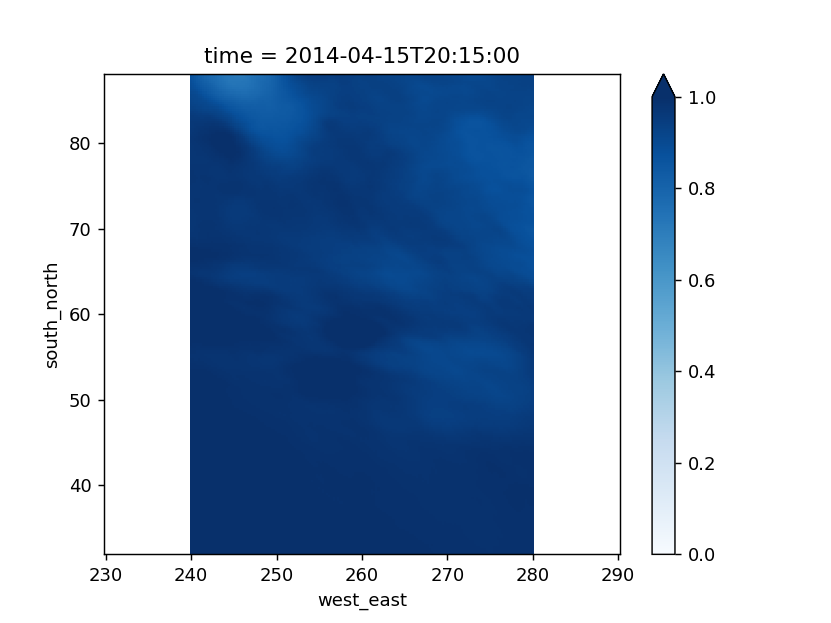

<IPython.core.display.Javascript object>


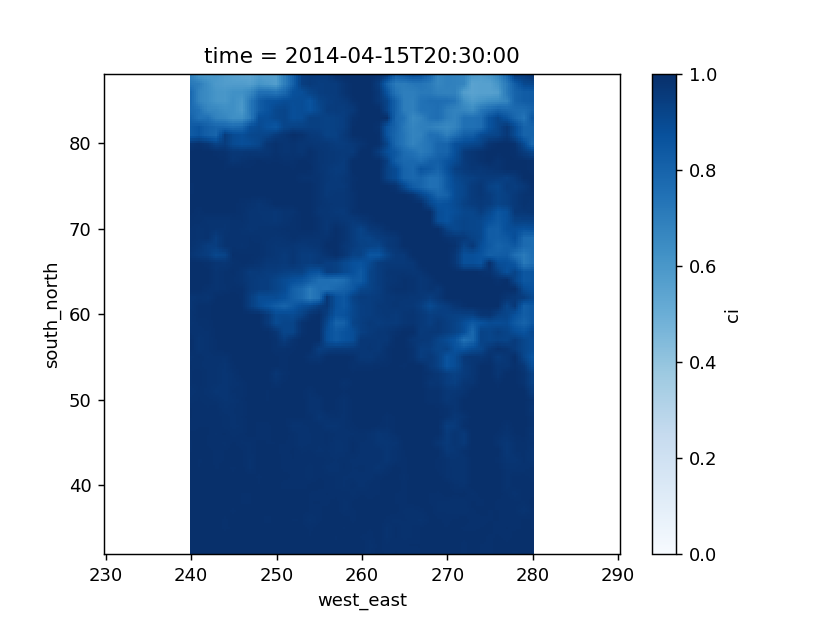

<IPython.core.display.Javascript object>


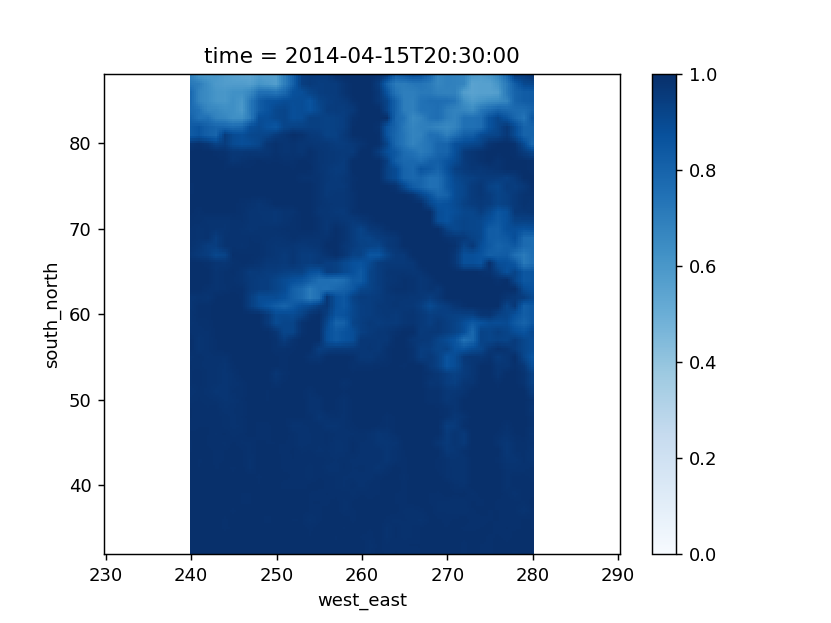

<IPython.core.display.Javascript object>


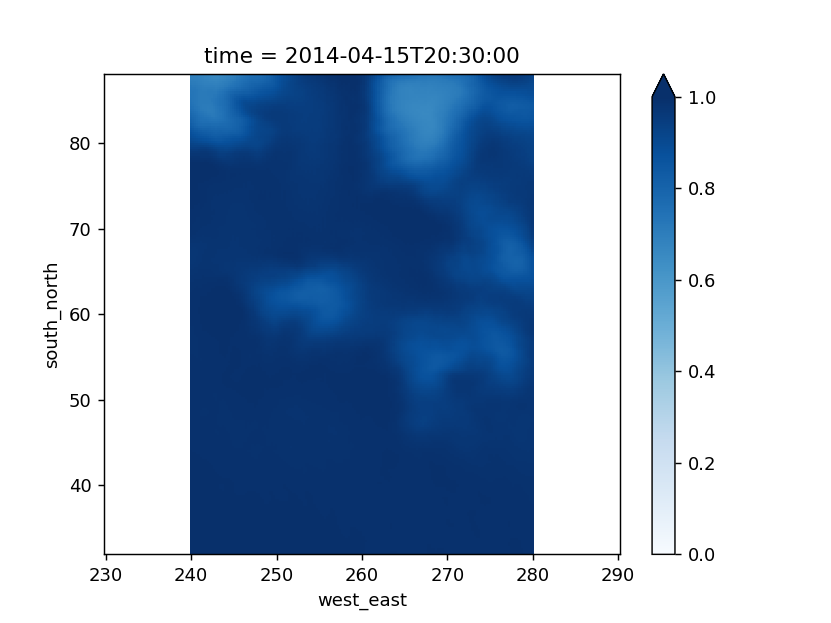

<IPython.core.display.Javascript object>


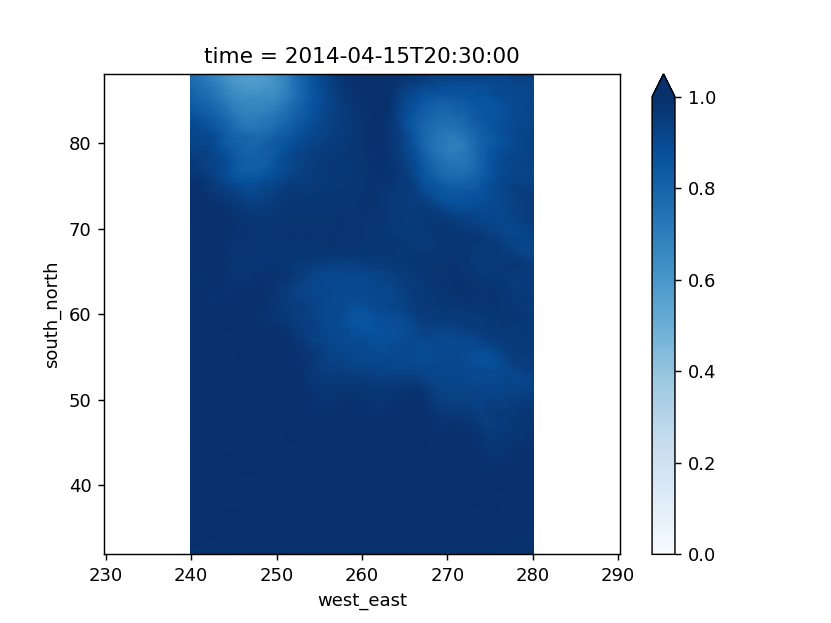

<IPython.core.display.Javascript object>


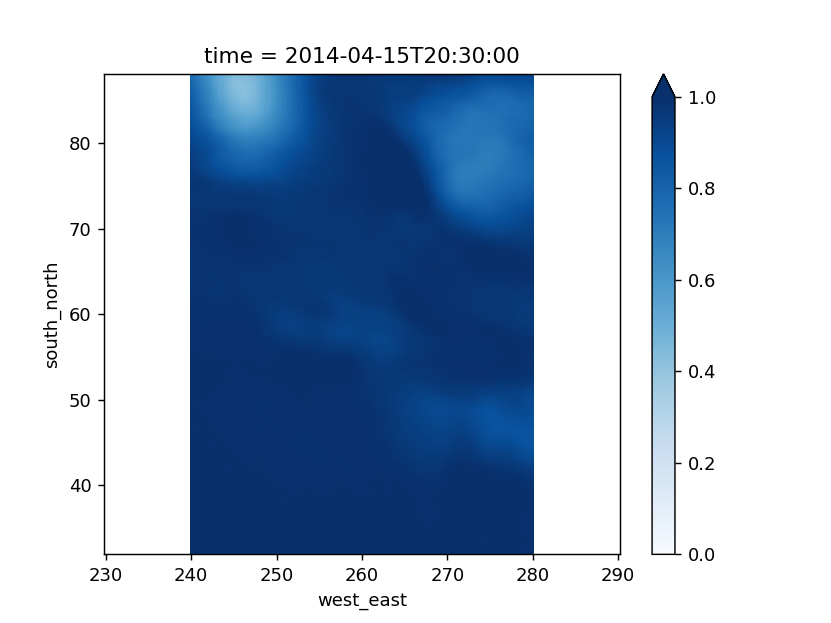

<IPython.core.display.Javascript object>


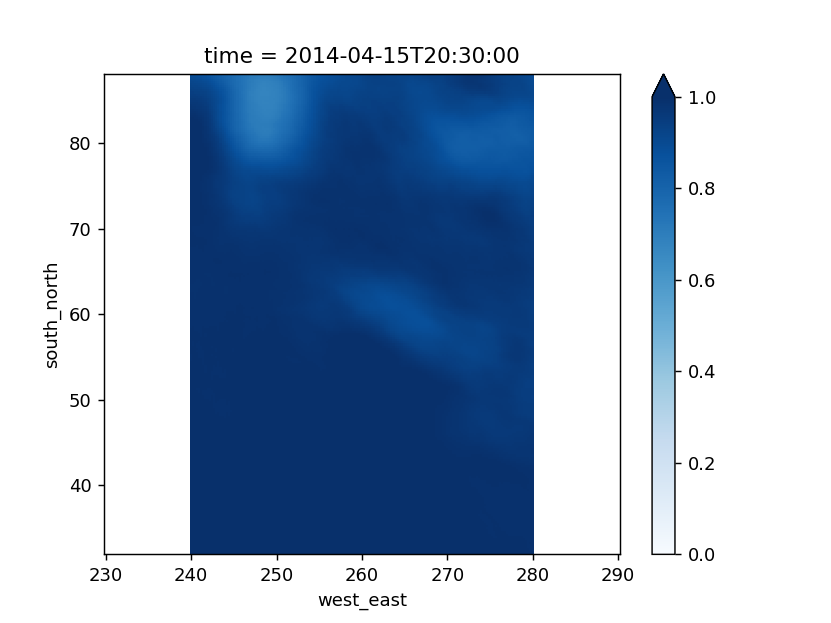

In [115]:
for t in times:
    plt.figure()
    truth_ed.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    analy.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore15.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore30.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore45.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore60.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')

In [116]:
plt.close('all')

<IPython.core.display.Javascript object>


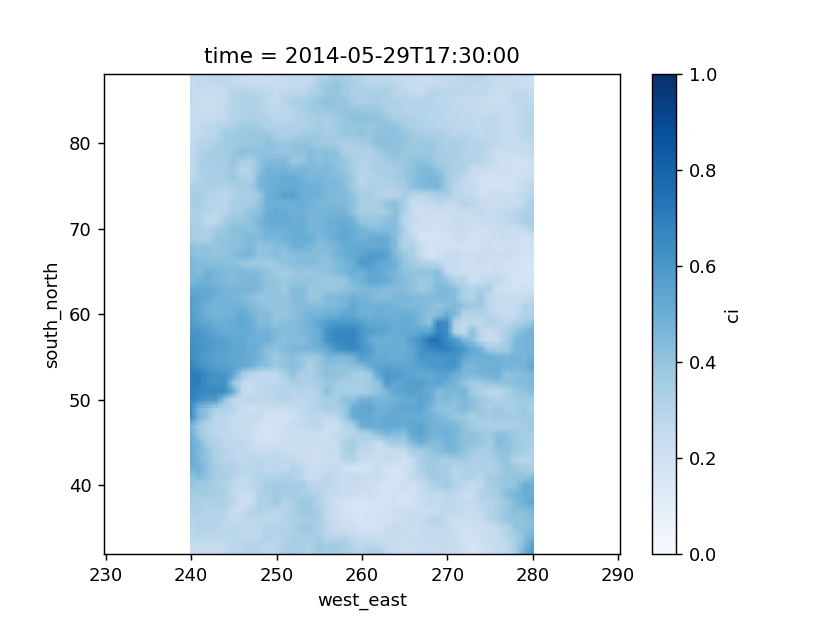

<IPython.core.display.Javascript object>


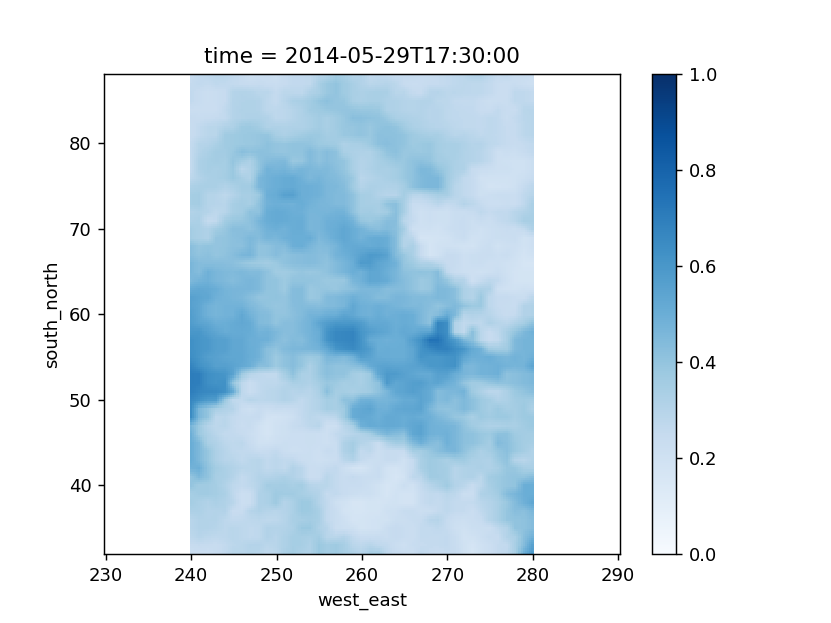

<IPython.core.display.Javascript object>


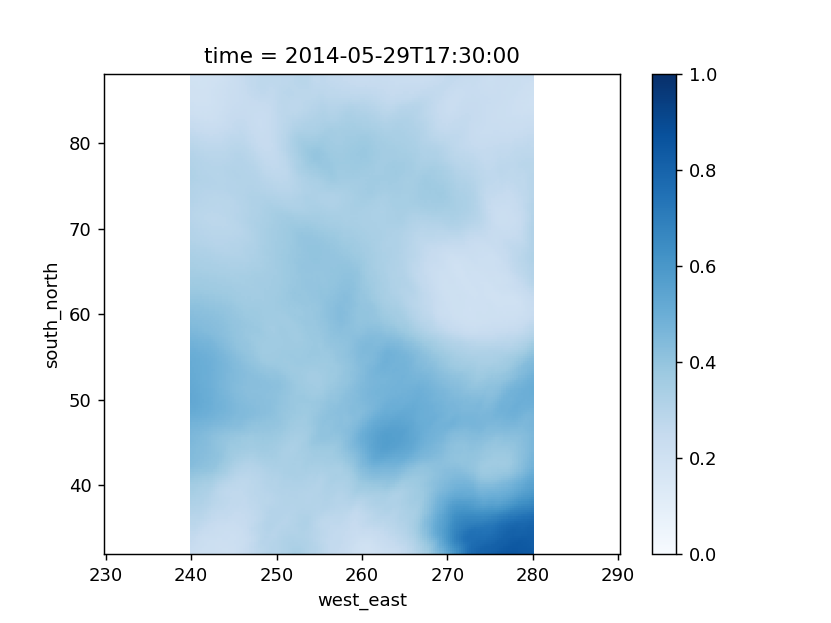

<IPython.core.display.Javascript object>


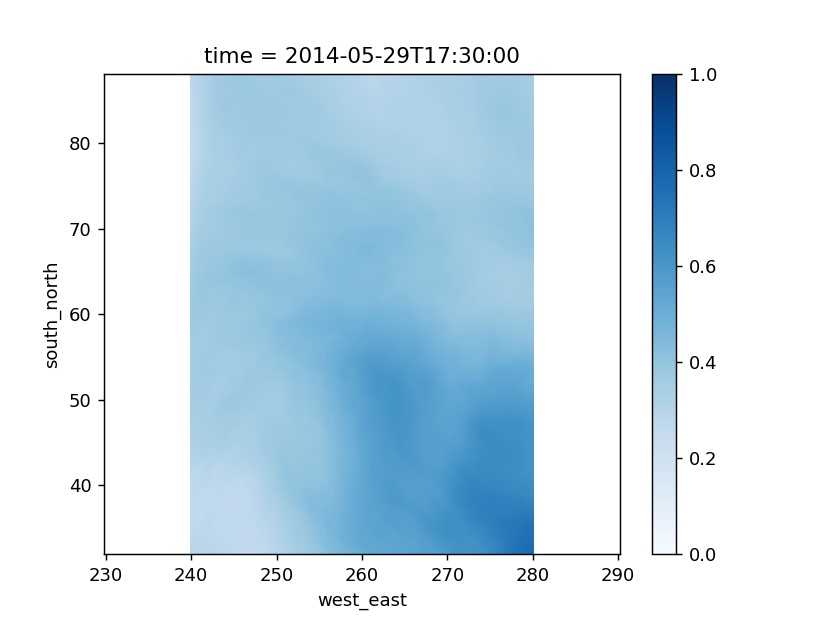

<IPython.core.display.Javascript object>


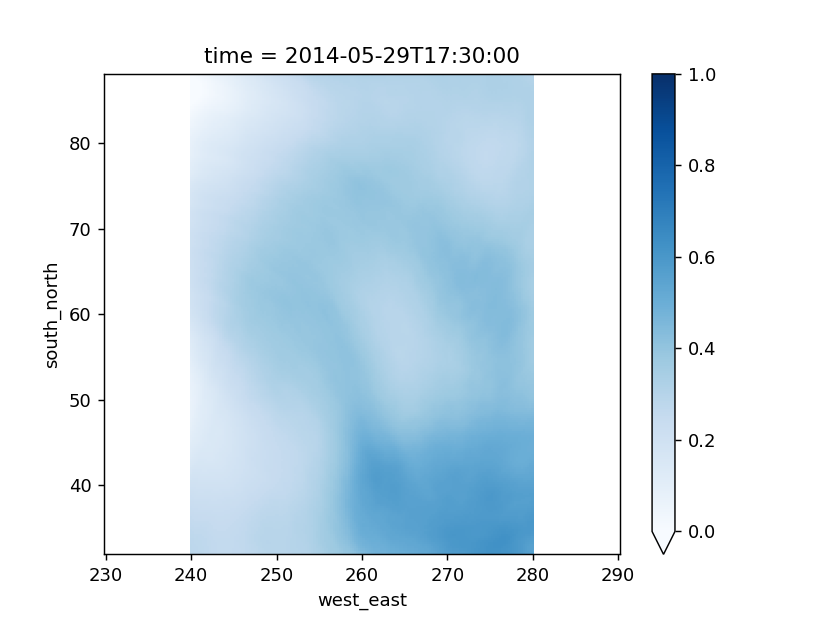

<IPython.core.display.Javascript object>


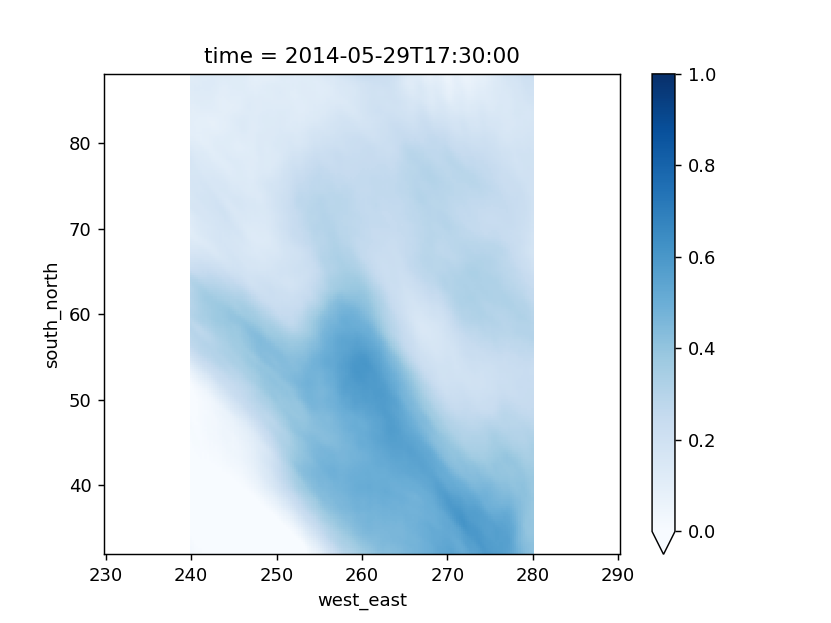

<IPython.core.display.Javascript object>


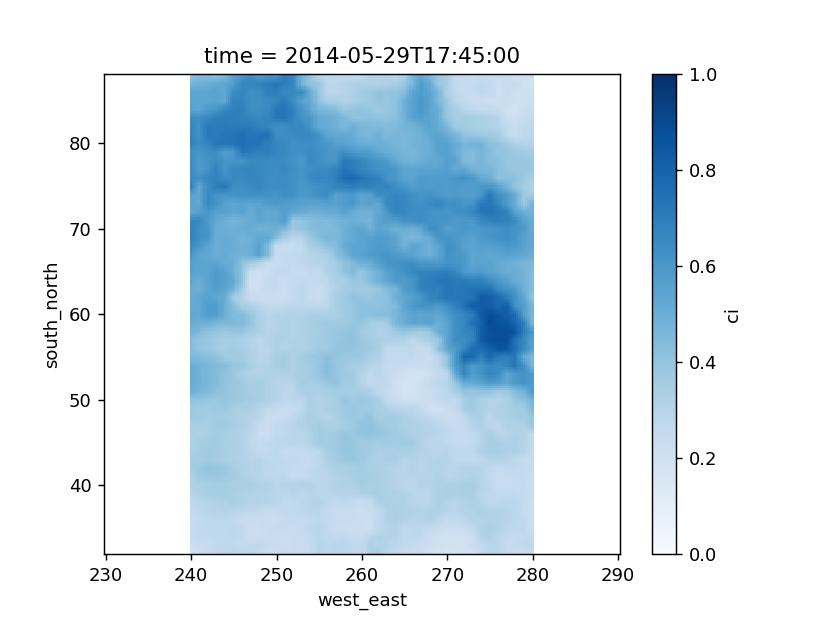

<IPython.core.display.Javascript object>


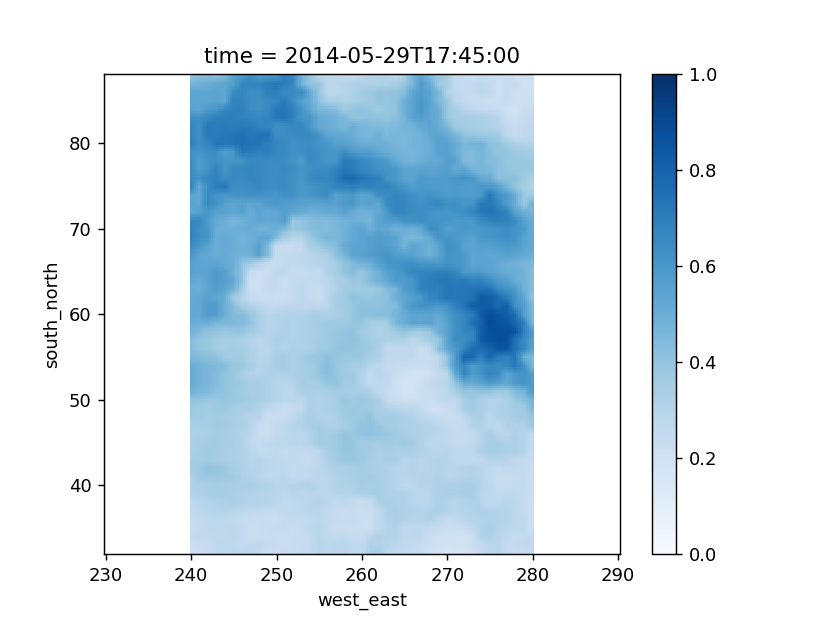

<IPython.core.display.Javascript object>


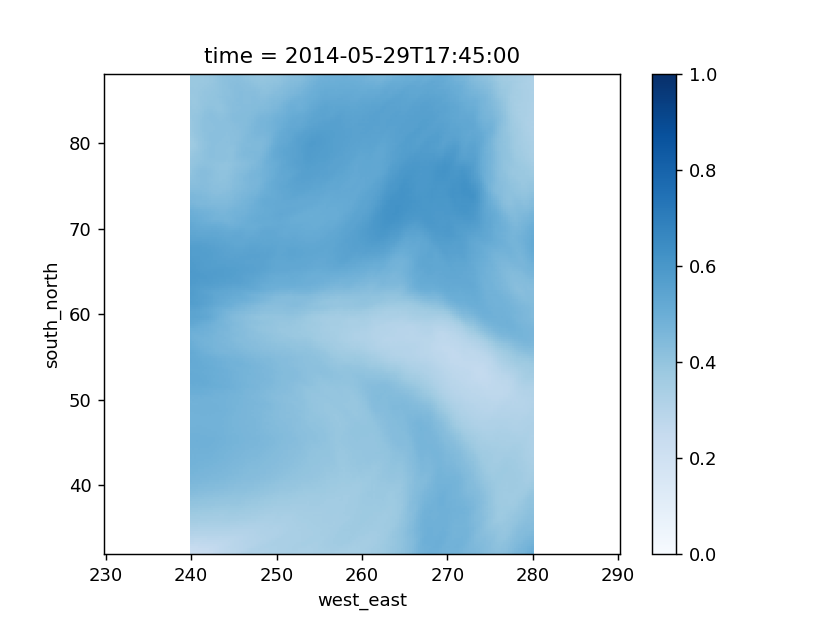

<IPython.core.display.Javascript object>


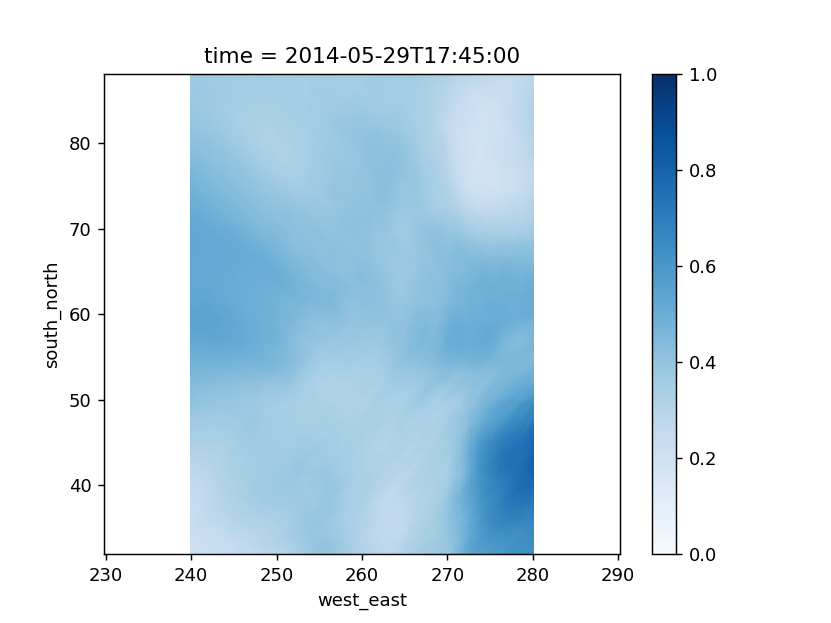

<IPython.core.display.Javascript object>


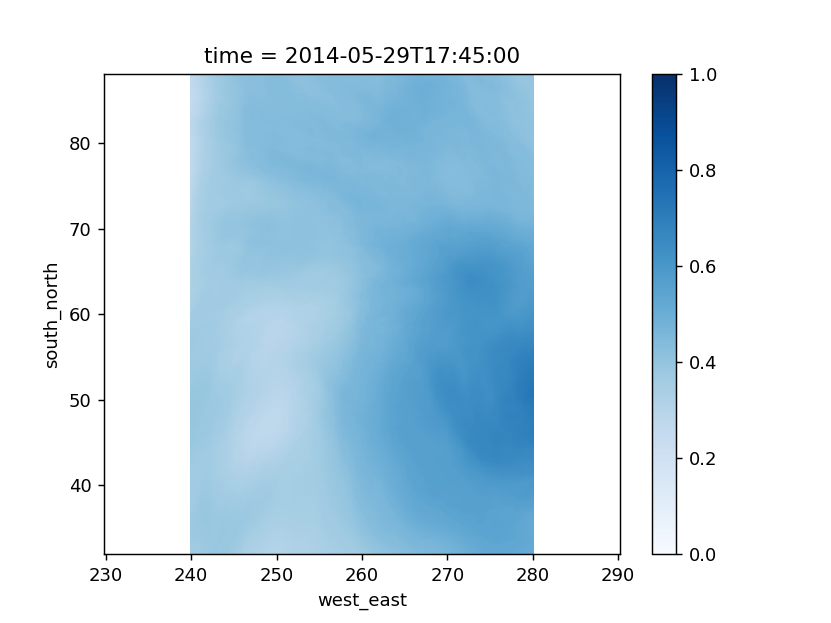

<IPython.core.display.Javascript object>


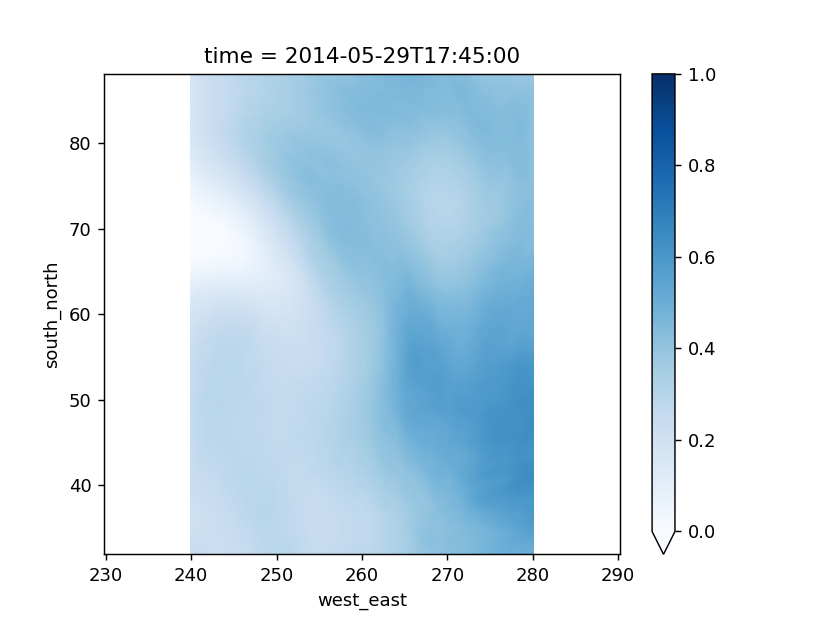

<IPython.core.display.Javascript object>


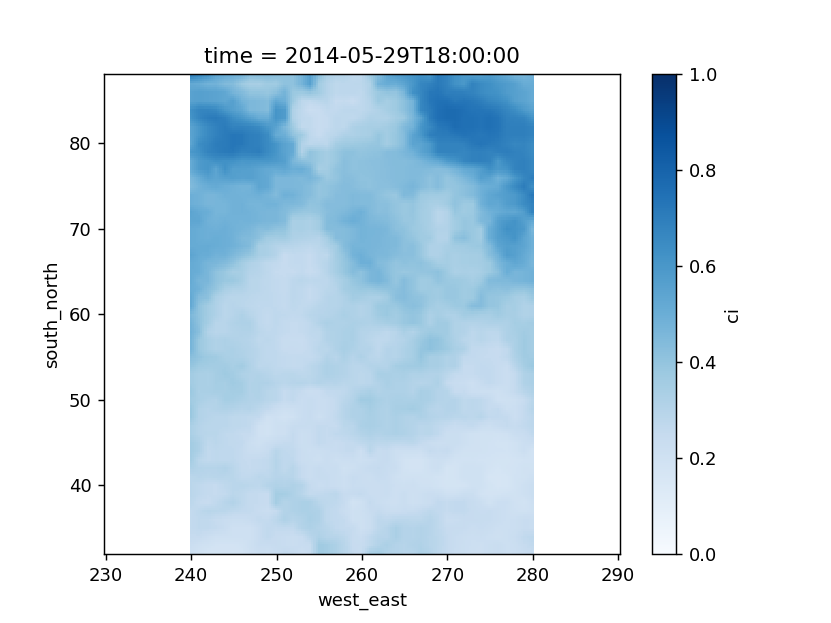

<IPython.core.display.Javascript object>


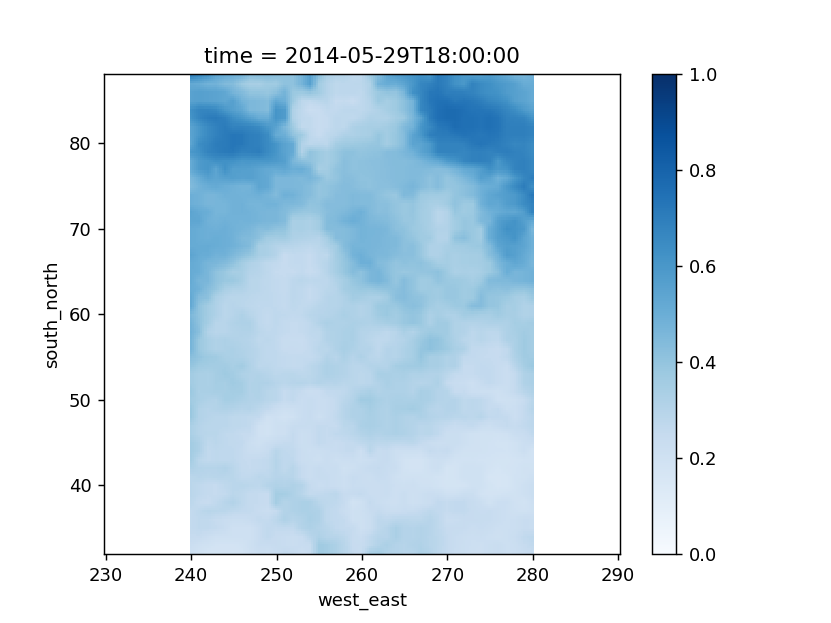

<IPython.core.display.Javascript object>


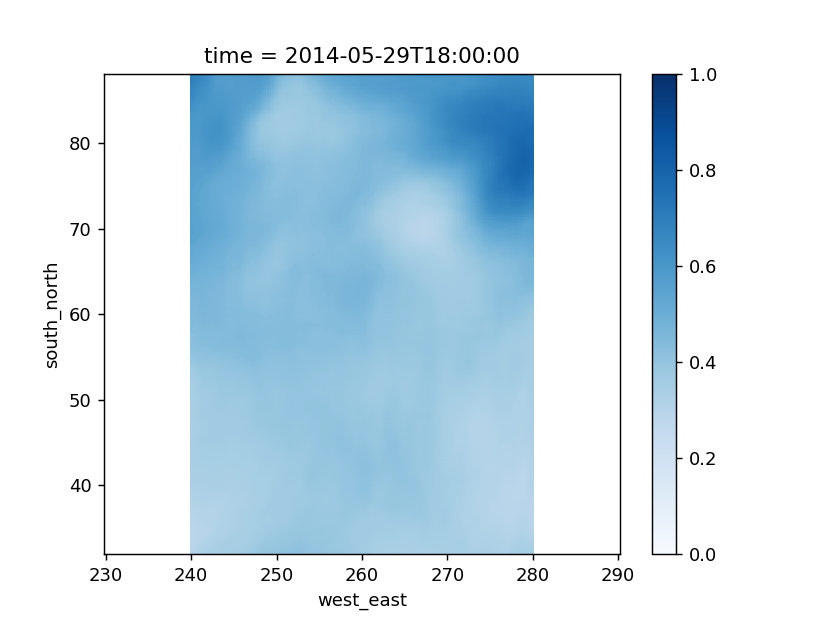

<IPython.core.display.Javascript object>


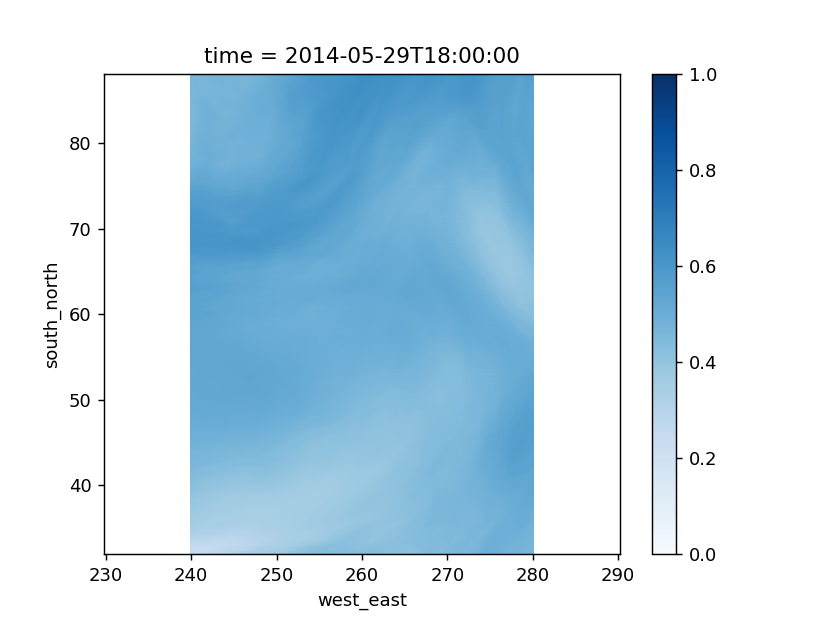

<IPython.core.display.Javascript object>


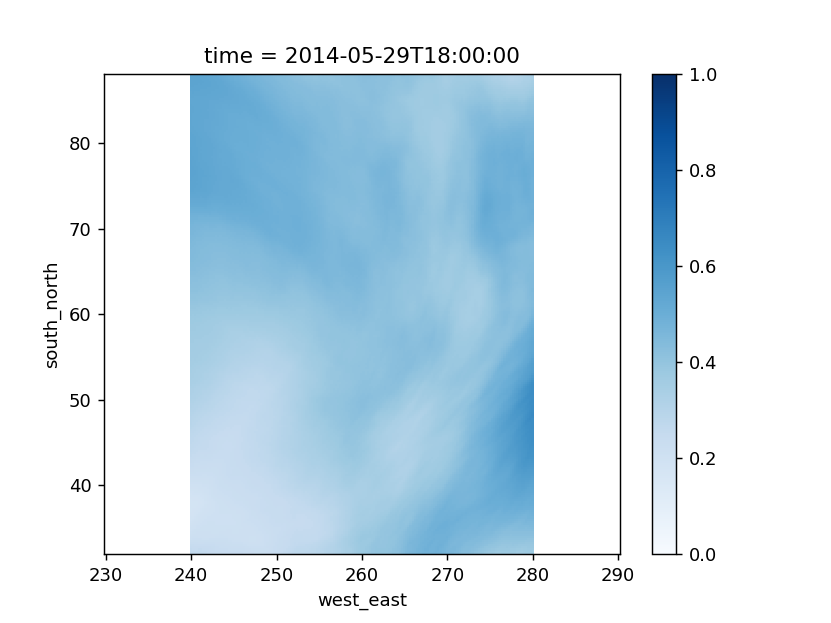

<IPython.core.display.Javascript object>


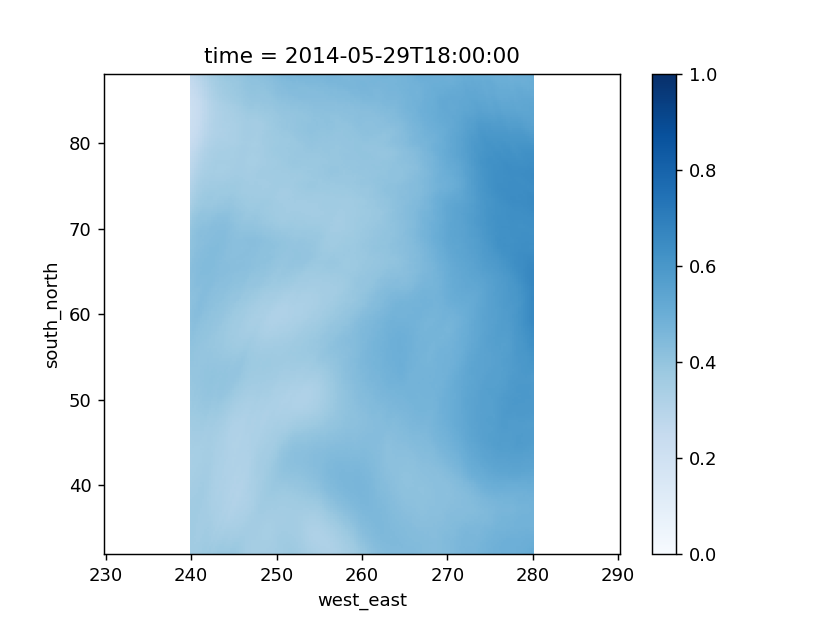

<IPython.core.display.Javascript object>


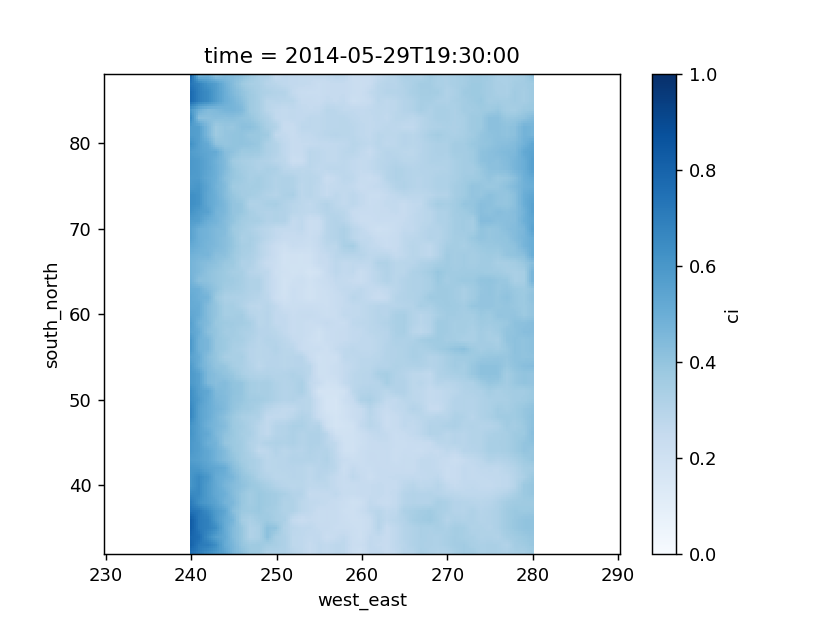

<IPython.core.display.Javascript object>


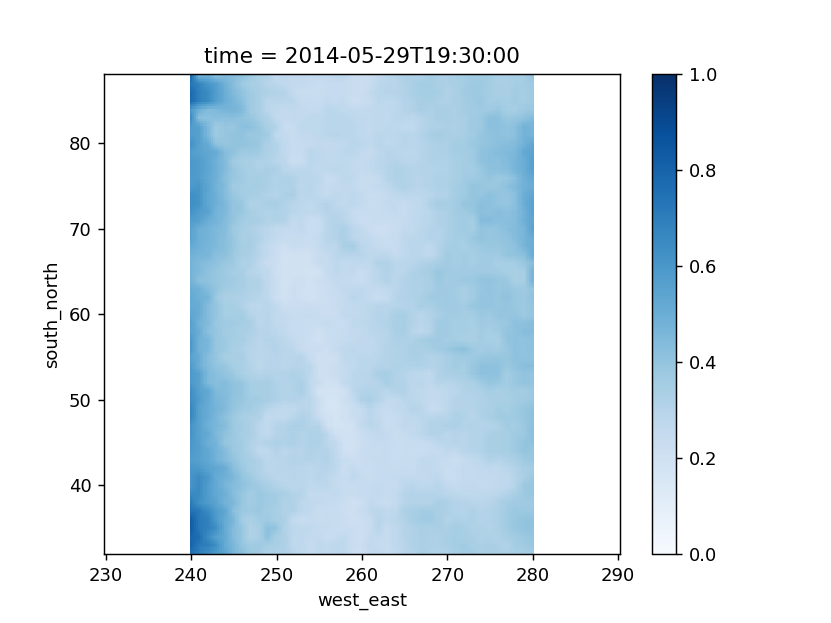

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


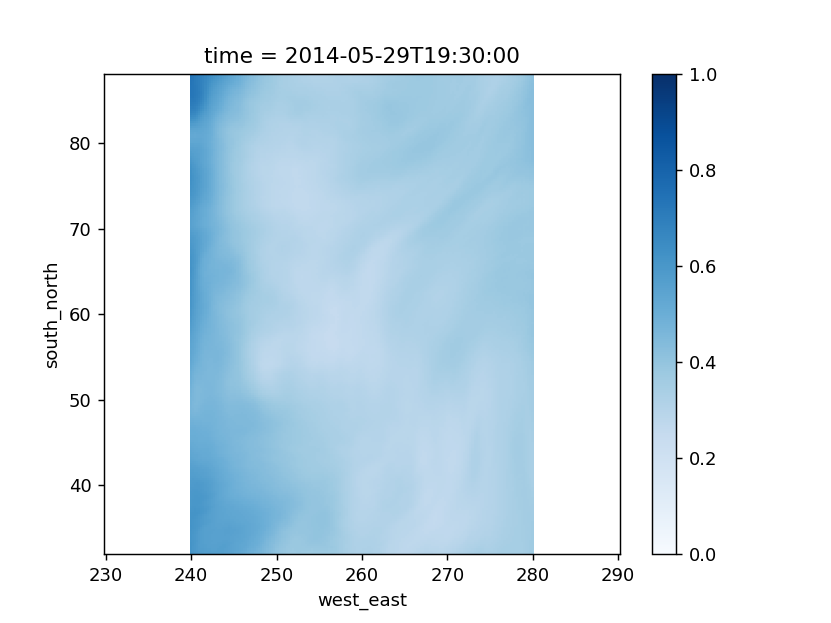

<IPython.core.display.Javascript object>


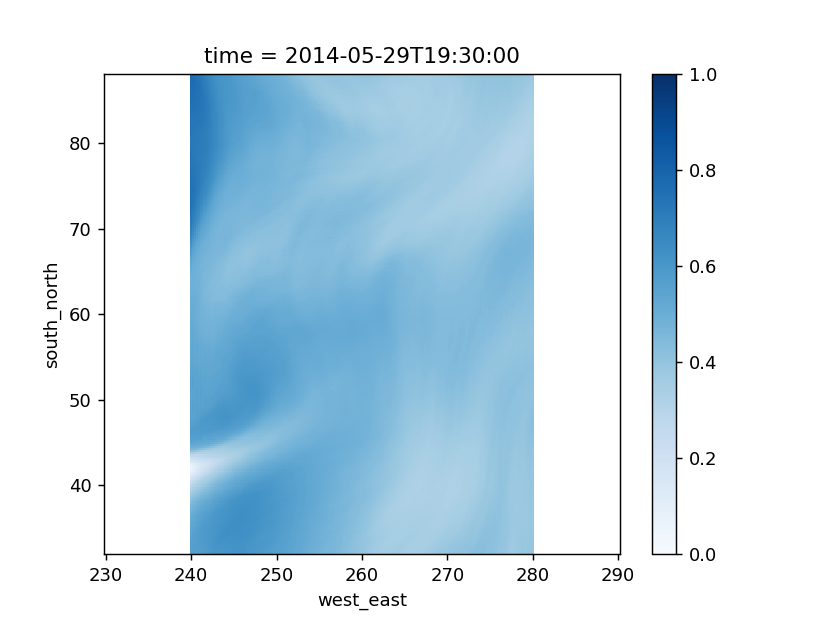

<IPython.core.display.Javascript object>


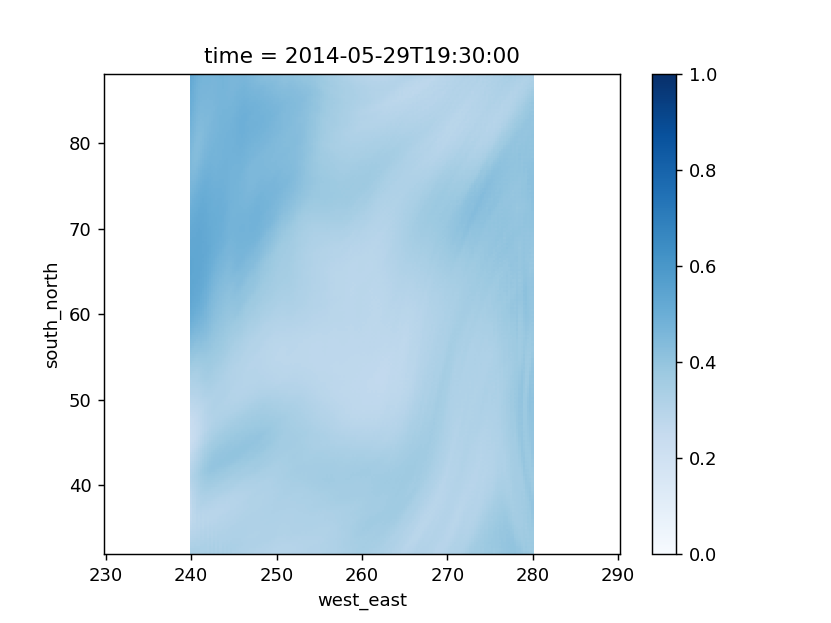

<IPython.core.display.Javascript object>


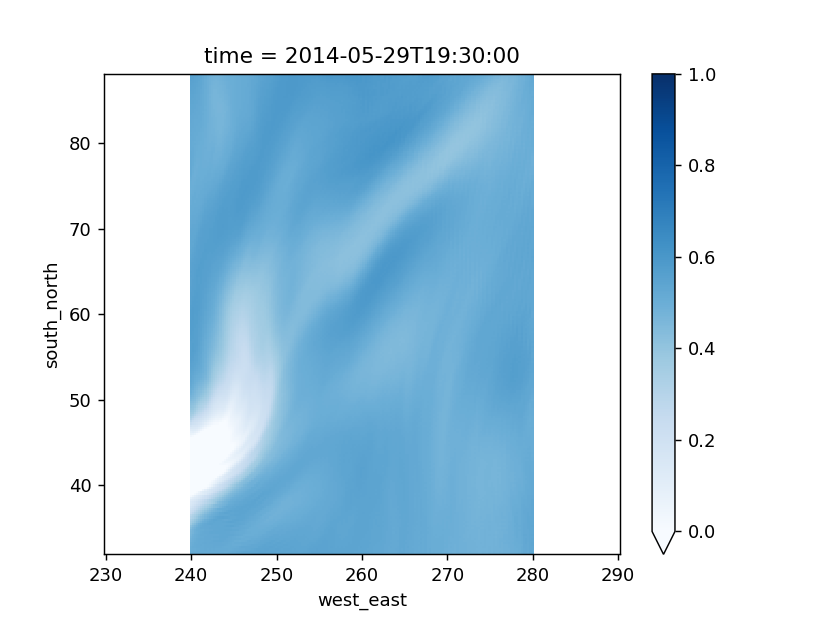

<IPython.core.display.Javascript object>


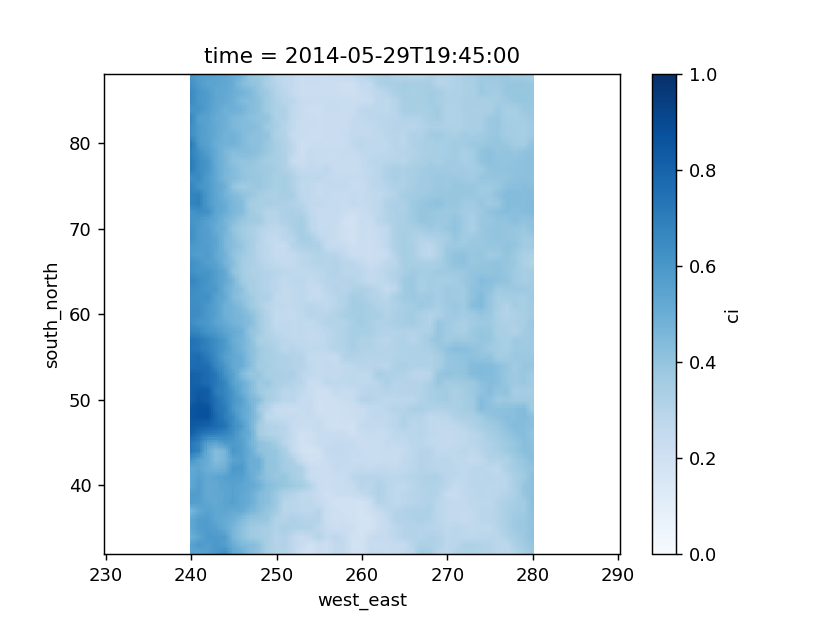

<IPython.core.display.Javascript object>


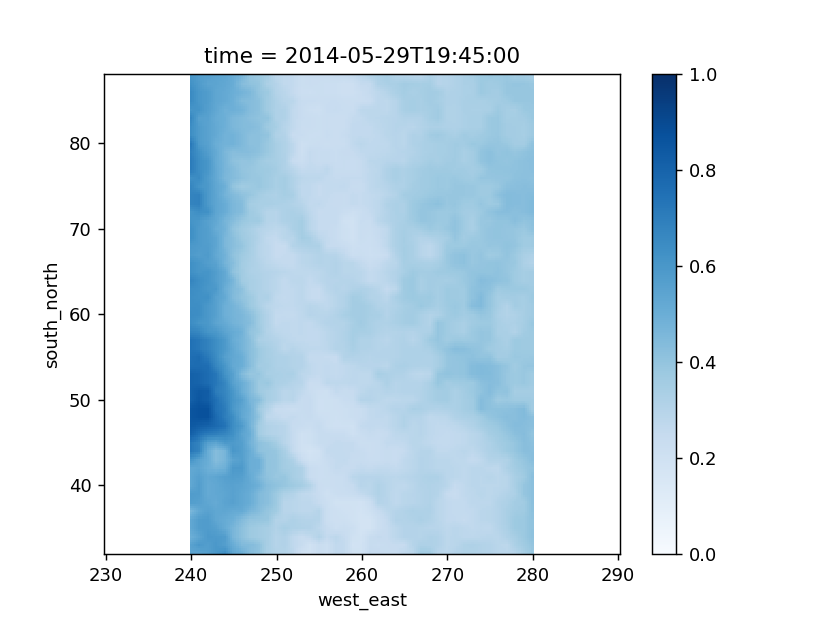

<IPython.core.display.Javascript object>


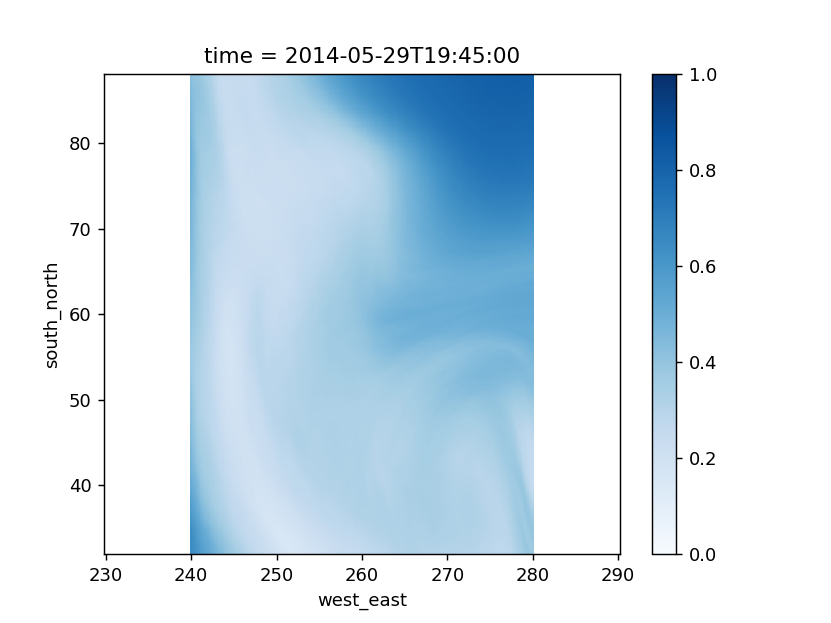

<IPython.core.display.Javascript object>


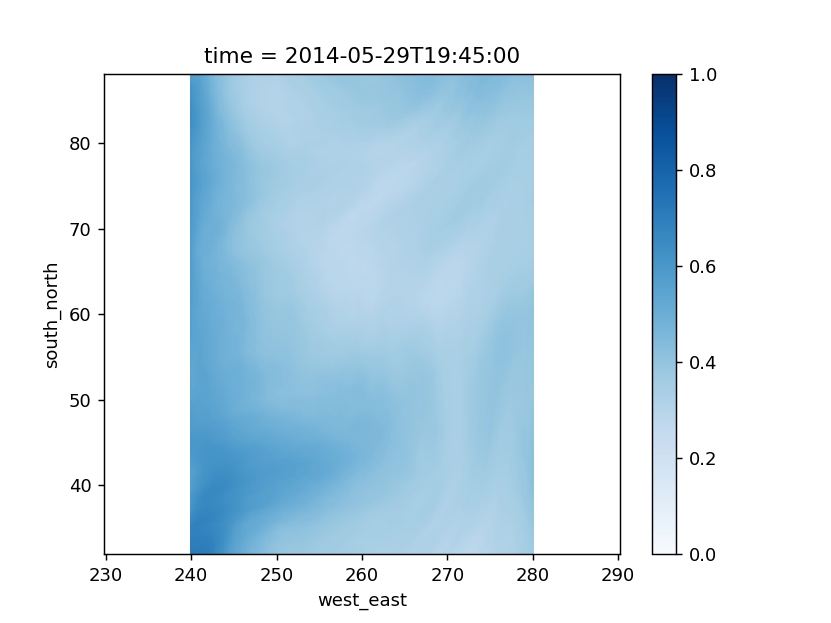

<IPython.core.display.Javascript object>


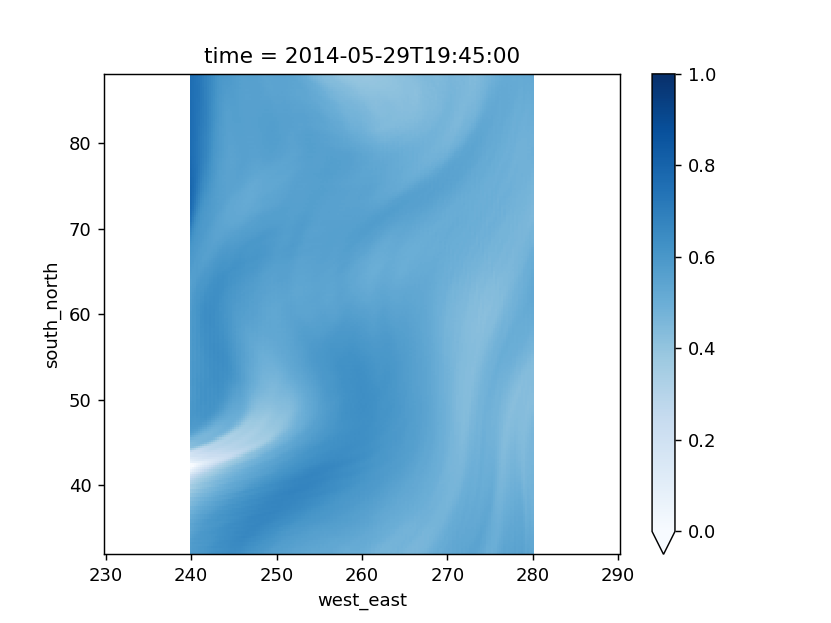

<IPython.core.display.Javascript object>


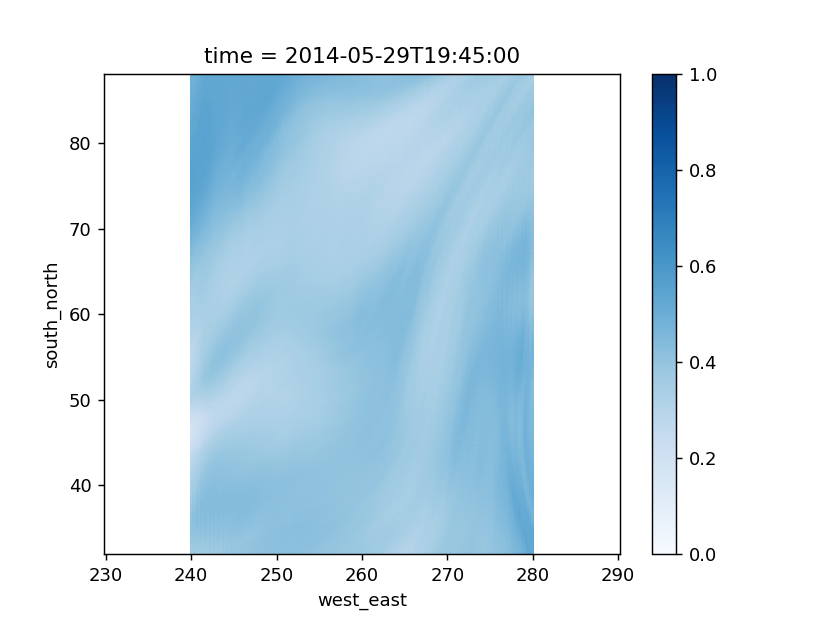

In [15]:
for t in times:
    plt.figure()
    truth_ed.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    analy.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore15.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore30.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore45.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')
    
    plt.figure()
    fore60.sel(time=t).plot(
        cmap='Blues', vmin=0, vmax=1)
    plt.axis('equal')

In [41]:
for t in full_day.time[80:]:
    plt.figure()
    full_day['U'].sel(time=t).mean(dim='ensemble_number').plot(
        cmap='Greys', vmin=0, vmax=1).mean(dim='ensemble_number')
    plt.axis('equal')

<IPython.core.display.Javascript object>

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/dask/core.py:306: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif type_arg is type(key) and arg == key:


AttributeError: Unknown property cmap

In [79]:
first = full_day['U'].isel(time=0).mean(dim='ensemble_number')
fist_var = full_day['U'].isel(time=0).var(dim='ensemble_number')

<IPython.core.display.Javascript object>


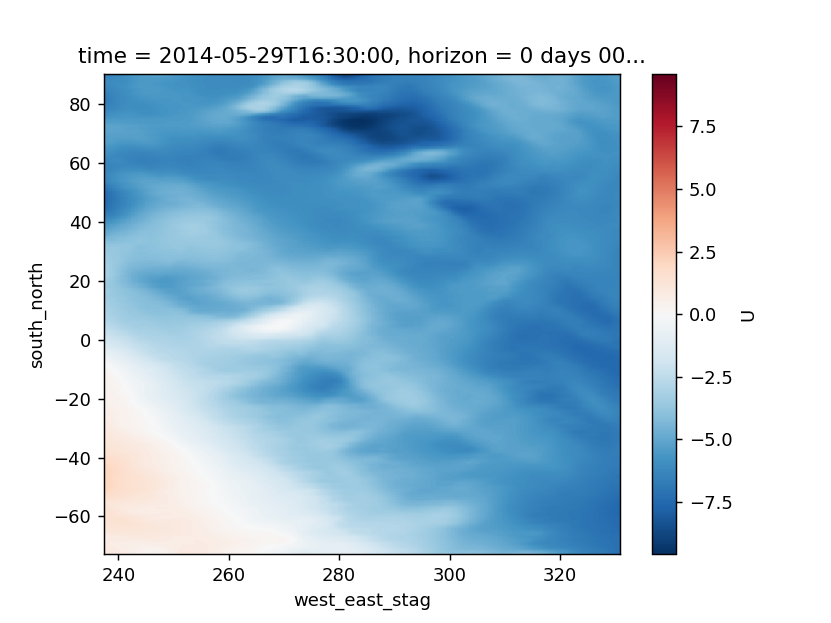

<IPython.core.display.Javascript object>


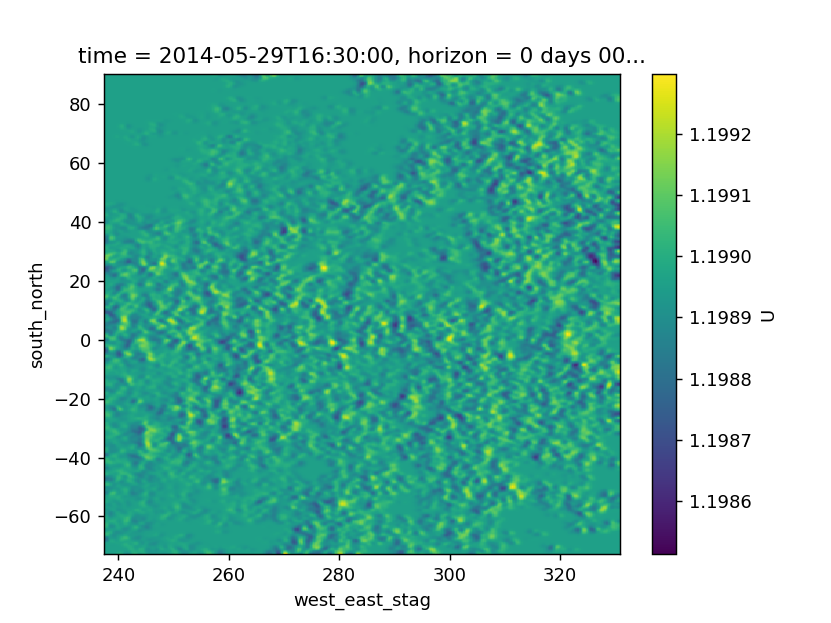

In [80]:
plt.figure()
first.plot()

plt.figure()
fist_var.plot()

<IPython.core.display.Javascript object>


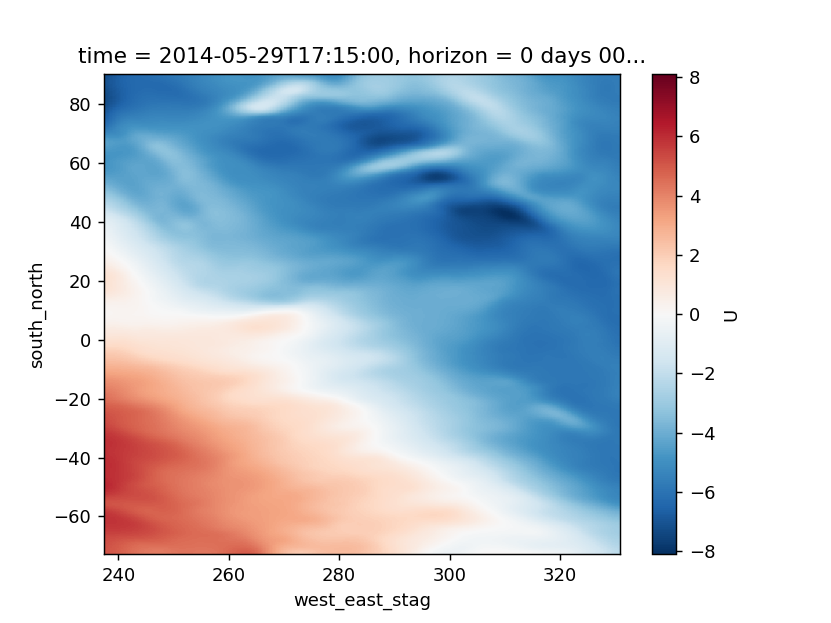

<IPython.core.display.Javascript object>


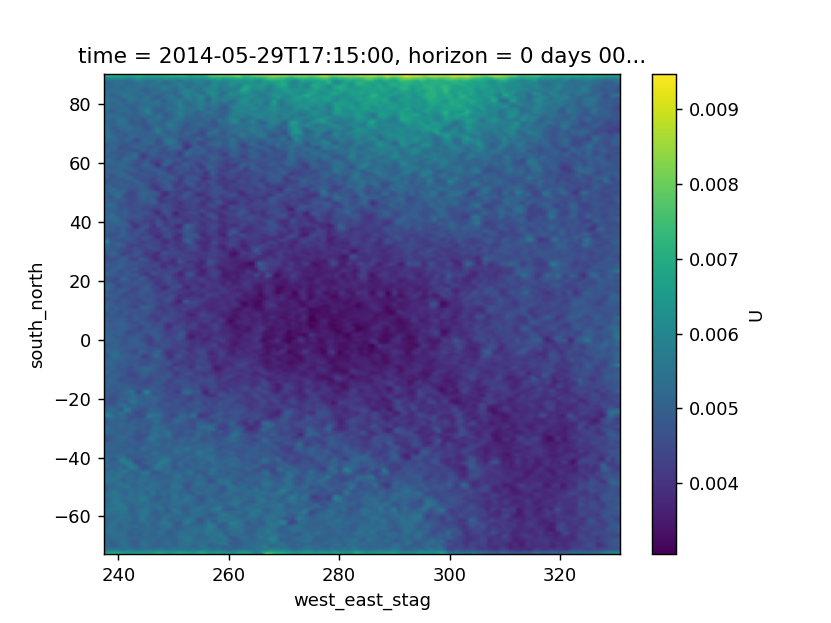

In [78]:
plt.figure()
first.plot()

plt.figure()
fist_var.plot()

In [42]:
last = full_day['U'].isel(time=-1).mean(dim='ensemble_number')

In [47]:
last_var = full_day['U'].isel(time=-1).var(dim='ensemble_number')

In [ ]:
U_var = 

<IPython.core.display.Javascript object>


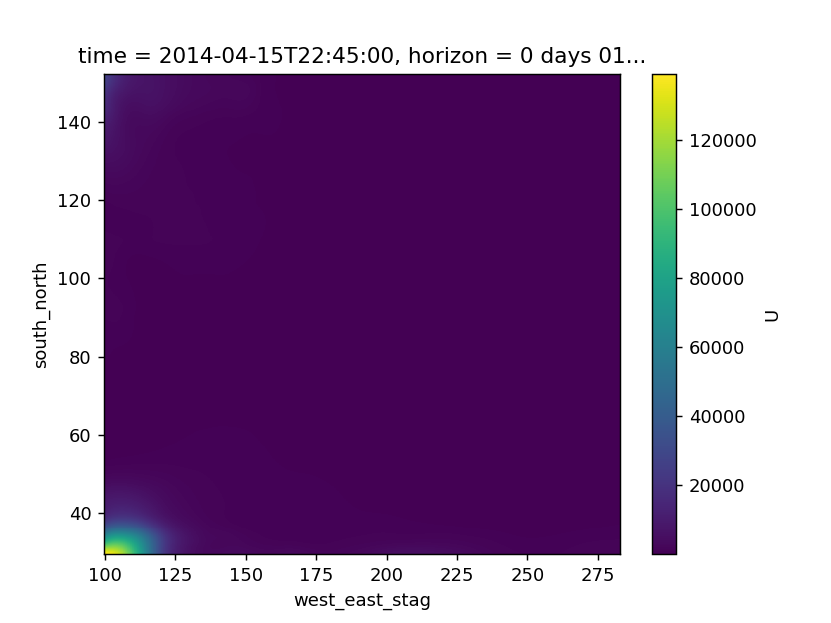

In [48]:
plt.figure()
last_var.plot()

<IPython.core.display.Javascript object>


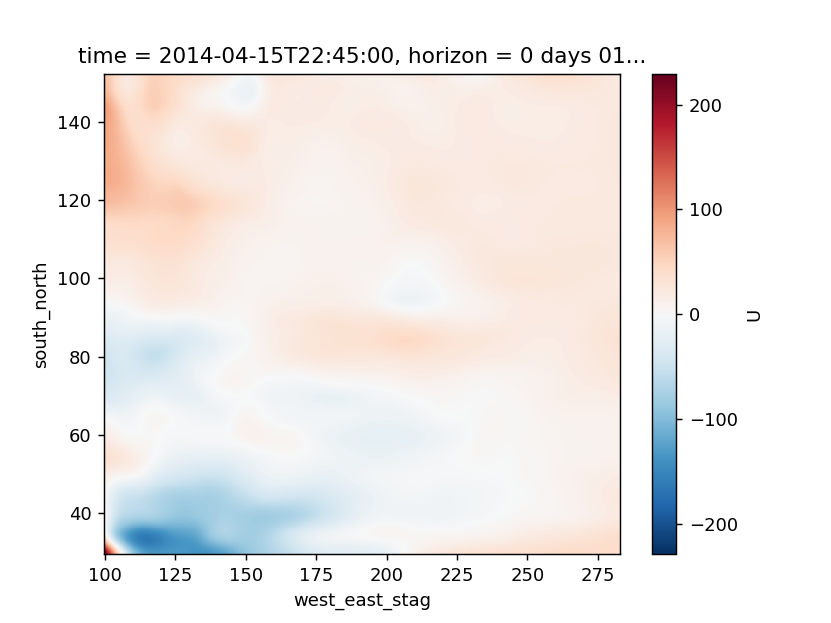

In [46]:
plt.figure()
last.plot()

In [ ]:
f